## Notebook is adapted from https://github.com/kundajelab/tfmodisco

# Loading data

In [77]:
#Data processing related imports
from copy import deepcopy
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import precision_recall_fscore_support
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from torcheval.metrics import BinaryAUROC

#TF-MoDISco related imports
import captum
from captum.attr import DeepLift, InputXGradient, Saliency
from collections import Counter, OrderedDict
import copy
import glob
import h5py
import modisco
from modisco import hit_scoring
import modisco.affinitymat.core
import modisco.aggregator
import modisco.cluster.core
import modisco.cluster.phenograph.cluster
import modisco.cluster.phenograph.core
from modisco.hit_scoring import densityadapted_hitscoring
from modisco.tfmodisco_workflow import workflow
import modisco.util
from modisco.visualization import viz_sequence
import os
import pandas as pd
import pickle
import random
import seaborn as sns

In [78]:
random_seed = 42
torch.manual_seed(random_seed)
torch.cuda.manual_seed(random_seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(random_seed)

### Variables to edit when running analysis

In [79]:
#Change value depending on which binary label to analyze
label = 1

In [80]:
#Change value depending on which B2 family to analyze
all_b2 = True
if all_b2:
    b2_family = ["B2_Mm1a", "B2_Mm1t", "B2_Mm2"]
else:
    # b2_family = "B2_Mm1a"
    # b2_family = "B2_Mm1t"
    b2_family = "B2_Mm2"

### ---------------------------------------------------------------

In [81]:
#Read in data and get arrays from npz files
if all_b2:
    data_array = []
    for b2 in b2_family:
        if label == 1:
            expressed_data = np.load(f'../data/expressed_{b2}.npz')['arr_0']
            data_array.append(expressed_data)
        elif label == 0:
            unexpressed_data = np.load(f'../data/unexpressed_{b2}.npz')['arr_0']
            data_array.append(unexpressed_data)
        else:
            print("Incorrect label value inputted!")
    data_array = np.concatenate(data_array, axis=0)
    b2_family = "all_b2"
else:
    if label == 1:
        expressed_data = np.load(f'../data/expressed_{b2_family}.npz')
        data_array  = expressed_data['arr_0']
    elif label == 0:
        unexpressed_data = np.load(f'../data/unexpressed_{b2_family}.npz')
        data_array = unexpressed_data['arr_0']
    else:
        print("Incorrect label value inputted!")
print(data_array.shape)

(33283, 4, 300)


# Defining Model 

In [82]:
#Check to see if GPU is recognized
torch.multiprocessing.set_sharing_strategy('file_descriptor')
print(torch.cuda.is_available())
print(torch.cuda.current_device())
print(torch.cuda.get_device_name(0))
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

True
0
NVIDIA GeForce RTX 3090 Ti
cuda:0


In [83]:
class DenseLayer(nn.Module):
    def __init__(self, in_channels, growth_rate):
        super(DenseLayer, self).__init__()
        self.bn = nn.BatchNorm1d(in_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv = nn.Conv1d(in_channels, growth_rate, kernel_size=3, padding=1, bias=False)
    def forward(self, x):
        out = self.conv(self.relu(self.bn(x)))
        return torch.cat([x, out], 1)
class DenseBlock(nn.Module):
    def __init__(self, in_channels, growth_rate, num_layers):
        super(DenseBlock, self).__init__()
        layers = []
        for i in range(num_layers):
            layers.append(DenseLayer(in_channels + i * growth_rate, growth_rate))
        self.dense_layers = nn.Sequential(*layers)
    def forward(self, x):
        return self.dense_layers(x)
class SAMBAR_Net(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv1d(in_channels=4, out_channels=128, kernel_size=10, padding="same")
        self.relu1 = nn.ReLU()
        self.bn1 = nn.BatchNorm1d(128)
        self.drop1 = nn.Dropout(0.3)
        self.maxpool1 = nn.MaxPool1d(kernel_size=5, stride=1)
        self.dense_block = DenseBlock(in_channels=128, growth_rate=32, num_layers=3)
        
        self.conv2 = nn.LazyConv1d(out_channels=128, kernel_size=10, padding="same")
        self.relu2 = nn.ReLU()
        self.bn2 = nn.BatchNorm1d(128)
        self.maxpool2 = nn.MaxPool1d(kernel_size=5, stride=1)
        self.drop2 = nn.Dropout(0.3)
        self.dense_block2 = DenseBlock(in_channels=128, growth_rate=32, num_layers=3)
        
        self.conv3 = nn.LazyConv1d(out_channels=128, kernel_size=10, padding="same")
        self.relu3 = nn.ReLU()
        self.bn3 = nn.BatchNorm1d(128)
        self.maxpool3 = nn.MaxPool1d(kernel_size=5, stride=1)
        self.drop3 = nn.Dropout(0.3)
        
        # Fully connected layers
        self.flatten = nn.Flatten()
        self.fc1 = nn.LazyLinear(64)
        self.relu6 = nn.ReLU()
        self.dropout = nn.Dropout(0.5)
        self.fc2 = nn.LazyLinear(1)
    def forward(self, x):
        # Convolutional layer
        x = self.drop1(self.maxpool1(self.relu1(self.bn1(self.conv1(x)))))
        x = self.dense_block(x)
        x = self.drop2(self.maxpool2(self.relu2(self.bn2(self.conv2(x)))))
        x = self.dense_block2(x)
        x = self.drop3(self.maxpool3(self.relu3(self.bn3(self.conv3(x)))))
        # Fully connected layers
        x = self.flatten(x)
        x = self.fc1(x)
        x = self.relu6(x)
        x = self.dropout(x)
        x = self.fc2(x)
        return x

# TF-MoDISco

## Get importance scores from DeepLift

In [84]:
#Read in model
model = SAMBAR_Net()
model.load_state_dict(torch.load("../models/SAMBAR_Net_Model.pt"))
model = model.to(device)
model.eval()
deeplift = DeepLift(model)
input_x_gradient = InputXGradient(model)
saliency = Saliency(model)

/home/sahil/anaconda3/lib/python3.11/site-packages/torch/nn/modules/lazy.py:181: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '


In [85]:
def generate_hypothetical_contributions(model, input_sequence, baseline):
    bases = ['A', 'C', 'G', 'T']
    hypothetical_contributions = torch.zeros_like(input_sequence)
    
    for pos in range(input_sequence.shape[2]):
        for base in bases:
            # Create a modified sequence with the current base at the current position
            modified_sequence = input_sequence.clone()
            modified_sequence[:, :, pos] = 0  # Zero out the current position
            modified_sequence[:, bases.index(base), pos] = 1  # Set the current base
            
            # Compute the contribution for the modified sequence
            contribution = deeplift.attribute(modified_sequence, baselines=baseline)
            hypothetical_contributions[:, bases.index(base), pos] = contribution[:, bases.index(base), pos]
    
    return hypothetical_contributions

/home/sahil/anaconda3/lib/python3.11/site-packages/captum/_utils/gradient.py:57: UserWarning: Input Tensor 0 did not already require gradients, required_grads has been set automatically.
  warnings.warn(


Scores for task 1, seq idx 100
Actual contributions


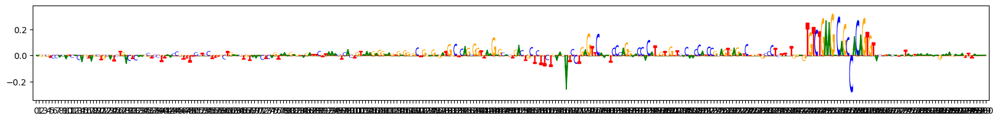

Mean-normalized hypothetical contributions


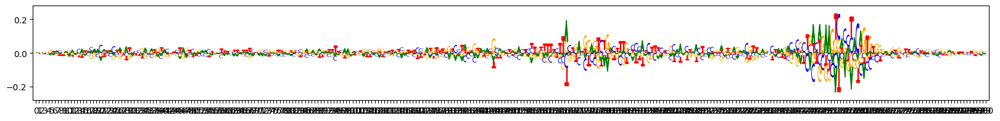

In [86]:
#Create input data
task_to_hyp_contrib_scores = {}
task_to_contrib_scores = {}
attributions_stack = []
hypothetical_contributions_stack = []
#0 - unbound, 1 - bound
targets = [label]
input_data = torch.from_numpy(data_array).to(device).float()

loader = DataLoader(input_data, batch_size=1024, shuffle=True)

# Compute importance scores
baseline = torch.zeros_like(input_data) 
for data in loader:
    attributions = input_x_gradient.attribute(data)
    attributions_stack.append(attributions)
    #Calculate hypothetical contributions
    hypothetical_contributions = saliency.attribute(data)
    hypothetical_contributions_stack.append(hypothetical_contributions)
attributions = torch.cat(attributions_stack, dim=0)
attributions_np = attributions.permute(0,2,1).detach().cpu().numpy()[:, :, :4]
contribution_scores = attributions_np
hypothetical_contributions = torch.cat(hypothetical_contributions_stack, dim=0)
hypothetical_contributions = hypothetical_contributions.permute(0,2,1)[:,:,:4]
#Get mean-normalized values
hypothetical_contributions = hypothetical_contributions - hypothetical_contributions.mean(dim=-1, keepdim=True)
input_data = input_data.permute(0,2,1)[:, :, :4]
task_to_hyp_contrib_scores[label] = hypothetical_contributions.detach().cpu().numpy()
task_to_contrib_scores[label] = contribution_scores
input_data = input_data.detach().cpu().numpy()
del hypothetical_contributions
#Example
seq_idx = 100
print(f"Scores for task {label}, seq idx {seq_idx}")
print("Actual contributions")
viz_sequence.plot_weights(task_to_contrib_scores[label][seq_idx])
print("Mean-normalized hypothetical contributions")
viz_sequence.plot_weights(task_to_hyp_contrib_scores[label][seq_idx])
    

In [87]:
# Check if the file exists and remove it if it does
if os.path.isfile(f"../tf_modisco/data/{b2_family}_scores_trial.h5"):
    os.remove(f"../tf_modisco/data/{b2_family}_scores_trial.h5")

# Create a new HDF5 file
with h5py.File(f"../tf_modisco/data/{b2_family}_scores_trial.h5", "w") as f:
    # Create a group for contribution scores
    g = f.create_group("contrib_scores")
    for task_idx in targets:
        g.create_dataset(f"task{targets[0]}", data=task_to_contrib_scores[task_idx])
    
    # Create a group for hypothetical contribution scores
    g = f.create_group("hyp_contrib_scores")
    for task_idx in targets:
        g.create_dataset(f"task{targets[0]}", data=task_to_hyp_contrib_scores[task_idx])

## Run TF-MoDISco

In [88]:
task_to_scores = OrderedDict()
task_to_hyp_scores = OrderedDict()

f = h5py.File(f"../tf_modisco/data/{b2_family}_scores_trial.h5","r")
tasks = f["contrib_scores"].keys()
for task in tasks:
    #Note that the sequences can be of variable lengths;
    #in this example they all have the same length (200bp) but that is
    #not necessary.
    task_to_scores[task] = [np.array(x) for x in f['contrib_scores'][task][:]]
    task_to_hyp_scores[task] = [np.array(x) for x in f['hyp_contrib_scores'][task][:]]

MEMORY 3.910557696
On task task1
Computing windowed sums on original
Generating null dist
peak(mu)= -0.005341261446475983
Computing threshold
Subsampling!
For increasing = True , the minimum IR precision was 0.24272441170647785 occurring at 1.9073486328125e-06 implying a frac_neg of 0.3205232222703014
To be conservative, adjusted frac neg is 0.95
For increasing = False , the minimum IR precision was 0.14495073198917996 occurring at -3.814697265625e-06 implying a frac_neg of 0.16952325136350588
To be conservative, adjusted frac neg is 0.95
Thresholds from null dist were -1.9142738431692123  and  3.6899906396865845 with frac passing 0.039154
Final raw thresholds are -1.9142738431692123  and  3.6899906396865845
Final transformed thresholds are -0.9297628347375966  and  0.9634476631141595


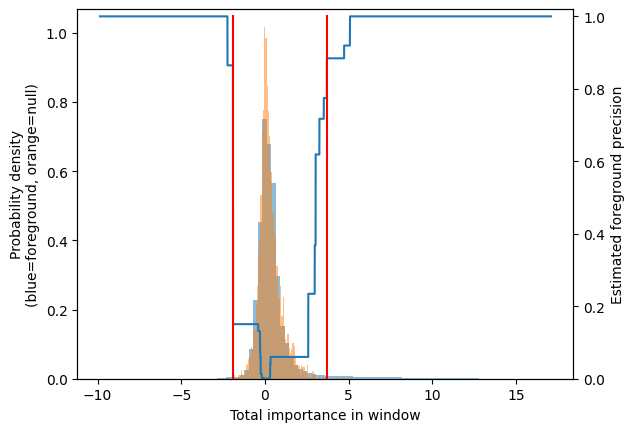

Got 19349 coords
After resolving overlaps, got 19349 seqlets
Across all tasks, the weakest transformed threshold used was: 0.9296628347375966
MEMORY 4.310863872
19349 identified in total
min_metacluster_size_frac * len(seqlets) = 193 is more than min_metacluster_size=100.
Using it as a new min_metacluster_size
2 activity patterns with support >= 193 out of 2 possible patterns
Metacluster sizes:  [16669, 2680]
Idx to activities:  {0: '1', 1: '-1'}
MEMORY 4.310863872
On metacluster 1
Metacluster size 2680
Relevant tasks:  ('task1',)
Relevant signs:  (-1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 2680
(Round 1) Computing coarse affmat
2025-01-23 17:36:23.184309 MEMORY 4.310863872
Beginning embedding computation
MEMORY 4.310863872
At the beginning of embedding call
2025-01-23 17:36:23.185061 MEMORY 4.310863872
before computing embeddings fwd
2025-01-23 17:36:23.193014 MEMORY 4.310863872


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=22)]: Done 268 tasks      | elapsed:    1.8s
[Parallel(n_jobs=22)]: Done 768 tasks      | elapsed:    4.8s
[Parallel(n_jobs=22)]: Done 1468 tasks      | elapsed:    9.0s
[Parallel(n_jobs=22)]: Done 2368 tasks      | elapsed:   14.4s
[Parallel(n_jobs=22)]: Done 2637 out of 2680 | elapsed:   16.2s remaining:    0.3s
[Parallel(n_jobs=22)]: Done 2680 out of 2680 | elapsed:   16.9s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.1s


after computing embeddings fwd
2025-01-23 17:36:40.071508 MEMORY 4.35038208


[Parallel(n_jobs=22)]: Done 268 tasks      | elapsed:    2.0s
[Parallel(n_jobs=22)]: Done 768 tasks      | elapsed:    5.1s
[Parallel(n_jobs=22)]: Done 1468 tasks      | elapsed:    9.4s
[Parallel(n_jobs=22)]: Done 2368 tasks      | elapsed:   15.0s
[Parallel(n_jobs=22)]: Done 2680 out of 2680 | elapsed:   17.1s finished


after computing embeddings rev
2025-01-23 17:36:57.181475 MEMORY 4.43590656
before computing sparse embeddings fwd
2025-01-23 17:36:57.181560 MEMORY 4.43590656
Constructing csr matrix...
csr matrix made in 0.30155134201049805 s
after computing sparse embeddings fwd
2025-01-23 17:36:57.540100 MEMORY 4.43590656
before computing sparse embeddings rev
2025-01-23 17:36:57.540191 MEMORY 4.43590656
Constructing csr matrix...
csr matrix made in 0.2949392795562744 s
after computing sparse embeddings rev
2025-01-23 17:36:57.880631 MEMORY 4.43590656
Finished embedding computation in 34.98 s
MEMORY 4.315676672
Starting affinity matrix computations
MEMORY 4.315676672
Batching in slices of size 2680


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.44s/it]

Finished affinity matrix computations in 3.45 s
MEMORY 4.3158528
(Round 1) Computed coarse affmat
2025-01-23 17:37:01.849464 MEMORY 4.3158528


(Round 1) Computing affinity matrix on nearest neighbors
2025-01-23 17:37:01.851596 MEMORY 4.3158528
Launching nearest neighbors affmat calculation job
MEMORY 4.3158528
Parallel runs completed
MEMORY 4.36107264
Job completed in: 113.86 s
MEMORY 4.36107264
Launching nearest neighbors affmat calculation job
MEMORY 4.36107264
Parallel runs completed
MEMORY 4.361269248
Job completed in: 110.89 s
MEMORY 4.361269248
(Round 1) Computed affinity matrix on nearest neighbors in 225.35 s
2025-01-23 17:40:47.201832 MEMORY 4.361269248
Filtered down to 665 of 2680
(Round 1) Retained 665 rows out of 2680 after filtering
2025-01-23 17:40:49.824919 MEMORY 4.361269248
(Round 1) Computing density adapted affmat
2025-01-23 17:40:50.168463 MEMORY 4.361269248
Symmetrizing nearest neighbors
Computing betas for density adaptation
Computing normalizing denominators
(Round 1) Computing clustering
2025-01-23 17:40:51.378314 MEMORY 4.358197248
Beginning preprocessing + Leiden
2025-01-23 17:40:51.379048 MEMORY 4.3

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.9s


Parallel Leiden runs finished
2025-01-23 17:40:56.395864 MEMORY 4.358197248
Quality: 0.3075204480052601
Got 4 clusters after round 1
Counts:
{1: 187, 2: 150, 0: 188, 3: 140}
2025-01-23 17:40:56.397612 MEMORY 4.358197248
(Round 1) Aggregating seqlets in each cluster
2025-01-23 17:40:56.398130 MEMORY 4.358197248
Aggregating for cluster 0 with 188 seqlets
2025-01-23 17:40:56.398854 MEMORY 4.358197248


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    5.0s finished


Trimming eliminated 0 seqlets out of 188
Skipped 1 seqlets that went over the sequence edge during flank expansion
Aggregating for cluster 1 with 187 seqlets
2025-01-23 17:40:57.045256 MEMORY 4.358197248
Trimming eliminated 0 seqlets out of 187
Skipped 2 seqlets that went over the sequence edge during flank expansion
Skipped 2 seqlets that went over the sequence edge during flank expansion
Dropping cluster 1 with 183 seqlets due to sign disagreement
Aggregating for cluster 2 with 150 seqlets
2025-01-23 17:40:57.617070 MEMORY 4.358197248
Trimming eliminated 0 seqlets out of 150
Aggregating for cluster 3 with 140 seqlets
2025-01-23 17:40:58.013530 MEMORY 4.358197248
Trimming eliminated 0 seqlets out of 140
(Round 2) num seqlets: 477
(Round 2) Computing coarse affmat
2025-01-23 17:40:58.620588 MEMORY 4.358197248
Beginning embedding computation
MEMORY 4.358197248
At the beginning of embedding call
2025-01-23 17:40:58.621587 MEMORY 4.358197248
before computing embeddings fwd
2025-01-23 17:4

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=22)]: Done 268 tasks      | elapsed:    2.0s
[Parallel(n_jobs=22)]: Done 434 out of 477 | elapsed:    3.1s remaining:    0.3s
[Parallel(n_jobs=22)]: Done 477 out of 477 | elapsed:    3.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.1s


after computing embeddings fwd
2025-01-23 17:41:02.213731 MEMORY 4.358197248


[Parallel(n_jobs=22)]: Done 268 tasks      | elapsed:    2.0s
[Parallel(n_jobs=22)]: Done 434 out of 477 | elapsed:    3.1s remaining:    0.3s
[Parallel(n_jobs=22)]: Done 477 out of 477 | elapsed:    3.4s finished


after computing embeddings rev
2025-01-23 17:41:05.637374 MEMORY 4.358197248
before computing sparse embeddings fwd
2025-01-23 17:41:05.637463 MEMORY 4.358197248
Constructing csr matrix...
csr matrix made in 0.04774045944213867 s
after computing sparse embeddings fwd
2025-01-23 17:41:05.694132 MEMORY 4.358197248
before computing sparse embeddings rev
2025-01-23 17:41:05.694248 MEMORY 4.358197248
Constructing csr matrix...
csr matrix made in 0.047003984451293945 s
after computing sparse embeddings rev
2025-01-23 17:41:05.749577 MEMORY 4.358197248
Finished embedding computation in 7.36 s
MEMORY 4.358197248
Starting affinity matrix computations
MEMORY 4.358197248
Batching in slices of size 477


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.26s/it]

Finished affinity matrix computations in 3.26 s
MEMORY 4.358258688


(Round 2) Computed coarse affmat
2025-01-23 17:41:09.481157 MEMORY 4.358258688
(Round 2) Computing affinity matrix on nearest neighbors
2025-01-23 17:41:09.481561 MEMORY 4.358258688
Launching nearest neighbors affmat calculation job
MEMORY 4.358258688
Parallel runs completed
MEMORY 4.36396032
Job completed in: 25.78 s
MEMORY 4.36396032
Launching nearest neighbors affmat calculation job
MEMORY 4.36396032
Parallel runs completed
MEMORY 4.404068352
Job completed in: 24.37 s
MEMORY 4.404068352
(Round 2) Computed affinity matrix on nearest neighbors in 50.48 s
2025-01-23 17:41:59.965358 MEMORY 4.404068352
Not applying filtering for rounds above first round
2025-01-23 17:41:59.966043 MEMORY 4.404068352
(Round 2) Computing density adapted affmat
2025-01-23 17:42:00.271056 MEMORY 4.404068352
Symmetrizing nearest neighbors
Computing betas for density adaptation
Computing normalizing denominators
(Round 2) Computing clustering
2025-01-23 17:42:02.228974 MEMORY 4.404043776
Beginning preprocessing

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    2.2s


Parallel Leiden runs finished
2025-01-23 17:42:08.274541 MEMORY 4.404043776
Quality: 0.04079846055382318
Got 2 clusters after round 2
Counts:
{1: 148, 0: 329}
2025-01-23 17:42:08.276325 MEMORY 4.404043776
(Round 2) Aggregating seqlets in each cluster
2025-01-23 17:42:08.276789 MEMORY 4.404043776
Aggregating for cluster 0 with 329 seqlets
2025-01-23 17:42:08.277424 MEMORY 4.404043776


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    6.0s finished


Trimming eliminated 0 seqlets out of 329
Dropping cluster 0 with 329 seqlets due to sign disagreement
Aggregating for cluster 1 with 148 seqlets
2025-01-23 17:42:09.015672 MEMORY 4.404043776
Trimming eliminated 0 seqlets out of 148
Skipped 2 seqlets that went over the sequence edge during flank expansion
Dropping cluster 1 with 146 seqlets due to sign disagreement
Got 0 clusters
Splitting into subclusters...
2025-01-23 17:42:09.411381 MEMORY 4.404043776
No more surviving patterns - bailing!
On metacluster 0
Metacluster size 16669
Relevant tasks:  ('task1',)
Relevant signs:  (1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 16669
(Round 1) Computing coarse affmat
2025-01-23 17:42:09.839318 MEMORY 4.404043776
Beginning embedding computation
MEMORY 4.404043776
At the beginning of embedding call
2025-01-23 17:42:09.840155 MEMORY 4.404043776
before computing embeddings fwd
2025-01-23 17:42:09.847942 MEMORY 4.404043776


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=22)]: Done 268 tasks      | elapsed:    1.9s
[Parallel(n_jobs=22)]: Done 768 tasks      | elapsed:    4.5s
[Parallel(n_jobs=22)]: Done 1468 tasks      | elapsed:    6.9s
[Parallel(n_jobs=22)]: Done 2368 tasks      | elapsed:    9.5s
[Parallel(n_jobs=22)]: Done 4208 tasks      | elapsed:   13.3s
[Parallel(n_jobs=22)]: Done 6808 tasks      | elapsed:   18.1s
[Parallel(n_jobs=22)]: Done 9808 tasks      | elapsed:   22.6s
[Parallel(n_jobs=22)]: Done 14888 tasks      | elapsed:   28.6s
[Parallel(n_jobs=22)]: Done 16669 out of 16669 | elapsed:   30.5s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s


after computing embeddings fwd
2025-01-23 17:42:40.334705 MEMORY 4.892024832


[Parallel(n_jobs=22)]: Done 500 tasks      | elapsed:    0.8s
[Parallel(n_jobs=22)]: Done 2500 tasks      | elapsed:    3.2s
[Parallel(n_jobs=22)]: Done 5300 tasks      | elapsed:    6.8s
[Parallel(n_jobs=22)]: Done 8900 tasks      | elapsed:   10.7s
[Parallel(n_jobs=22)]: Done 13300 tasks      | elapsed:   15.7s
[Parallel(n_jobs=22)]: Done 16669 out of 16669 | elapsed:   19.3s finished


after computing embeddings rev
2025-01-23 17:42:59.609478 MEMORY 5.531000832
before computing sparse embeddings fwd
2025-01-23 17:42:59.609646 MEMORY 5.531000832
Constructing csr matrix...
csr matrix made in 0.98659348487854 s
after computing sparse embeddings fwd
2025-01-23 17:43:00.824601 MEMORY 5.631574016
before computing sparse embeddings rev
2025-01-23 17:43:00.824652 MEMORY 5.631574016
Constructing csr matrix...
csr matrix made in 1.0321323871612549 s
after computing sparse embeddings rev
2025-01-23 17:43:02.071934 MEMORY 5.731135488
Finished embedding computation in 52.65 s
MEMORY 5.006688256
Starting affinity matrix computations
MEMORY 5.006688256
Batching in slices of size 4025


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:34<00:00,  6.98s/it]

Finished affinity matrix computations in 34.92 s
MEMORY 5.014142976


(Round 1) Computed coarse affmat
2025-01-23 17:43:37.635163 MEMORY 4.81026048
(Round 1) Computing affinity matrix on nearest neighbors
2025-01-23 17:43:37.635444 MEMORY 4.81026048
Launching nearest neighbors affmat calculation job
MEMORY 4.809211904
Parallel runs completed
MEMORY 4.809474048
Job completed in: 51.88 s
MEMORY 4.809474048
Launching nearest neighbors affmat calculation job
MEMORY 4.809474048
Parallel runs completed
MEMORY 4.84564992
Job completed in: 51.82 s
MEMORY 4.84564992
(Round 1) Computed affinity matrix on nearest neighbors in 105.1 s
2025-01-23 17:45:22.733710 MEMORY 4.845666304
Filtered down to 2107 of 16669
(Round 1) Retained 2107 rows out of 16669 after filtering
2025-01-23 17:45:31.863721 MEMORY 4.845666304
(Round 1) Computing density adapted affmat
2025-01-23 17:45:32.256233 MEMORY 4.845666304
Symmetrizing nearest neighbors
Computing betas for density adaptation
Computing normalizing denominators
(Round 1) Computing clustering
2025-01-23 17:45:34.786344 MEMORY

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    3.2s


Parallel Leiden runs finished
2025-01-23 17:45:43.161724 MEMORY 4.832493568
Quality: 0.5835848024099697
Quality: 0.5836113049242699
Got 8 clusters after round 1
Counts:
{0: 693, 1: 451, 3: 223, 5: 165, 4: 222, 2: 270, 6: 82, 7: 1}
2025-01-23 17:45:43.164785 MEMORY 4.832493568
(Round 1) Aggregating seqlets in each cluster
2025-01-23 17:45:43.165135 MEMORY 4.832493568
Aggregating for cluster 0 with 693 seqlets
2025-01-23 17:45:43.165951 MEMORY 4.832493568


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    8.3s finished


Skipped 1 seqlets that went over the sequence edge during flank expansion
Skipped 21 seqlets that went over sequence edge during flank expansion
Trimming eliminated 0 seqlets out of 671
Skipped 48 seqlets that went over the sequence edge during flank expansion
Aggregating for cluster 1 with 451 seqlets
2025-01-23 17:45:44.240093 MEMORY 4.83151872
Skipped 6 seqlets that went over the sequence edge during flank expansion
Skipped 1 seqlets that went over the sequence edge during flank expansion
Skipped 306 seqlets that went over sequence edge during flank expansion
Trimming eliminated 0 seqlets out of 138
Skipped 53 seqlets that went over the sequence edge during flank expansion
Aggregating for cluster 2 with 270 seqlets
2025-01-23 17:45:44.675580 MEMORY 4.83151872
Skipped 1 seqlets that went over the sequence edge during flank expansion
Skipped 4 seqlets that went over sequence edge during flank expansion
Trimming eliminated 0 seqlets out of 265
Skipped 5 seqlets that went over the seque

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=22)]: Done 268 tasks      | elapsed:    1.4s
[Parallel(n_jobs=22)]: Done 768 tasks      | elapsed:    3.2s
[Parallel(n_jobs=22)]: Done 1441 out of 1441 | elapsed:    4.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.1s


after computing embeddings fwd
2025-01-23 17:45:49.985603 MEMORY 4.814237696


[Parallel(n_jobs=22)]: Done 268 tasks      | elapsed:    1.4s
[Parallel(n_jobs=22)]: Done 768 tasks      | elapsed:    3.2s
[Parallel(n_jobs=22)]: Done 1441 out of 1441 | elapsed:    3.9s finished


after computing embeddings rev
2025-01-23 17:45:53.941227 MEMORY 4.813201408
before computing sparse embeddings fwd
2025-01-23 17:45:53.941298 MEMORY 4.813201408
Constructing csr matrix...
csr matrix made in 0.08660459518432617 s
after computing sparse embeddings fwd
2025-01-23 17:45:54.048521 MEMORY 4.813201408
before computing sparse embeddings rev
2025-01-23 17:45:54.048578 MEMORY 4.813201408
Constructing csr matrix...
csr matrix made in 0.08205652236938477 s
after computing sparse embeddings rev
2025-01-23 17:45:54.149377 MEMORY 4.813201408
Finished embedding computation in 8.44 s
MEMORY 4.813201408
Starting affinity matrix computations
MEMORY 4.813201408
Batching in slices of size 1441


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.01s/it]

Finished affinity matrix computations in 1.02 s
MEMORY 4.829650944


(Round 2) Computed coarse affmat
2025-01-23 17:45:55.657210 MEMORY 4.829650944
(Round 2) Computing affinity matrix on nearest neighbors
2025-01-23 17:45:55.657576 MEMORY 4.829650944
Launching nearest neighbors affmat calculation job
MEMORY 4.829650944
Parallel runs completed
MEMORY 4.855996416
Job completed in: 8.01 s
MEMORY 4.855996416
Launching nearest neighbors affmat calculation job
MEMORY 4.855996416
Parallel runs completed
MEMORY 4.856193024
Job completed in: 7.99 s
MEMORY 4.856193024
(Round 2) Computed affinity matrix on nearest neighbors in 16.39 s
2025-01-23 17:46:12.049178 MEMORY 4.856193024
Not applying filtering for rounds above first round
2025-01-23 17:46:12.049680 MEMORY 4.856193024
(Round 2) Computing density adapted affmat
2025-01-23 17:46:12.427486 MEMORY 4.856193024
Symmetrizing nearest neighbors
Computing betas for density adaptation
Computing normalizing denominators
(Round 2) Computing clustering
2025-01-23 17:46:16.963384 MEMORY 4.855283712
Beginning preprocessin

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    3.5s


Parallel Leiden runs finished
2025-01-23 17:46:27.381264 MEMORY 4.855283712
Quality: 0.2922846926111612
Got 3 clusters after round 2
Counts:
{0: 639, 1: 450, 2: 352}
2025-01-23 17:46:27.383357 MEMORY 4.855283712
(Round 2) Aggregating seqlets in each cluster
2025-01-23 17:46:27.383677 MEMORY 4.855283712
Aggregating for cluster 0 with 639 seqlets
2025-01-23 17:46:27.384170 MEMORY 4.855283712


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:   10.4s finished


Trimming eliminated 0 seqlets out of 639
Skipped 2 seqlets that went over the sequence edge during flank expansion
Aggregating for cluster 1 with 450 seqlets
2025-01-23 17:46:28.135693 MEMORY 4.855283712
Skipped 5 seqlets that went over the sequence edge during flank expansion
Skipped 20 seqlets that went over sequence edge during flank expansion
Trimming eliminated 0 seqlets out of 425
Skipped 84 seqlets that went over the sequence edge during flank expansion
Aggregating for cluster 2 with 352 seqlets
2025-01-23 17:46:28.779441 MEMORY 4.855283712
Skipped 1 seqlets that went over sequence edge during flank expansion
Trimming eliminated 0 seqlets out of 351
Skipped 28 seqlets that went over the sequence edge during flank expansion
Got 3 clusters
Splitting into subclusters...
2025-01-23 17:46:29.243830 MEMORY 4.855283712
Inspecting pattern 0 for spurious merging


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done 486 tasks      | elapsed:    0.2s
[Parallel(n_jobs=22)]: Done 637 out of 637 | elapsed:    0.3s finished


[t-SNE] Computed conditional probabilities for sample 637 / 637
[t-SNE] Mean sigma: 0.350675
Beginning preprocessing + Leiden
2025-01-23 17:46:29.828568 MEMORY 4.855283712
Affmat transformed
2025-01-23 17:46:29.834392 MEMORY 4.855283712
sources, targets, weights extracted
2025-01-23 17:46:29.838002 MEMORY 4.855283712
About to launch parallel Leiden runs
2025-01-23 17:46:29.839351 MEMORY 4.855283712


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.4s


Parallel Leiden runs finished
2025-01-23 17:46:33.497668 MEMORY 4.855283712
Quality: 0.6246663754017064
Quality: 0.6250964454987864
Quality: 0.6252381526427375
Got subclusters: Counter({0: 129, 1: 73, 2: 71, 3: 60, 4: 59, 5: 45, 6: 41, 7: 39, 8: 33, 9: 32, 10: 28, 11: 14, 12: 13})
On merging iteration 1


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    3.6s finished


Numbers for each pattern pre-subsample: [129, 73, 71, 60, 59, 45, 41, 39, 33, 32, 28, 14, 13]
Numbers after subsampling: [129, 73, 71, 60, 59, 45, 41, 39, 33, 32, 28, 14, 13]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.7841939926147461 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.5387940406799316 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.579756498336792 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.4083104133605957 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.3450484275817871 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.3270530700683594 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.3243281841278076 s
Computing sims for pattern 7
Computed sims for pattern 7 in 0.31708741188049316 s
Computing sims for pattern 8
Computed sims for pattern 8 in 0.3127706050872803 s
Computing sims for pattern 9
Computed sims for pattern 9 in 0.31188416481018066 s
Computing sims

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done 341 out of 341 | elapsed:    0.1s finished


[t-SNE] Computed conditional probabilities for sample 341 / 341
[t-SNE] Mean sigma: 0.382761
Beginning preprocessing + Leiden
2025-01-23 17:46:42.435094 MEMORY 4.855283712
Affmat transformed
2025-01-23 17:46:42.438497 MEMORY 4.855283712
sources, targets, weights extracted
2025-01-23 17:46:42.440051 MEMORY 4.855283712
About to launch parallel Leiden runs
2025-01-23 17:46:42.441198 MEMORY 4.855283712


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.9s


Parallel Leiden runs finished
2025-01-23 17:46:44.871843 MEMORY 4.855283712
Quality: 0.3642325173000602
Quality: 0.36452147437710397
Quality: 0.3651231474774578
Got subclusters: Counter({0: 104, 1: 62, 2: 57, 3: 55, 4: 26, 5: 21, 6: 14, 7: 2})
On merging iteration 1


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.4s finished


Numbers for each pattern pre-subsample: [104, 62, 57, 55, 26, 21, 14, 2]
Numbers after subsampling: [104, 62, 57, 55, 26, 21, 14, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.3686039447784424 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.21380305290222168 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.19226312637329102 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.2111833095550537 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.17872023582458496 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.17653608322143555 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.17423796653747559 s
Computing sims for pattern 7
Computed sims for pattern 7 in 0.1662740707397461 s
Cluster sizes
[104  62  57  55  26  21  14   2]
Cross-contamination matrix:
[[1.   0.24 0.72 0.62 0.48 0.02 0.41 0.2 ]
 [0.81 1.   0.79 0.82 0.49 0.08 0.72 0.65]
 [0.92 0.38 1.   0.79 0.59 0.02 0.61 0.54]
 [0.81 0.

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done 280 out of 323 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=22)]: Done 323 out of 323 | elapsed:    0.1s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.8s


Parallel Leiden runs finished
2025-01-23 17:46:50.003072 MEMORY 4.855283712
Quality: 0.5541115991946512
Quality: 0.5543010240714462
Got subclusters: Counter({0: 57, 1: 49, 3: 38, 2: 38, 4: 38, 5: 34, 6: 25, 7: 22, 8: 9, 9: 7, 10: 6})
On merging iteration 1


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.2s finished


Numbers for each pattern pre-subsample: [57, 49, 38, 38, 38, 34, 25, 22, 9, 7, 6]
Numbers after subsampling: [57, 49, 38, 38, 38, 34, 25, 22, 9, 7, 6]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.2804296016693115 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.26522350311279297 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.26028871536254883 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.268399715423584 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.25674891471862793 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.25264763832092285 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.24605560302734375 s
Computing sims for pattern 7
Computed sims for pattern 7 in 0.24479126930236816 s
Computing sims for pattern 8
Computed sims for pattern 8 in 0.23688578605651855 s
Computing sims for pattern 9
Computed sims for pattern 9 in 0.2338571548461914 s
Computing sims for pattern 10
Com

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done 310 out of 353 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=22)]: Done 353 out of 353 | elapsed:    0.3s finished
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_base.py:246: EfficiencyWarning: Precomputed sparse input was not sorted by row values. Use the function sklearn.neighbors.sort_graph_by_row_values to sort the input by row values, with warn_when_not_sorted=False to remove this warning.
  warnings.warn(


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 353 samples in 0.004s...
[t-SNE] Computed neighbors for 353 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 353 / 353
[t-SNE] Mean sigma: 0.441518
[t-SNE] Computed conditional probabilities in 0.010s
[t-SNE] Iteration 50: error = 51.2107925, gradient norm = 0.0878027 (50 iterations in 0.098s)
[t-SNE] Iteration 100: error = 51.2385063, gradient norm = 0.0858733 (50 iterations in 0.097s)
[t-SNE] Iteration 150: error = 51.2637444, gradient norm = 0.1084771 (50 iterations in 0.089s)
[t-SNE] Iteration 200: error = 51.0737038, gradient norm = 0.1015964 (50 iterations in 0.083s)
[t-SNE] Iteration 250: error = 51.1241684, gradient norm = 0.0806402 (50 iterations in 0.088s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.124168
[t-SNE] Iteration 300: error = 0.5696698, gradient norm = 0.0068501 (50 iterations in 0.067s)
[t-SNE] Iteration 350: error = 0.5389907, gradient norm = 0.0019194 

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.9s


Parallel Leiden runs finished
2025-01-23 17:47:23.898080 MEMORY 4.04840448
Quality: 0.5079715625744842
Quality: 0.5084327916071669


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    4.4s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 70, 1: 61, 2: 56, 3: 46, 4: 43, 5: 37, 6: 26, 7: 11, 8: 3})
On pattern 1
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 240 samples in 0.002s...


[Parallel(n_jobs=22)]: Done 240 out of 240 | elapsed:    0.2s finished


[t-SNE] Computed neighbors for 240 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 240 / 240
[t-SNE] Mean sigma: 0.628658
[t-SNE] Computed conditional probabilities in 0.007s
[t-SNE] Iteration 50: error = 49.8455124, gradient norm = 0.2354716 (50 iterations in 0.054s)
[t-SNE] Iteration 100: error = 50.5999908, gradient norm = 0.2328983 (50 iterations in 0.060s)
[t-SNE] Iteration 150: error = 48.5119286, gradient norm = 0.2118716 (50 iterations in 0.039s)
[t-SNE] Iteration 200: error = 48.9045296, gradient norm = 0.3985044 (50 iterations in 0.039s)
[t-SNE] Iteration 250: error = 49.8343124, gradient norm = 0.2068957 (50 iterations in 0.038s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.834312
[t-SNE] Iteration 300: error = 0.5080479, gradient norm = 0.0055910 (50 iterations in 0.032s)
[t-SNE] Iteration 350: error = 0.4817569, gradient norm = 0.0040391 (50 iterations in 0.030s)
[t-SNE] Iteration 400: error = 0.4749076, gradient norm = 

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.3s


Parallel Leiden runs finished
2025-01-23 17:47:28.355564 MEMORY 4.025597952
Quality: 0.42979180327807565
Quality: 0.43036296471002555


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    3.3s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  32 out of  75 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  75 out of  75 | elapsed:    0.0s finished


Got subclusters: Counter({0: 57, 1: 44, 2: 43, 3: 26, 4: 25, 5: 17, 6: 11, 7: 9, 8: 8})
On pattern 2
[t-SNE] Computing 74 nearest neighbors...
[t-SNE] Indexed 75 samples in 0.001s...
[t-SNE] Computed neighbors for 75 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 75 / 75
[t-SNE] Mean sigma: 1.138308
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 42.0695839, gradient norm = 0.6805090 (50 iterations in 0.011s)
[t-SNE] Iteration 100: error = 52.3395042, gradient norm = 0.4734231 (50 iterations in 0.011s)
[t-SNE] Iteration 150: error = 48.1531677, gradient norm = 0.6186969 (50 iterations in 0.011s)
[t-SNE] Iteration 200: error = 53.2039604, gradient norm = 0.6214125 (50 iterations in 0.011s)
[t-SNE] Iteration 250: error = 48.2452087, gradient norm = 0.5570500 (50 iterations in 0.011s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.245209
[t-SNE] Iteration 300: error = 0.1190456, gradient norm = 0.004106

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.9s


Parallel Leiden runs finished
2025-01-23 17:47:31.046238 MEMORY 4.025597952
Quality: 0.145730119652309


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.4s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done  73 out of  73 | elapsed:    0.0s finished


Got subclusters: Counter({0: 34, 1: 23, 3: 8, 2: 8, 4: 2})
On pattern 3
[t-SNE] Computing 72 nearest neighbors...
[t-SNE] Indexed 73 samples in 0.001s...
[t-SNE] Computed neighbors for 73 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 73 / 73
[t-SNE] Mean sigma: 0.613078
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 47.3567429, gradient norm = 0.4820784 (50 iterations in 0.010s)
[t-SNE] Iteration 100: error = 43.2710838, gradient norm = 0.6446255 (50 iterations in 0.010s)
[t-SNE] Iteration 150: error = 51.8728790, gradient norm = 0.4641194 (50 iterations in 0.010s)
[t-SNE] Iteration 200: error = 52.3849792, gradient norm = 0.4474986 (50 iterations in 0.010s)
[t-SNE] Iteration 250: error = 44.0986557, gradient norm = 0.4078094 (50 iterations in 0.010s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 44.098656
[t-SNE] Iteration 300: error = 0.0917988, gradient norm = 0.0062372 (50 iterations in 0.009s)
[

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.0s


Parallel Leiden runs finished
2025-01-23 17:47:33.895364 MEMORY 4.025597952
Quality: 0.09998834408961253
Quality: 0.10193028889090074


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done  57 out of  57 | elapsed:    0.0s finished


Got subclusters: Counter({0: 22, 1: 18, 2: 15, 3: 10, 4: 8})
On pattern 4
[t-SNE] Computing 56 nearest neighbors...
[t-SNE] Indexed 57 samples in 0.001s...
[t-SNE] Computed neighbors for 57 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 57 / 57
[t-SNE] Mean sigma: 1.344950
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 41.9276466, gradient norm = 0.3722666 (50 iterations in 0.009s)
[t-SNE] Iteration 100: error = 39.1757698, gradient norm = 0.7265004 (50 iterations in 0.009s)
[t-SNE] Iteration 150: error = 38.0047989, gradient norm = 0.7332672 (50 iterations in 0.010s)
[t-SNE] Iteration 200: error = 43.3697243, gradient norm = 0.6217457 (50 iterations in 0.009s)
[t-SNE] Iteration 250: error = 39.3231277, gradient norm = 0.6757131 (50 iterations in 0.009s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 39.323128
[t-SNE] Iteration 300: error = 0.0347314, gradient norm = 0.0028905 (50 iterations in 0.009s)

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.9s


Parallel Leiden runs finished
2025-01-23 17:47:36.600040 MEMORY 4.025597952
Quality: 0.0746071441504074
Got subclusters: Counter({0: 22, 1: 21, 2: 14})
On pattern 5
[t-SNE] Computing 44 nearest neighbors...
[t-SNE] Indexed 45 samples in 0.000s...
[t-SNE] Computed neighbors for 45 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 45 / 45
[t-SNE] Mean sigma: 12.231533
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 38.6944923, gradient norm = 0.6338543 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 37.7510567, gradient norm = 0.6419325 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 39.6740341, gradient norm = 0.5231471 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 36.8225479, gradient norm = 0.6878790 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 38.3359680, gradient norm = 0.6797779 (50 iterations in 0.006s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 38.335968
[

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.5s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  45 out of  45 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.0s


Parallel Leiden runs finished
2025-01-23 17:47:39.217350 MEMORY 4.025597952
Quality: -1.6509016376176883e-13
Got subclusters: Counter({0: 45})
On pattern 6
[t-SNE] Computing 40 nearest neighbors...
[t-SNE] Indexed 41 samples in 0.000s...
[t-SNE] Computed neighbors for 41 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 41 / 41
[t-SNE] Mean sigma: 11.600177
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 36.9915390, gradient norm = 0.7376193 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 40.0617676, gradient norm = 0.4134471 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 38.8126869, gradient norm = 0.7999907 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 39.4890556, gradient norm = 0.5166897 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 39.6465683, gradient norm = 0.4979196 (50 iterations in 0.006s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 39.646568
[t-SNE] It

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.4s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  41 out of  41 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.8s


Parallel Leiden runs finished
2025-01-23 17:47:41.706398 MEMORY 4.025597952
Quality: 1.8185453143360052e-13
Got subclusters: Counter({0: 41})
On pattern 7
[t-SNE] Computing 44 nearest neighbors...
[t-SNE] Indexed 45 samples in 0.000s...
[t-SNE] Computed neighbors for 45 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 45 / 45
[t-SNE] Mean sigma: 31.650263
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 38.9009781, gradient norm = 0.7199634 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 39.1266556, gradient norm = 0.5992803 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 39.2711296, gradient norm = 0.4305692 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 38.9748726, gradient norm = 0.5455133 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 36.0131111, gradient norm = 0.6947545 (50 iterations in 0.006s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 36.013111
[t-SNE] Ite

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.4s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  45 out of  45 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.8s


Parallel Leiden runs finished
2025-01-23 17:47:44.246443 MEMORY 4.025597952
Quality: -1.6509016376176883e-13
Got subclusters: Counter({0: 45})
On pattern 8
[t-SNE] Computing 40 nearest neighbors...
[t-SNE] Indexed 41 samples in 0.000s...
[t-SNE] Computed neighbors for 41 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 41 / 41
[t-SNE] Mean sigma: 19.716509
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 43.1132317, gradient norm = 0.4657218 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 39.4407692, gradient norm = 0.5892510 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 37.9981194, gradient norm = 0.7211804 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 38.3798866, gradient norm = 0.5560775 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 40.4149055, gradient norm = 0.4772075 (50 iterations in 0.006s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 40.414906
[t-SNE] It

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.4s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  41 out of  41 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.7s


Parallel Leiden runs finished
2025-01-23 17:47:46.391537 MEMORY 4.025597952
Quality: 1.8185453143360052e-13
Got subclusters: Counter({0: 41})
On pattern 9
[t-SNE] Computing 38 nearest neighbors...
[t-SNE] Indexed 39 samples in 0.000s...
[t-SNE] Computed neighbors for 39 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 39 / 39
[t-SNE] Mean sigma: 11.313708
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 37.3721924, gradient norm = 0.8406714 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 38.4786415, gradient norm = 0.5625486 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 40.1362190, gradient norm = 0.6133146 (50 iterations in 0.004s)
[t-SNE] Iteration 200: error = 38.4413948, gradient norm = 0.6138790 (50 iterations in 0.003s)
[t-SNE] Iteration 250: error = 41.1332169, gradient norm = 0.3829958 (50 iterations in 0.003s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 41.133217
[t-SNE] Ite

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  36 out of  39 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  39 out of  39 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.7s


Parallel Leiden runs finished
2025-01-23 17:47:48.295346 MEMORY 4.025597952
Quality: 4.0412118096357004e-14
Got subclusters: Counter({0: 39})
On pattern 10
[t-SNE] Computing 36 nearest neighbors...
[t-SNE] Indexed 37 samples in 0.000s...
[t-SNE] Computed neighbors for 37 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 37 / 37
[t-SNE] Mean sigma: 23.348471
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 40.7656288, gradient norm = 0.4263737 (50 iterations in 0.003s)
[t-SNE] Iteration 100: error = 40.0894203, gradient norm = 0.7479258 (50 iterations in 0.003s)
[t-SNE] Iteration 150: error = 43.1136475, gradient norm = 0.4786734 (50 iterations in 0.003s)
[t-SNE] Iteration 200: error = 38.4137650, gradient norm = 0.4382373 (50 iterations in 0.003s)
[t-SNE] Iteration 250: error = 40.3505554, gradient norm = 0.3968305 (50 iterations in 0.003s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 40.350555
[t-SNE] It

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.8s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  32 out of  37 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  37 out of  37 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:47:50.096532 MEMORY 4.025597952
Quality: 3.463895836830574e-14
Got subclusters: Counter({0: 37})
On pattern 11
[t-SNE] Computing 27 nearest neighbors...
[t-SNE] Indexed 28 samples in 0.025s...
[t-SNE] Computed neighbors for 28 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 28 / 28
[t-SNE] Mean sigma: 11.973304
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 40.3995552, gradient norm = 0.4298186 (50 iterations in 0.005s)
[t-SNE] Iteration 100: error = 41.6144028, gradient norm = 0.5890628 (50 iterations in 0.005s)
[t-SNE] Iteration 150: error = 41.3293343, gradient norm = 0.6333503 (50 iterations in 0.002s)
[t-SNE] Iteration 200: error = 43.4473953, gradient norm = 0.3373675 (50 iterations in 0.002s)
[t-SNE] Iteration 250: error = 42.1832047, gradient norm = 0.5986527 (50 iterations in 0.002s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 42.183205
[t-SNE] Ite

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.7s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  14 out of  28 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  28 out of  28 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:47:51.887058 MEMORY 4.025597952
Quality: -6.694644838489791e-14
Got subclusters: Counter({0: 28})
On pattern 12
[t-SNE] Computing 32 nearest neighbors...
[t-SNE] Indexed 33 samples in 0.000s...
[t-SNE] Computed neighbors for 33 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 33 / 33
[t-SNE] Mean sigma: 29.065443
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 41.0798302, gradient norm = 0.8256609 (50 iterations in 0.003s)
[t-SNE] Iteration 100: error = 40.5613670, gradient norm = 0.5478625 (50 iterations in 0.003s)
[t-SNE] Iteration 150: error = 42.3803978, gradient norm = 0.4739674 (50 iterations in 0.003s)
[t-SNE] Iteration 200: error = 41.3715706, gradient norm = 0.6001383 (50 iterations in 0.003s)
[t-SNE] Iteration 250: error = 40.4244995, gradient norm = 0.6351044 (50 iterations in 0.003s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 40.424500
[t-SNE] It

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.7s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  24 out of  33 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  33 out of  33 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:47:53.820833 MEMORY 4.025597952
Quality: -7.105427357600852e-15
Got subclusters: Counter({0: 33})
On pattern 13
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 32 samples in 0.024s...
[t-SNE] Computed neighbors for 32 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 32 / 32
[t-SNE] Mean sigma: 14.135235
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 43.6377640, gradient norm = 0.5246033 (50 iterations in 0.003s)
[t-SNE] Iteration 100: error = 37.6665726, gradient norm = 0.5291708 (50 iterations in 0.003s)
[t-SNE] Iteration 150: error = 46.0899277, gradient norm = 0.5676938 (50 iterations in 0.003s)
[t-SNE] Iteration 200: error = 41.5085602, gradient norm = 0.5821664 (50 iterations in 0.003s)
[t-SNE] Iteration 250: error = 39.5708160, gradient norm = 0.5528229 (50 iterations in 0.003s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 39.570816
[t-SNE] It

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.9s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  22 out of  32 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  32 out of  32 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:47:55.760527 MEMORY 4.025597952
Quality: 2.0650148258028073e-14
Got subclusters: Counter({0: 32})


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.9s finished


In [89]:
null_per_pos_scores = modisco.coordproducers.LaplaceNullDist(num_to_samp=5000)
if b2_family == "B2_Mm1a" or b2_family == "B2_Mm1t":
    tfmodisco_results = modisco.tfmodisco_workflow.workflow.TfModiscoWorkflow(
                        #Slight modifications from the default settings
                        sliding_window_size=15,
                        flank_size=5,
                        target_seqlet_fdr=0.15,
                        seqlets_to_patterns_factory=
                         modisco.tfmodisco_workflow.seqlets_to_patterns.TfModiscoSeqletsToPatternsFactory(
                            trim_to_window_size=20,
                            initial_flank_to_add=10,
                            final_flank_to_add=5,
                            final_min_cluster_size=30,
                            n_cores=22)
                    )(
                     task_names=[f"task{targets[0]}"],#, "task1", "task2"],
                     contrib_scores=task_to_scores,
                     hypothetical_contribs=task_to_hyp_scores,
                     one_hot=input_data,
                     null_per_pos_scores=null_per_pos_scores)
else:
    tfmodisco_results = modisco.tfmodisco_workflow.workflow.TfModiscoWorkflow(
                        #Slight modifications from the default settings
                        sliding_window_size=21,
                        flank_size=10,
                        target_seqlet_fdr=0.15,
                        seqlets_to_patterns_factory=
                         modisco.tfmodisco_workflow.seqlets_to_patterns.TfModiscoSeqletsToPatternsFactory(
                            trim_to_window_size=30,
                            initial_flank_to_add=10,
                            final_flank_to_add=5,
                            final_min_cluster_size=30,
                            n_cores=22)
                    )(
                     task_names=[f"task{targets[0]}"],#, "task1", "task2"],
                     contrib_scores=task_to_scores,
                     hypothetical_contribs=task_to_hyp_scores,
                     one_hot=input_data,
                     null_per_pos_scores=null_per_pos_scores)

In [90]:
#Save results
![[ -e results.hdf5 ]] && rm results.hdf5
grp = h5py.File(f"../tf_modisco/data/{b2_family}_results_trial.hdf5", "w")
tfmodisco_results.save_hdf5(grp)
grp.close()

## Print results from HD5

Metaclusters heatmap


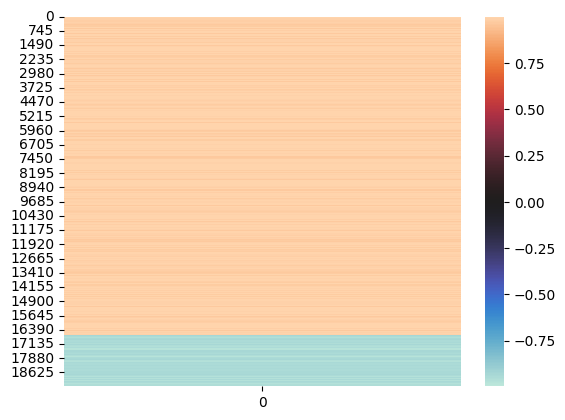

metacluster_0
activity pattern: [1]
metacluster_0 pattern_0
total seqlets: 353
Task 1 hypothetical scores:


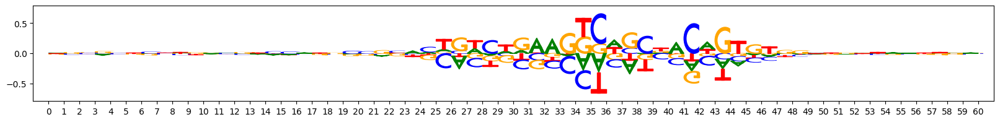

Task 1 actual importance scores:


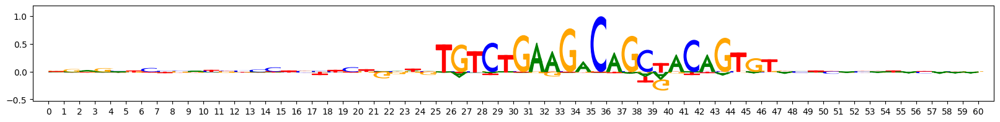

onehot, fwd and rev:


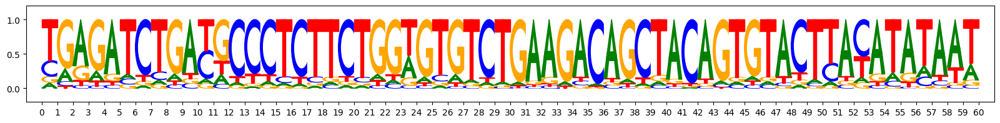

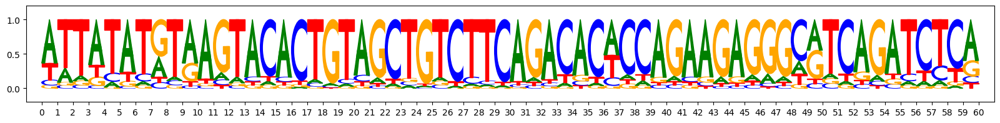

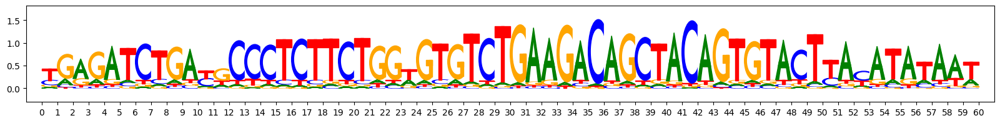

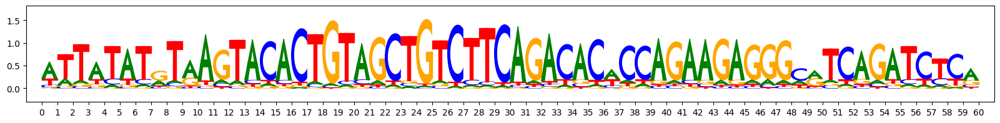

PLOTTING SUBCLUSTERS


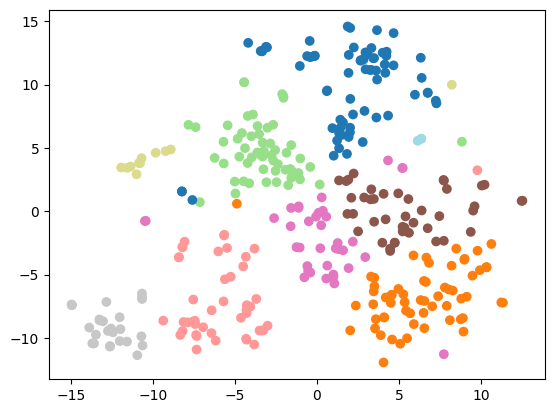

subcluster_0 size 70


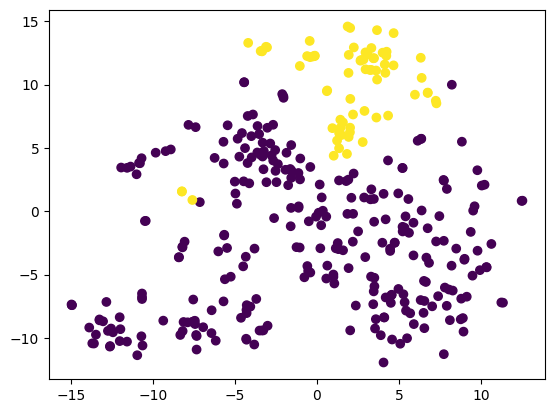

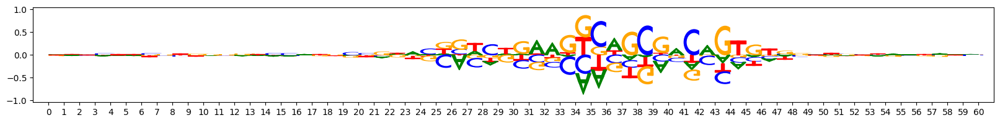

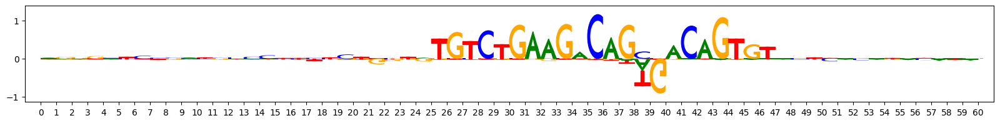

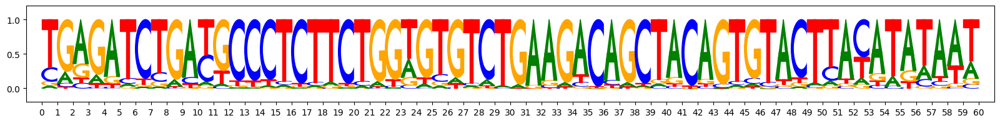

subcluster_1 size 61


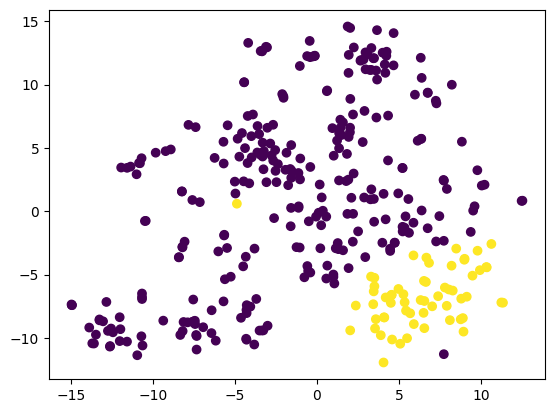

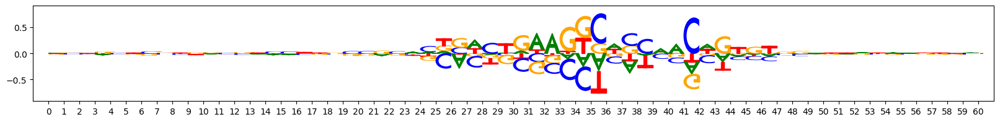

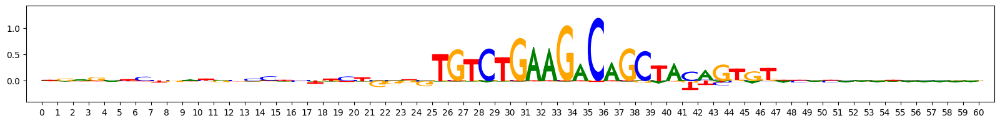

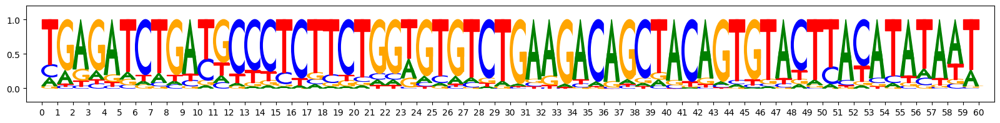

subcluster_2 size 56


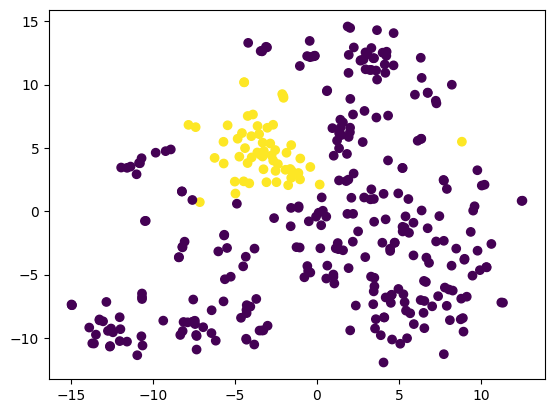

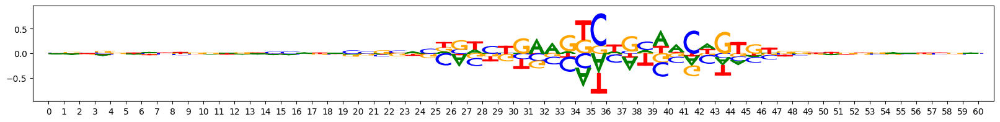

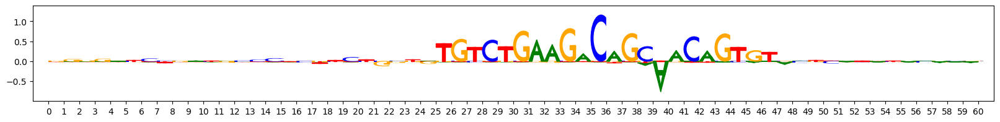

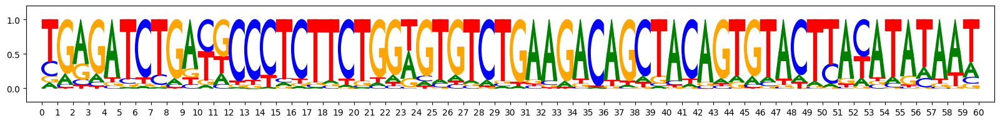

subcluster_3 size 46


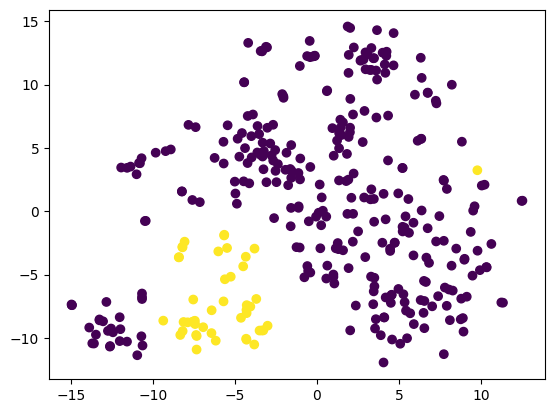

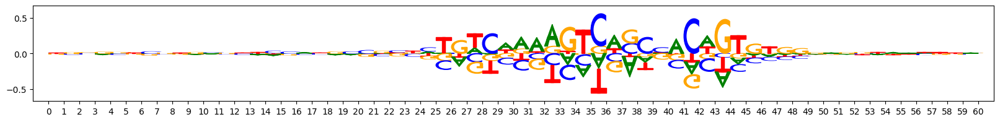

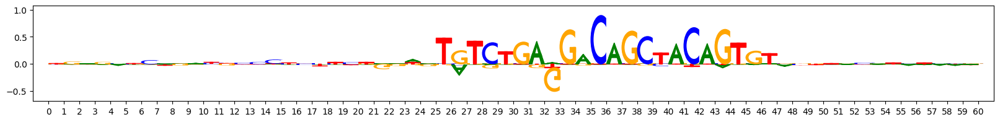

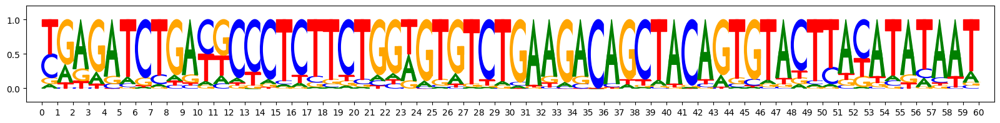

subcluster_4 size 43


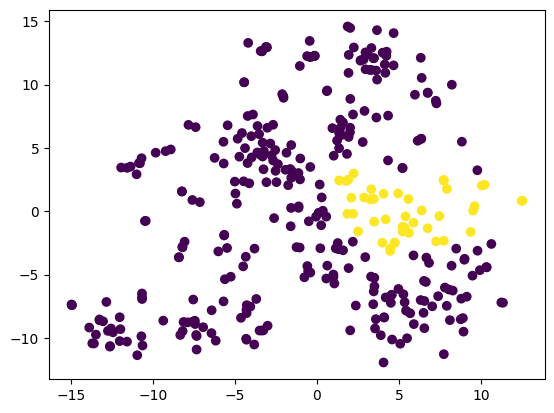

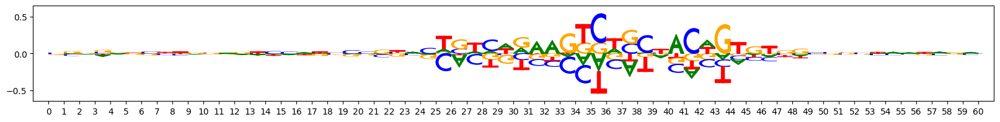

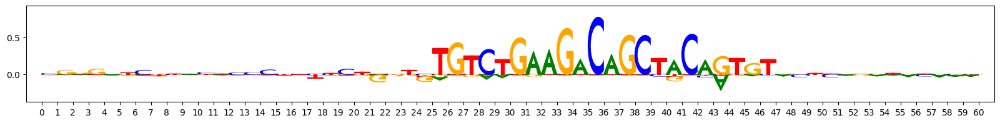

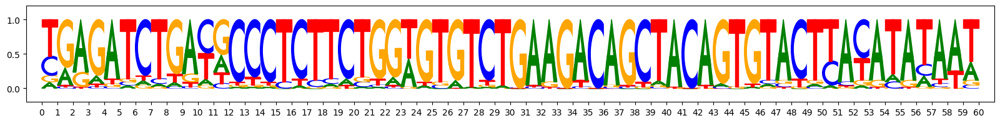

subcluster_5 size 37


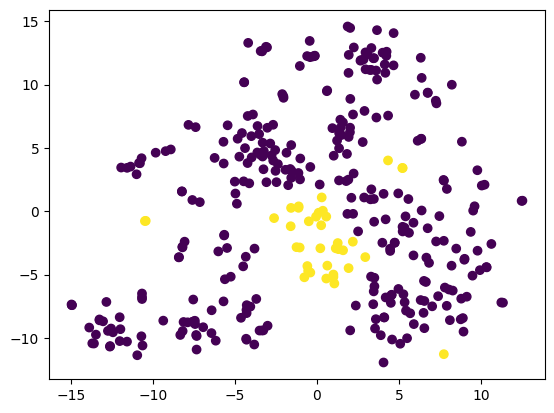

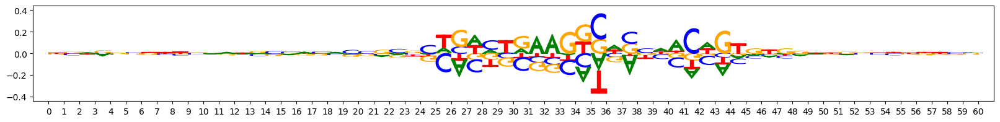

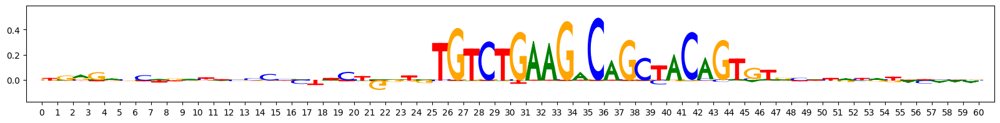

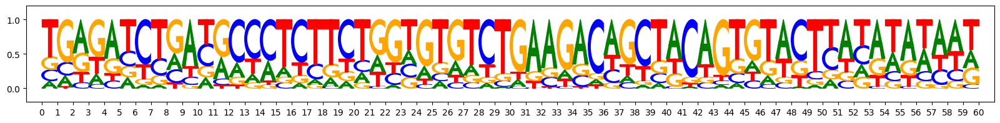

subcluster_6 size 26


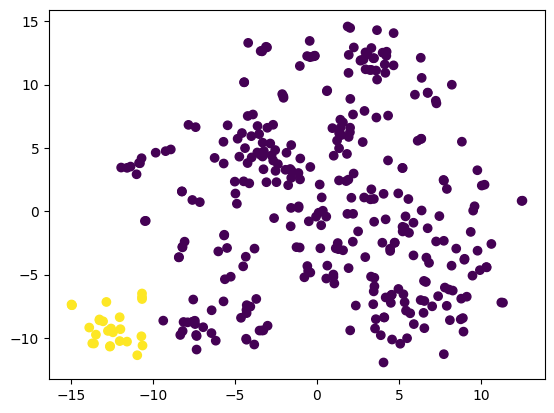

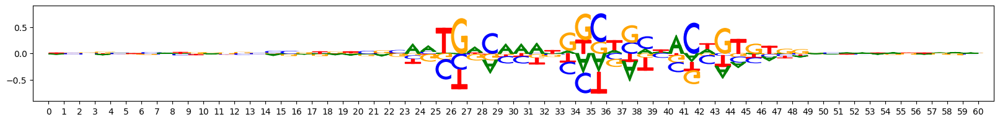

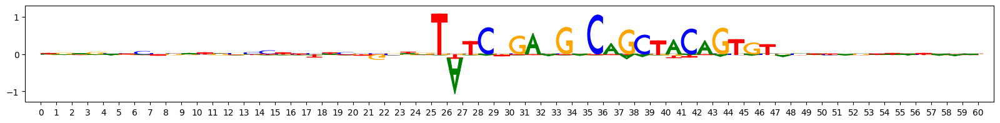

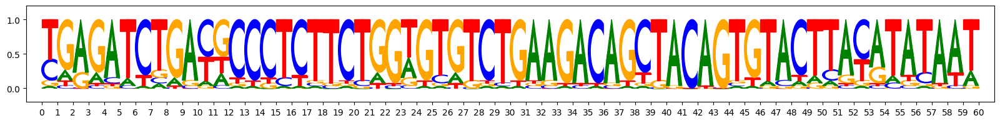

subcluster_7 size 11


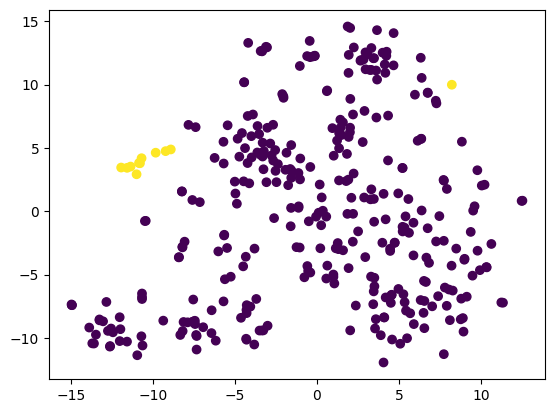

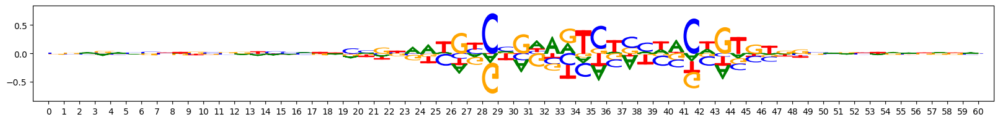

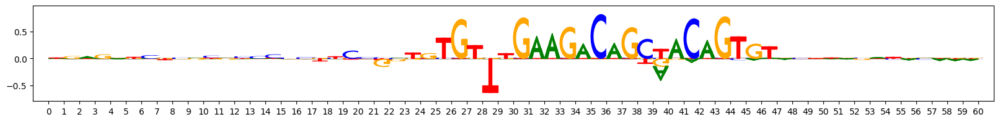

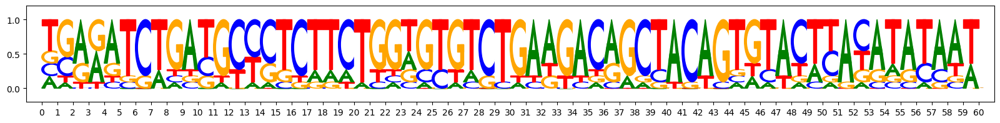

subcluster_8 size 3


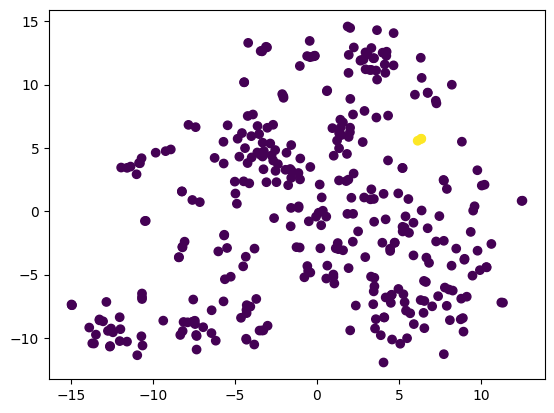

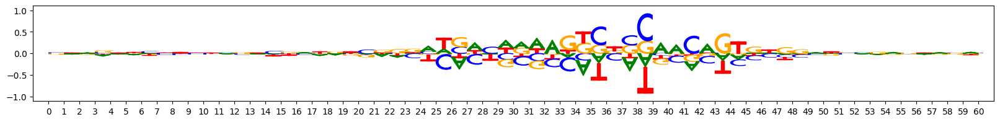

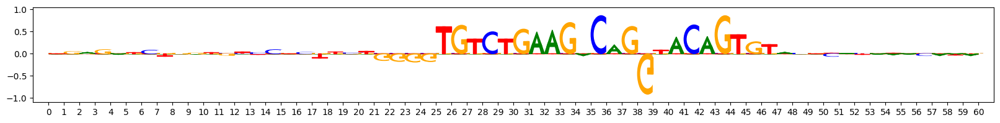

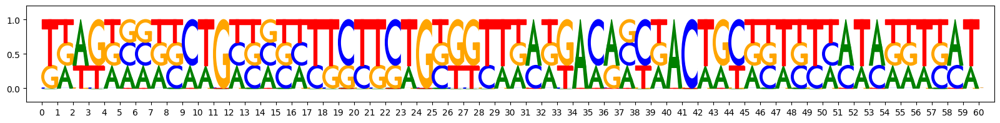

metacluster_0 pattern_1
total seqlets: 240
Task 1 hypothetical scores:


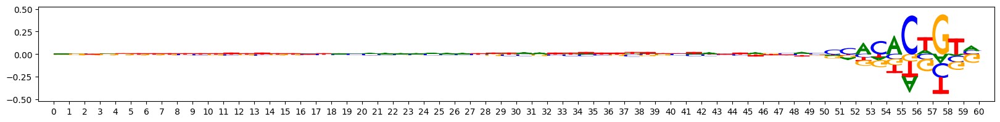

Task 1 actual importance scores:


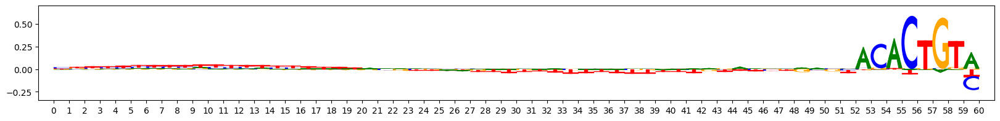

onehot, fwd and rev:


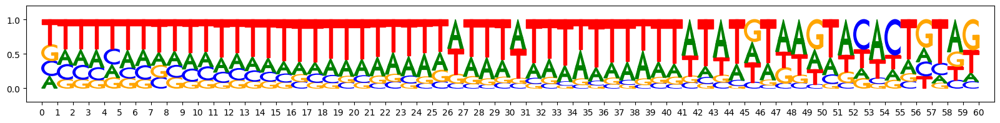

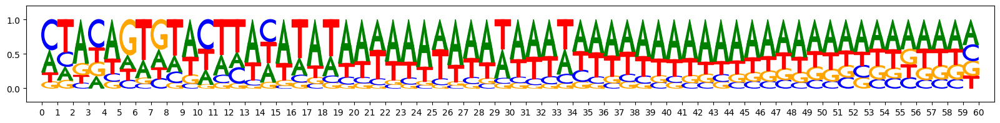

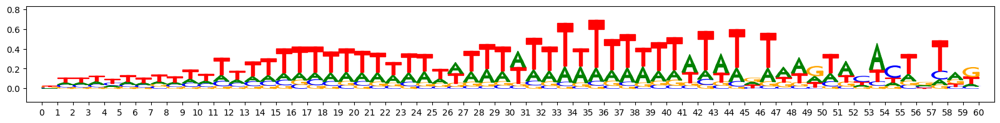

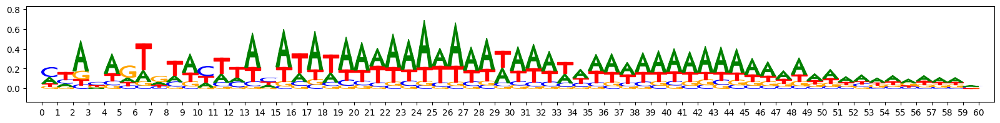

PLOTTING SUBCLUSTERS


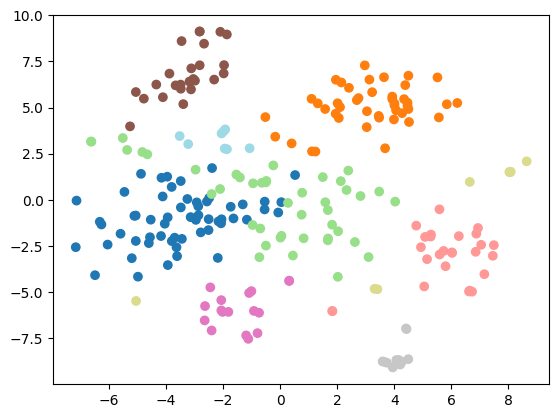

subcluster_0 size 57


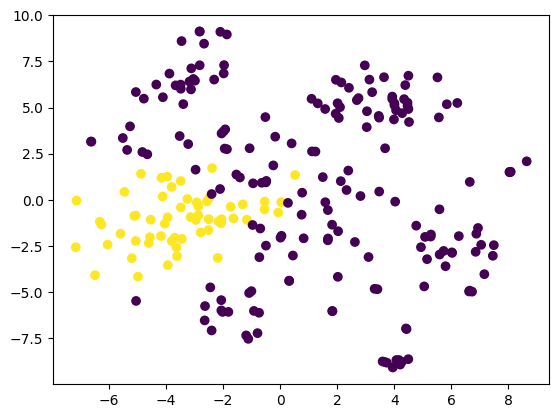

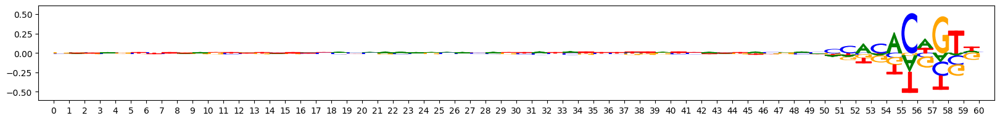

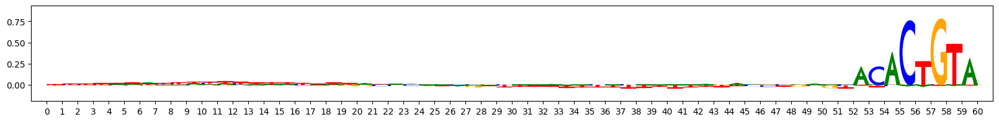

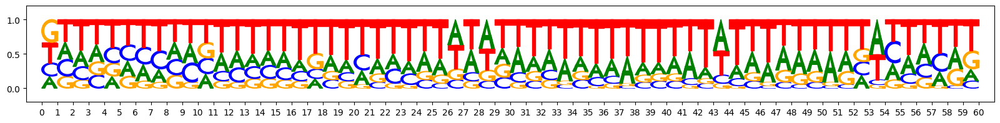

subcluster_1 size 44


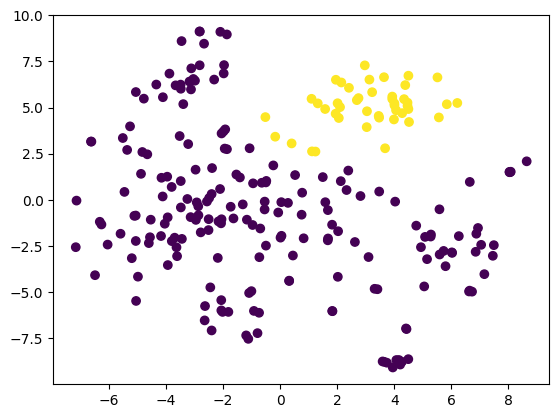

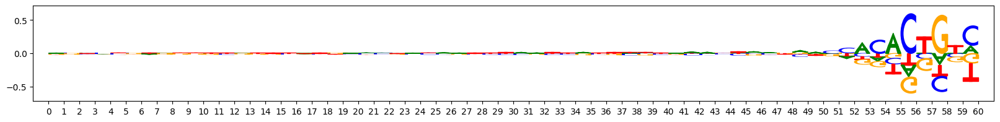

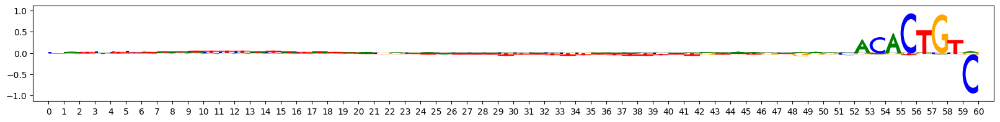

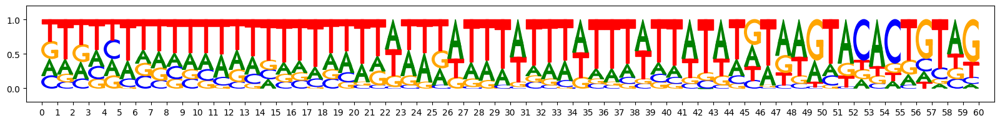

subcluster_2 size 43


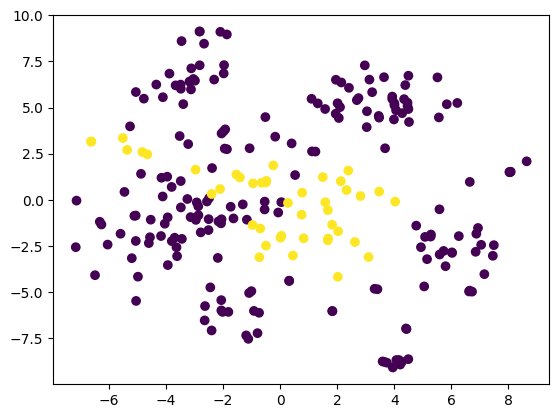

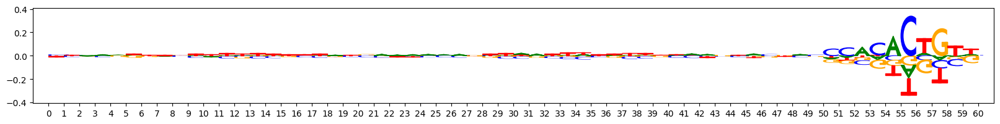

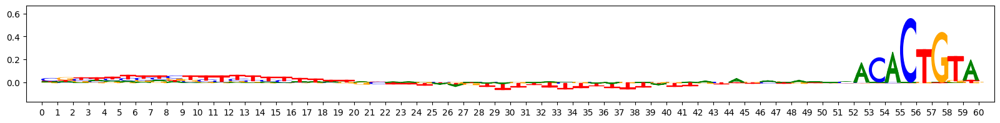

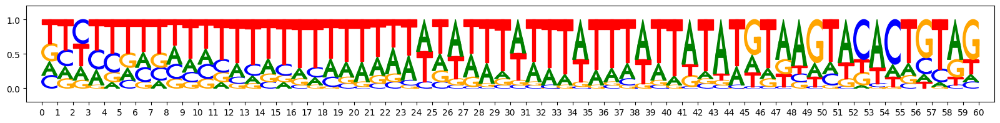

subcluster_3 size 26


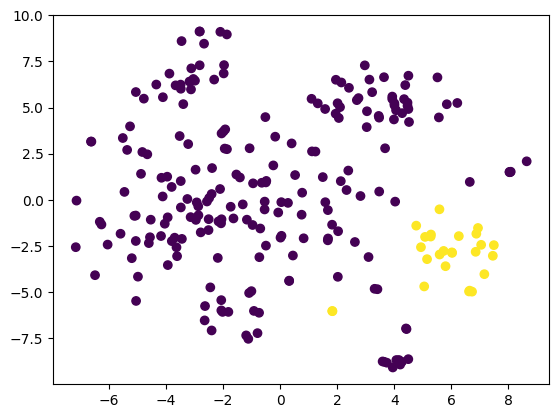

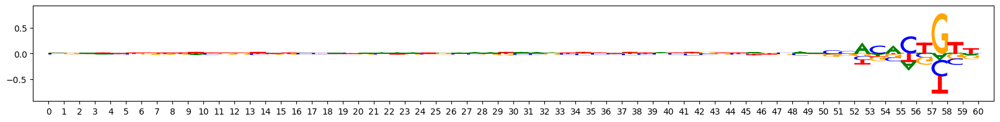

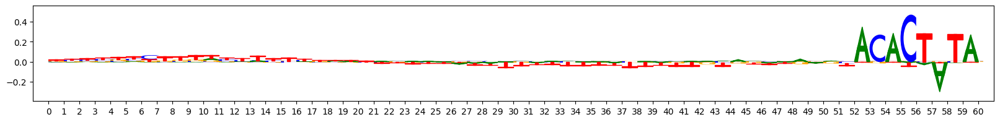

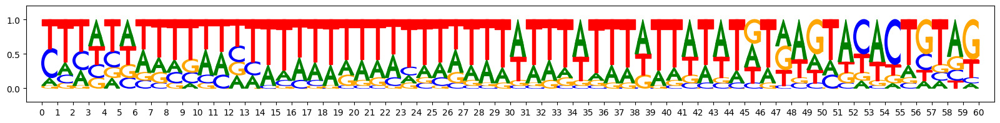

subcluster_4 size 25


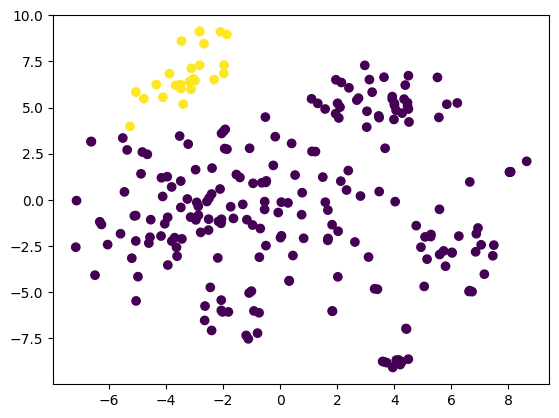

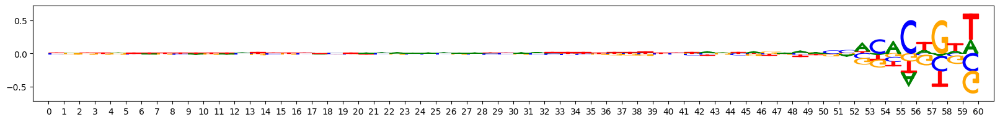

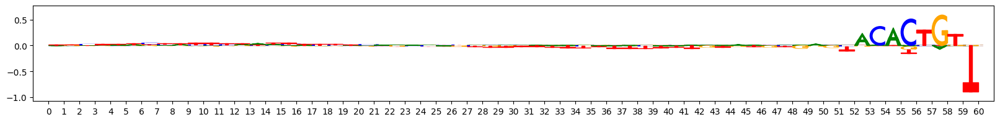

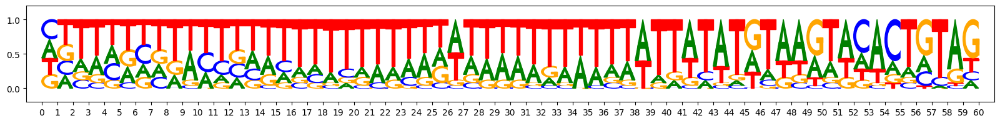

subcluster_5 size 17


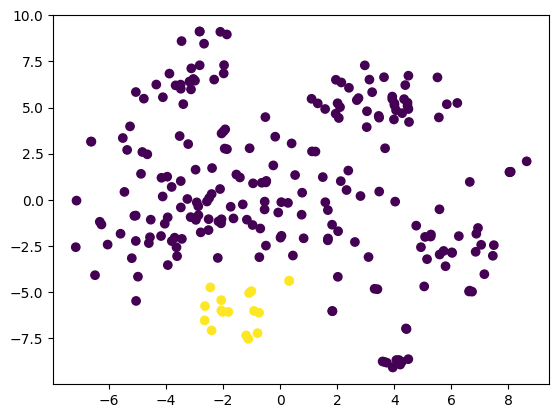

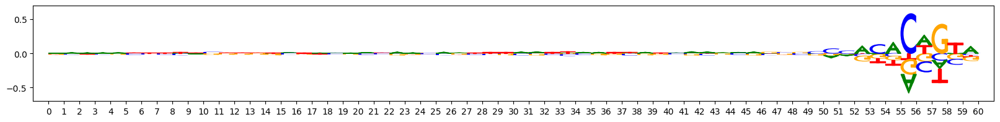

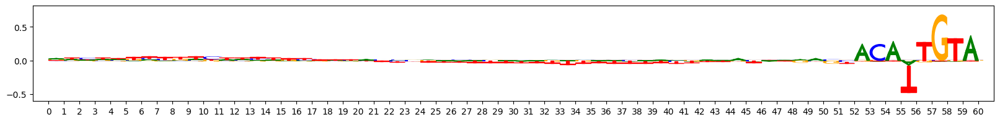

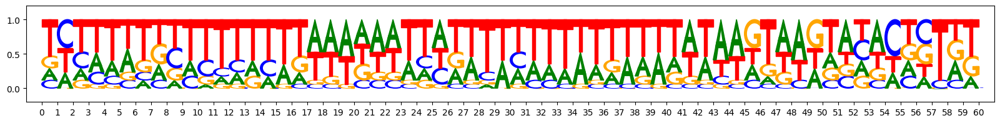

subcluster_6 size 11


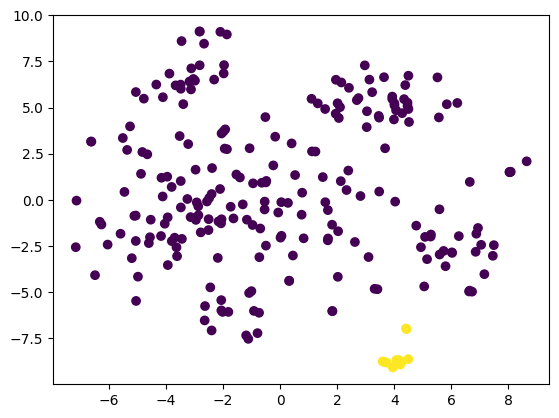

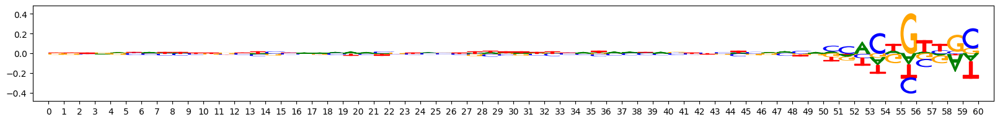

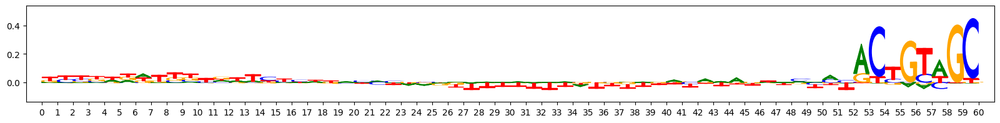

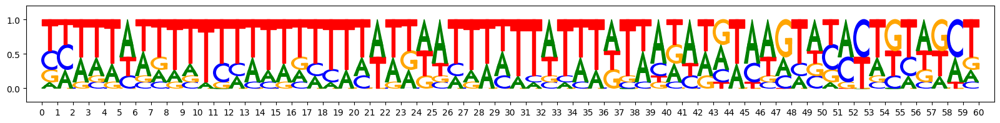

subcluster_7 size 9


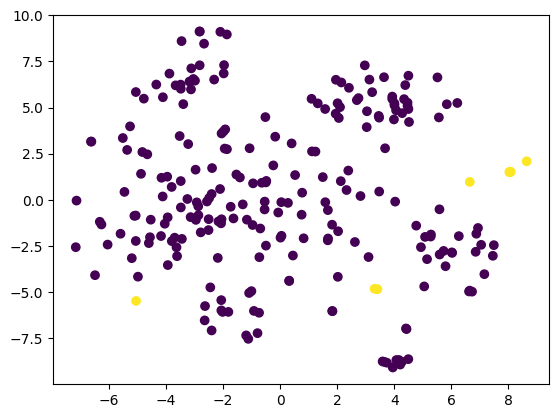

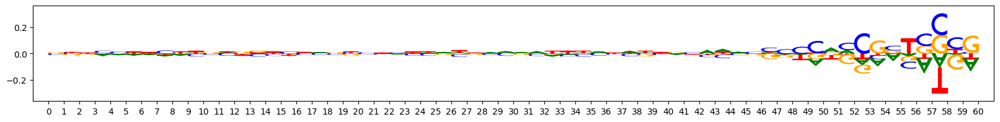

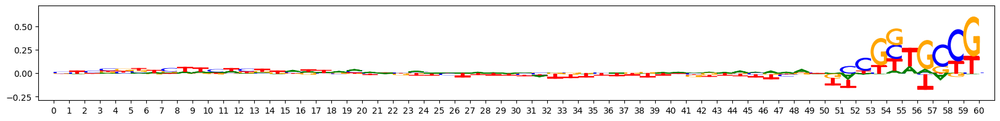

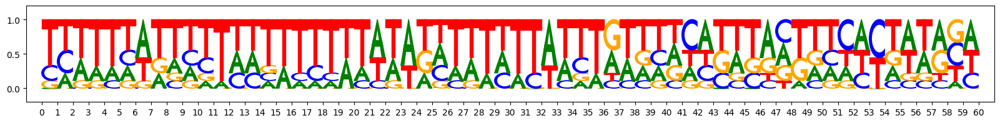

subcluster_8 size 8


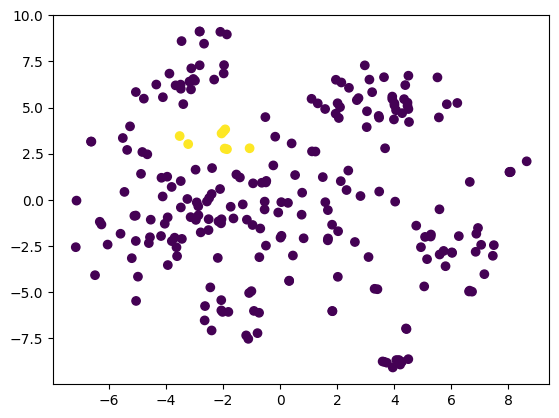

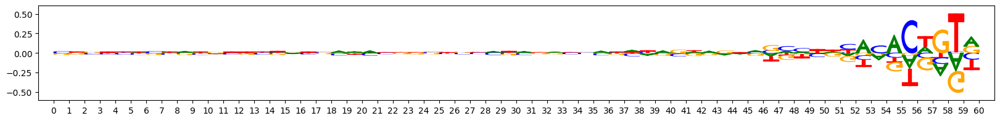

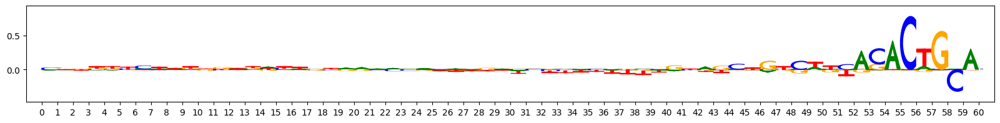

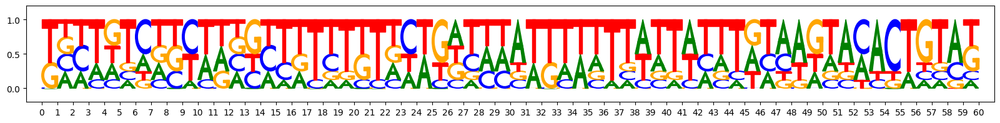

metacluster_0 pattern_2
total seqlets: 75
Task 1 hypothetical scores:


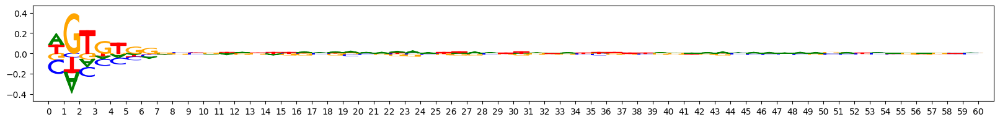

Task 1 actual importance scores:


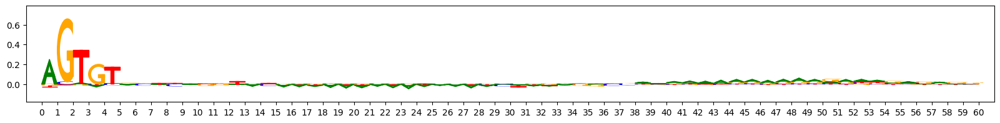

onehot, fwd and rev:


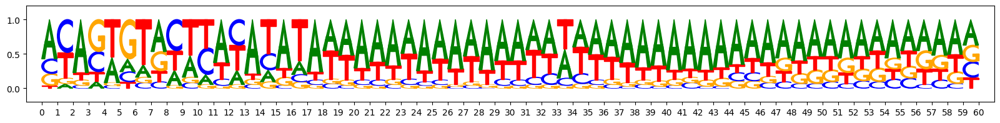

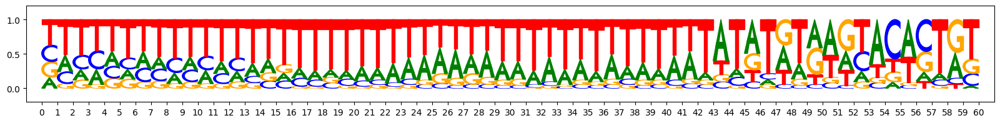

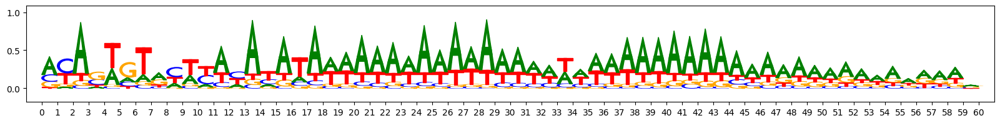

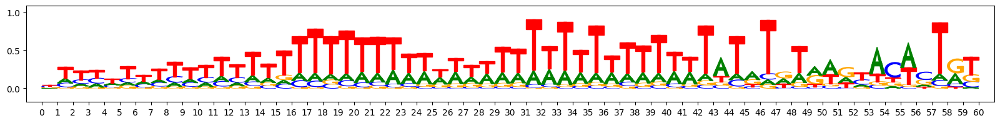

PLOTTING SUBCLUSTERS


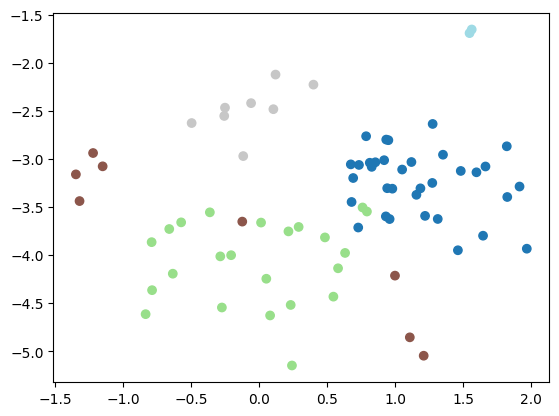

subcluster_0 size 34


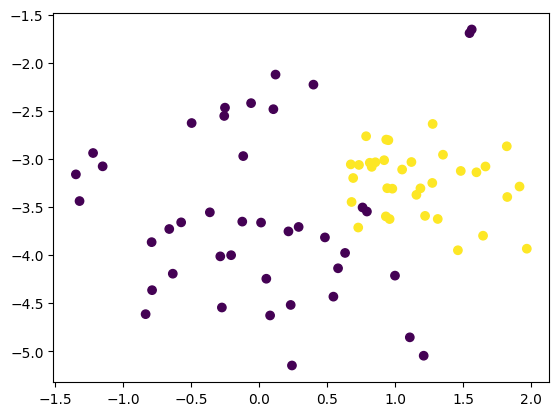

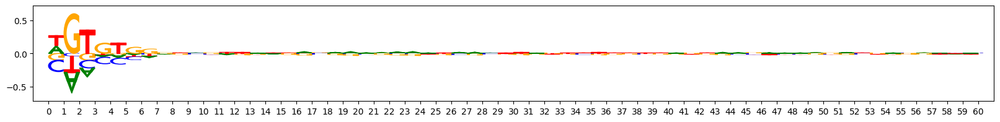

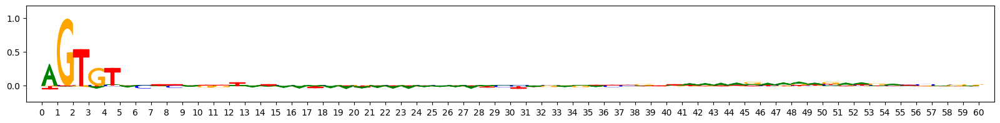

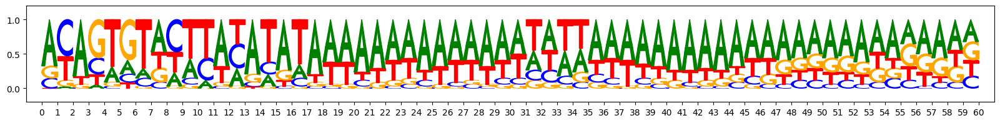

subcluster_1 size 23


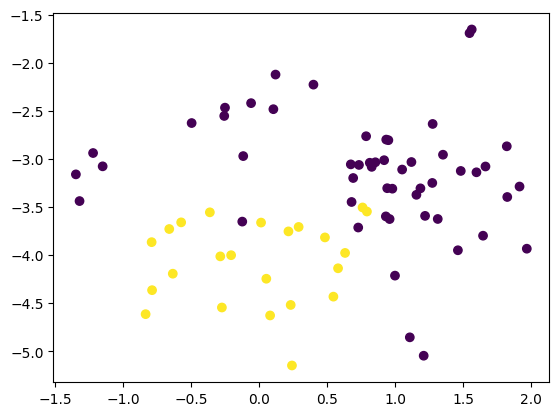

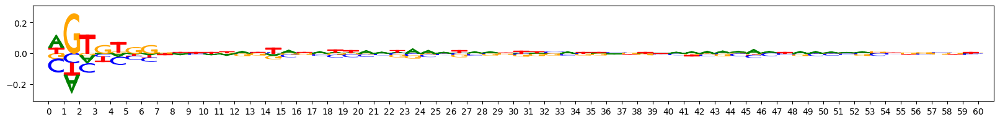

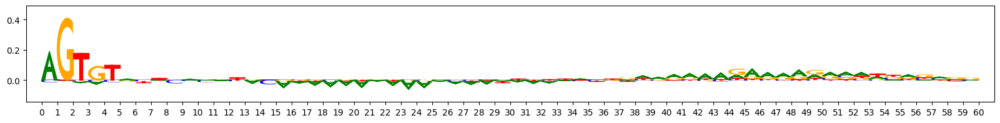

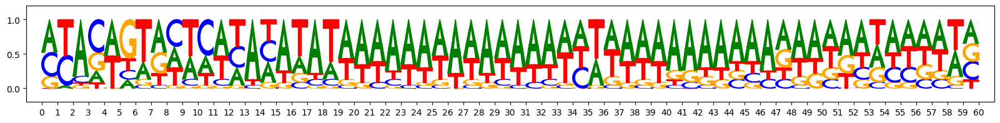

subcluster_3 size 8


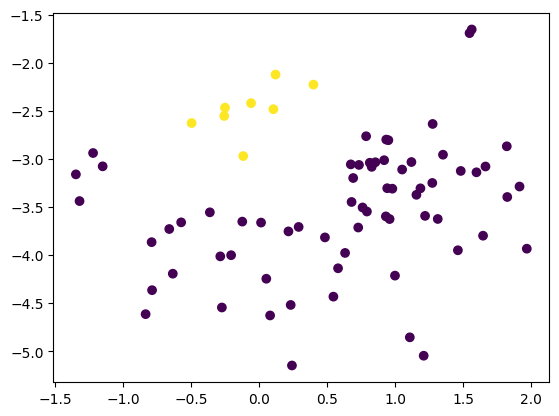

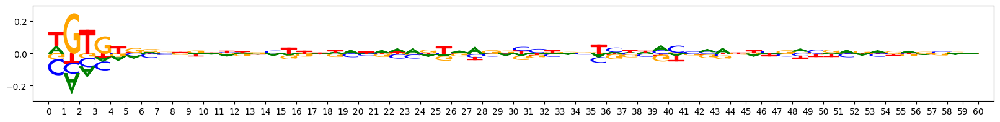

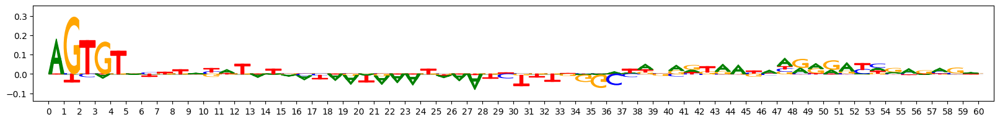

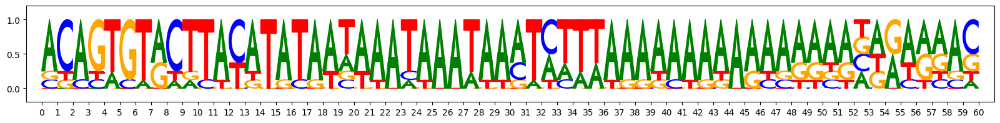

subcluster_2 size 8


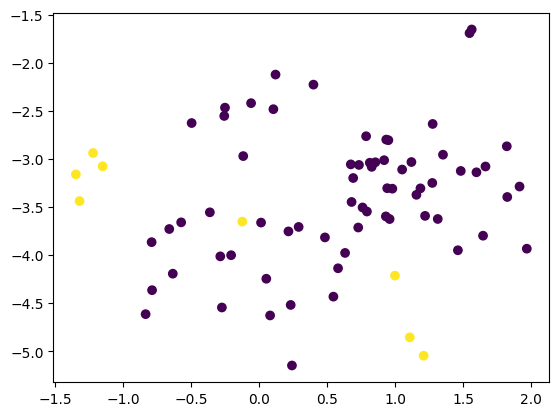

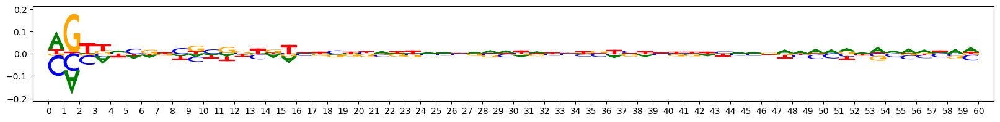

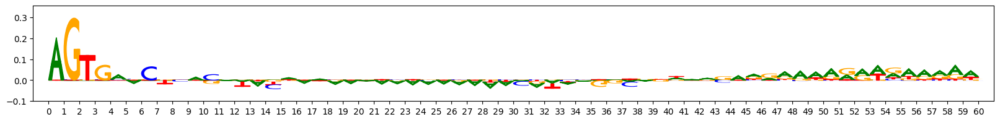

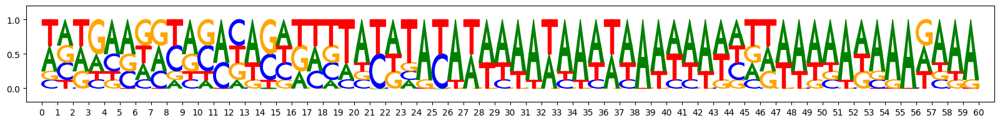

subcluster_4 size 2


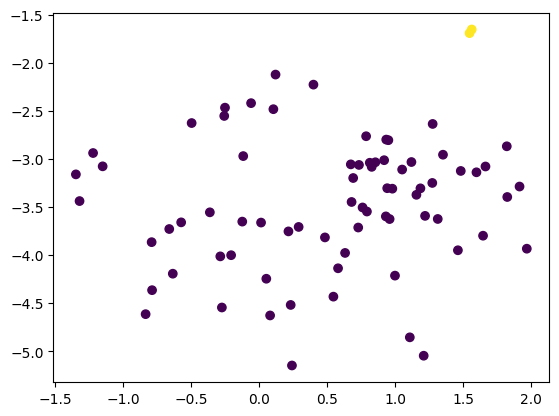

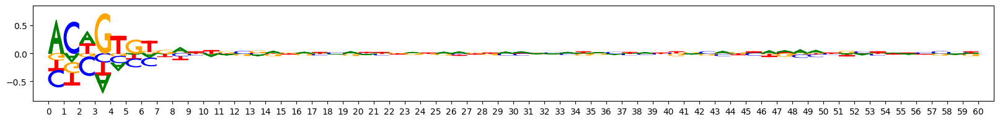

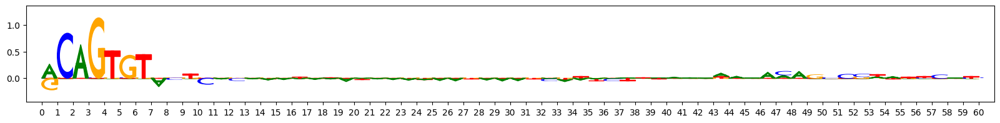

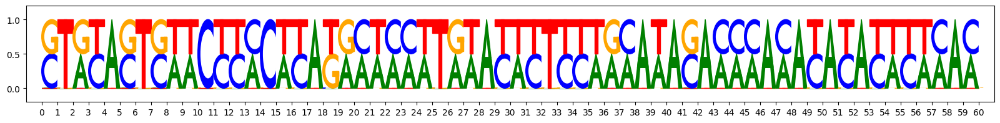

metacluster_0 pattern_3
total seqlets: 73
Task 1 hypothetical scores:


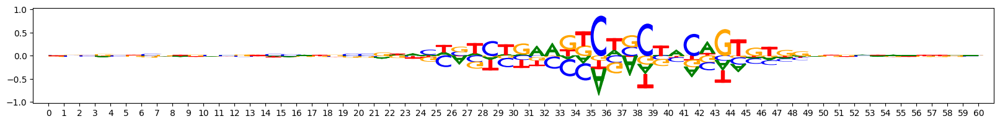

Task 1 actual importance scores:


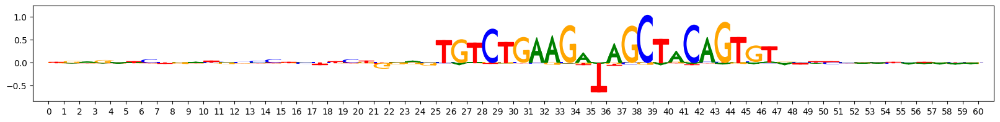

onehot, fwd and rev:


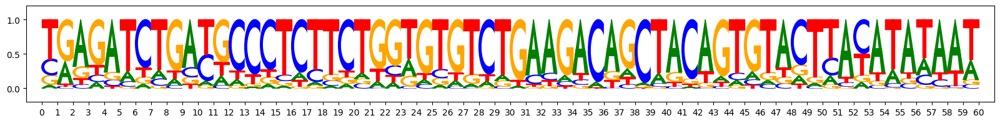

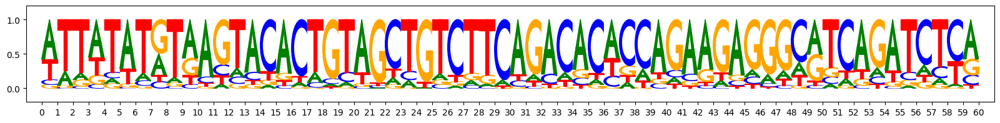

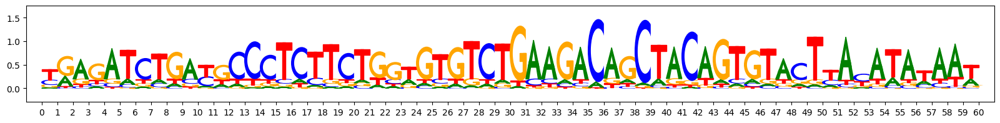

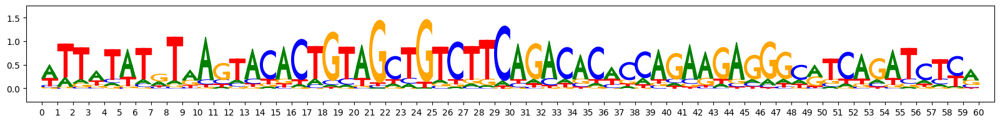

PLOTTING SUBCLUSTERS


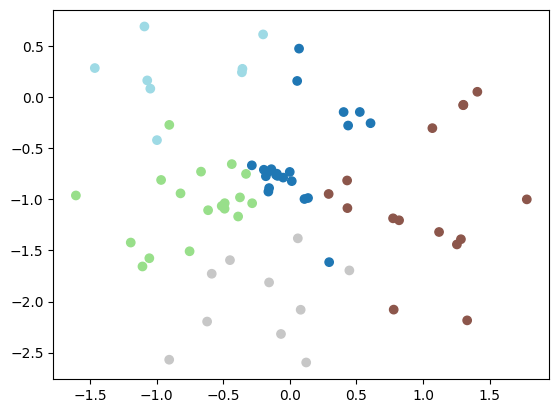

subcluster_0 size 22


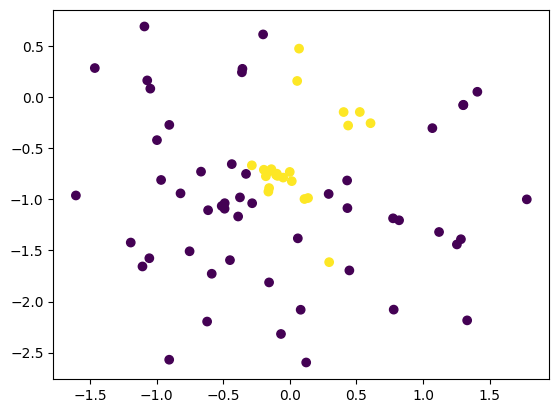

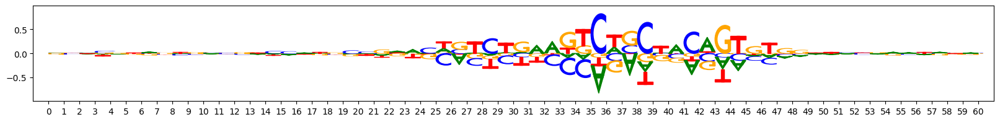

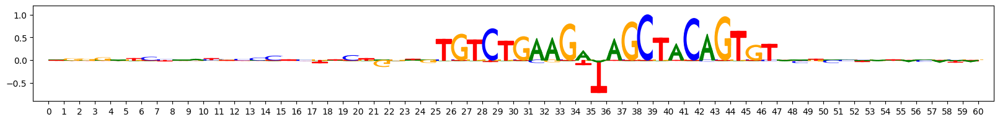

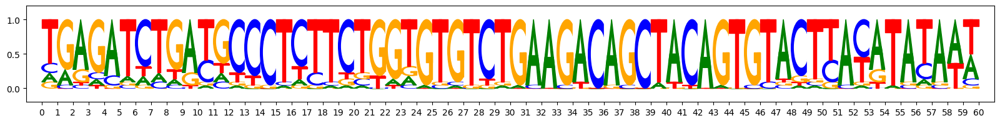

subcluster_1 size 18


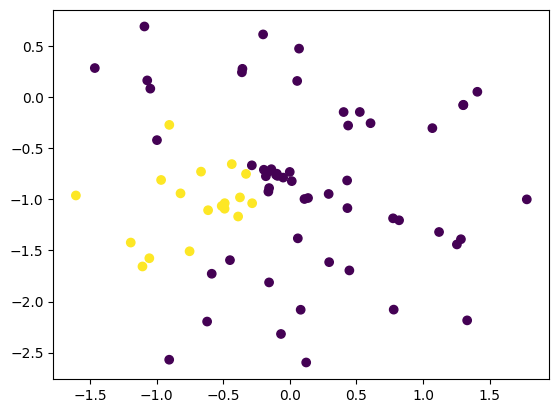

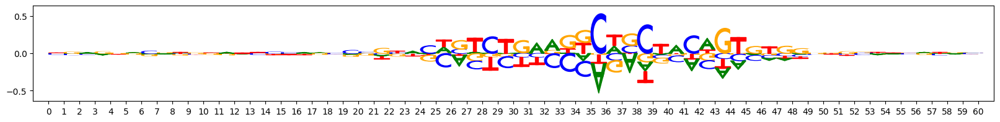

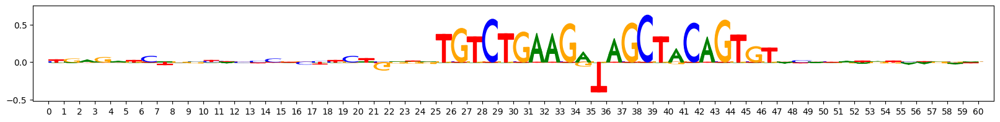

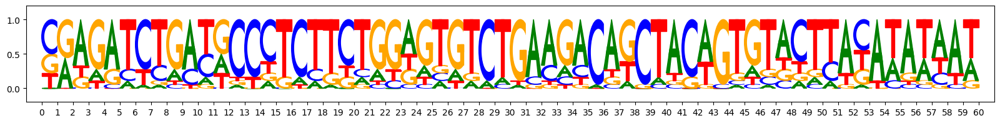

subcluster_2 size 15


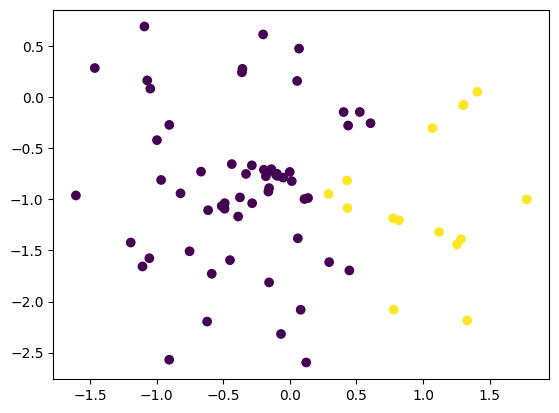

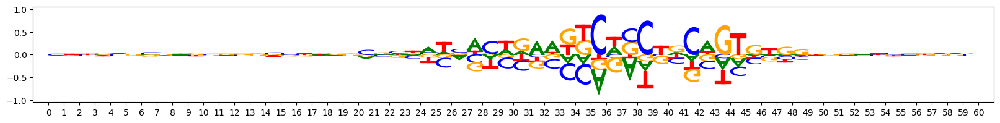

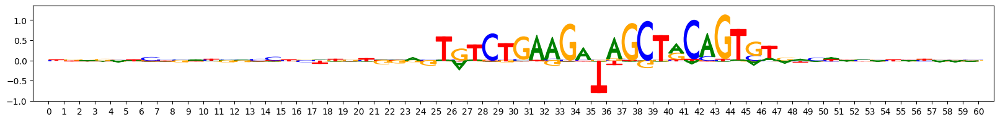

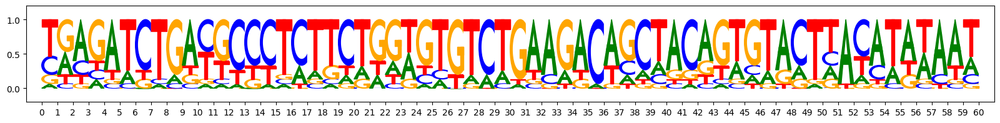

subcluster_3 size 10


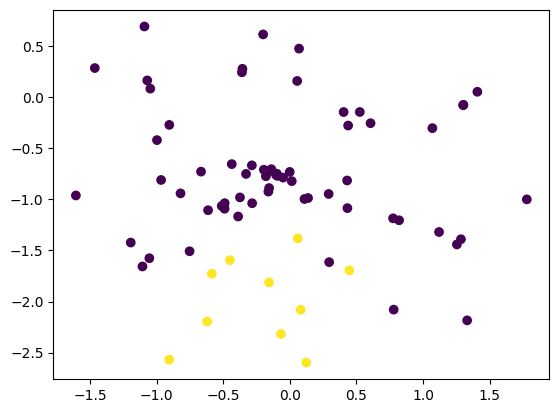

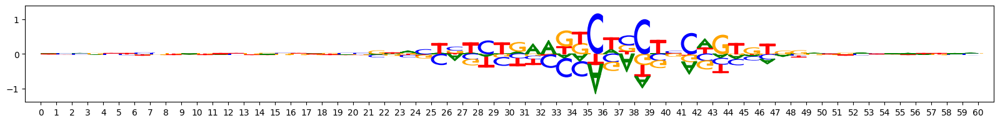

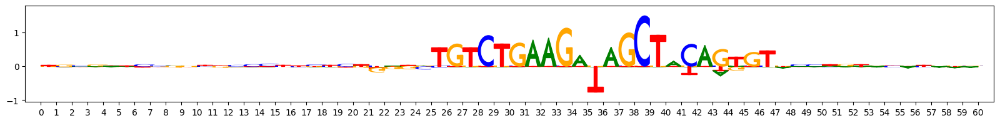

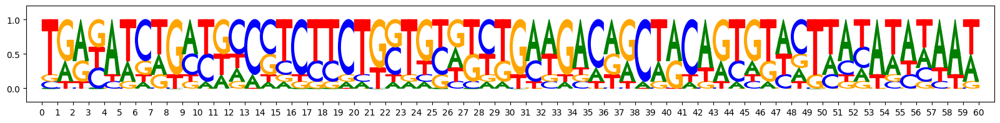

subcluster_4 size 8


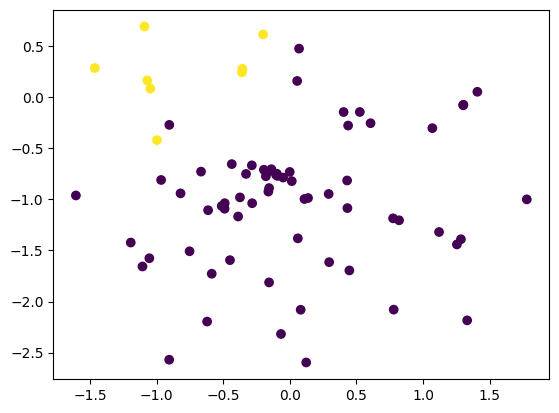

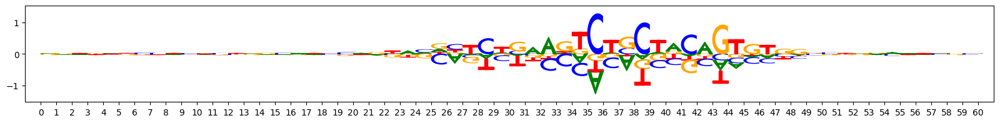

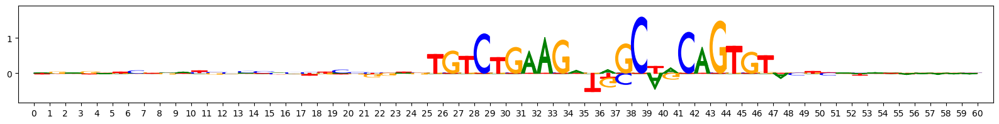

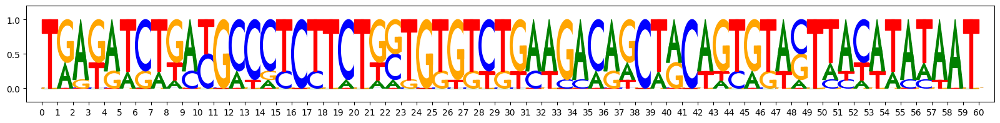

metacluster_0 pattern_4
total seqlets: 57
Task 1 hypothetical scores:


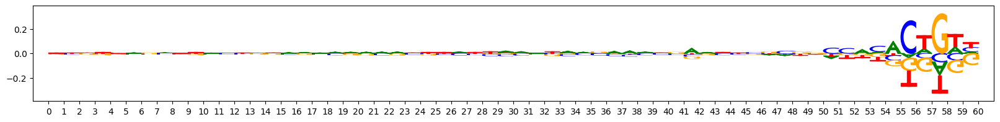

Task 1 actual importance scores:


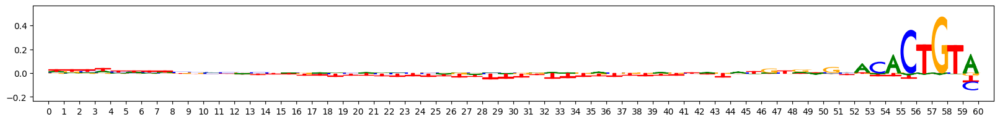

onehot, fwd and rev:


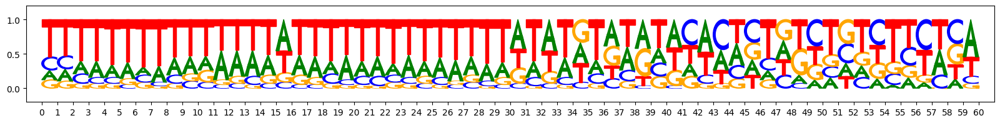

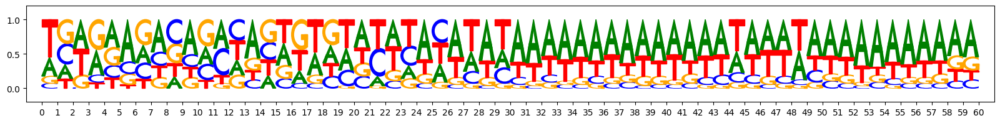

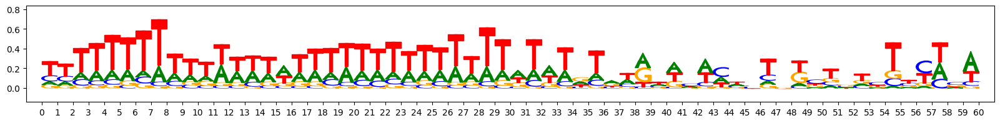

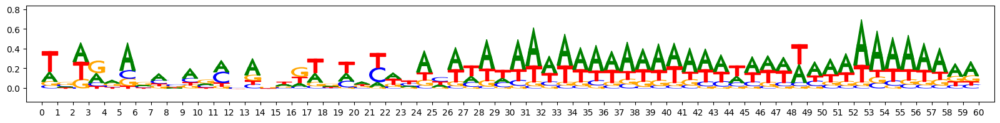

PLOTTING SUBCLUSTERS


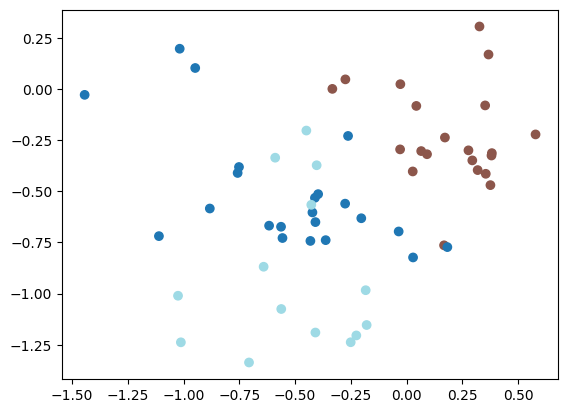

subcluster_0 size 22


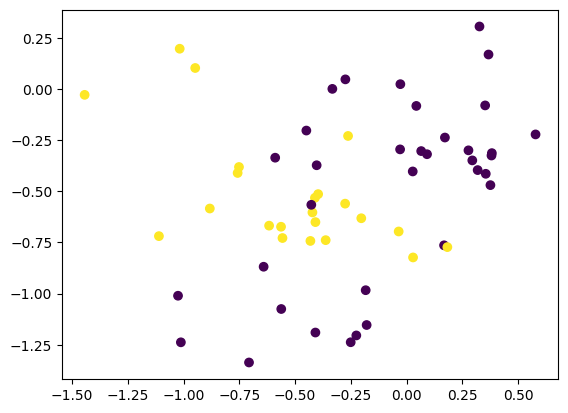

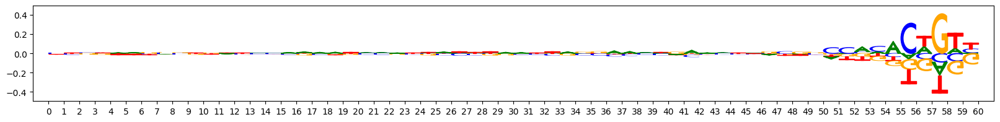

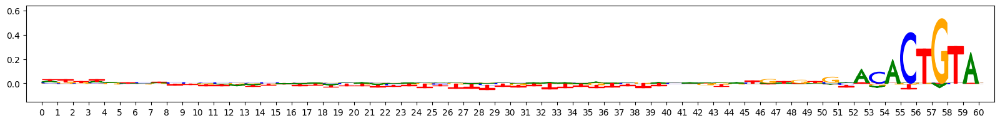

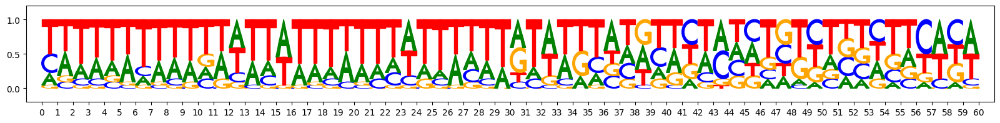

subcluster_1 size 21


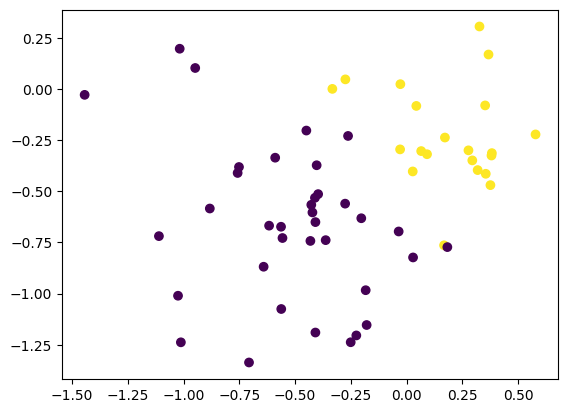

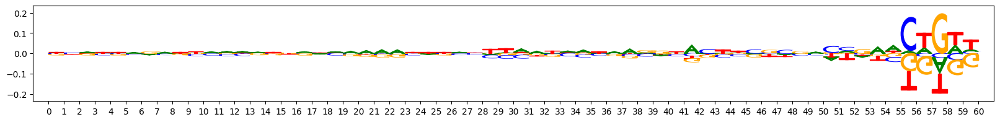

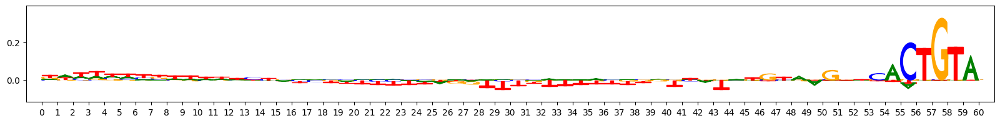

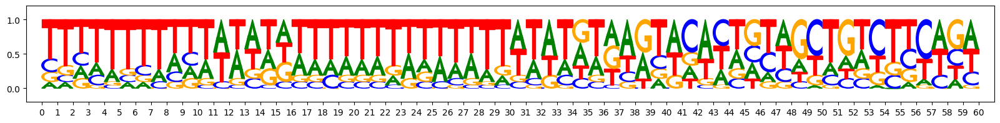

subcluster_2 size 14


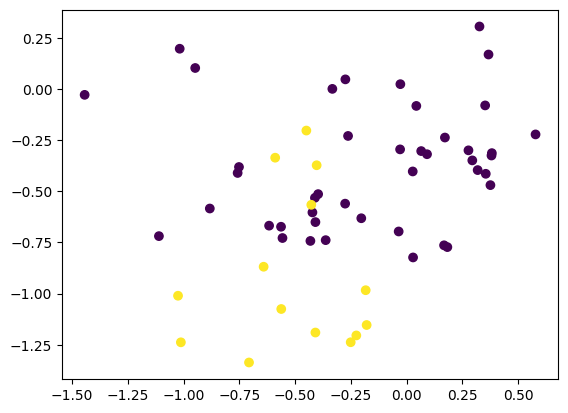

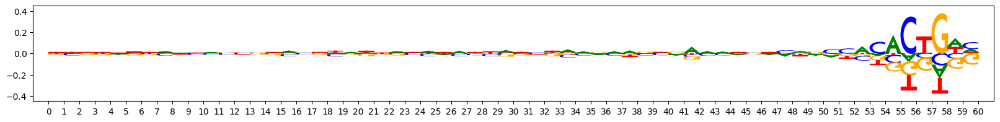

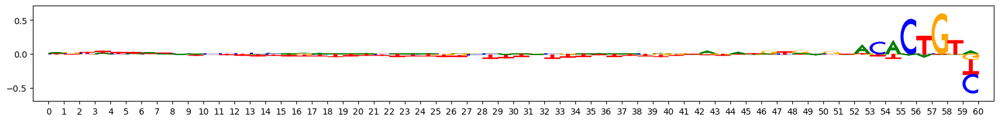

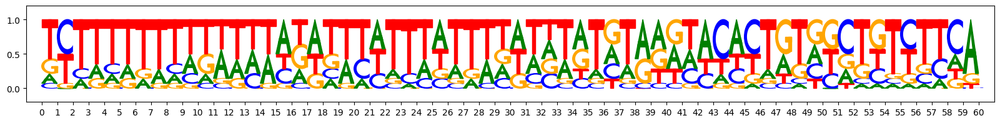

metacluster_0 pattern_5
total seqlets: 45
Task 1 hypothetical scores:


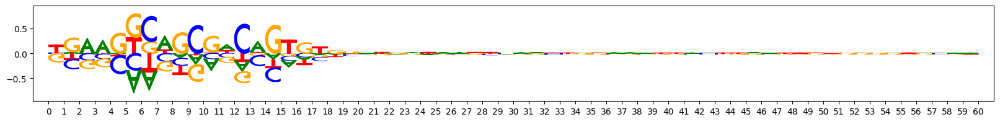

Task 1 actual importance scores:


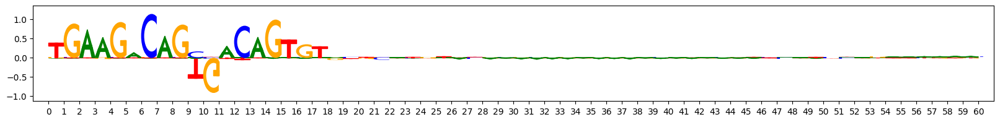

onehot, fwd and rev:


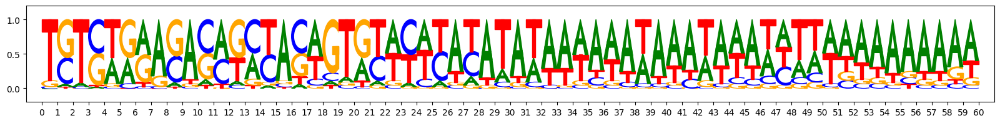

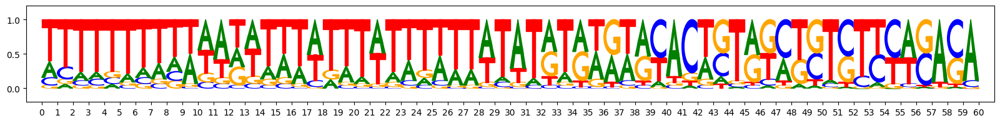

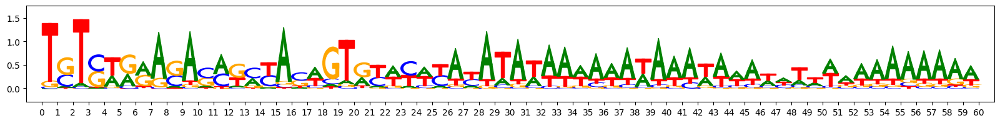

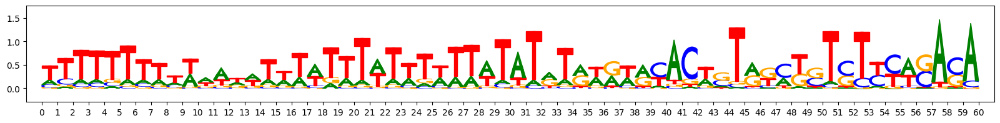

PLOTTING SUBCLUSTERS


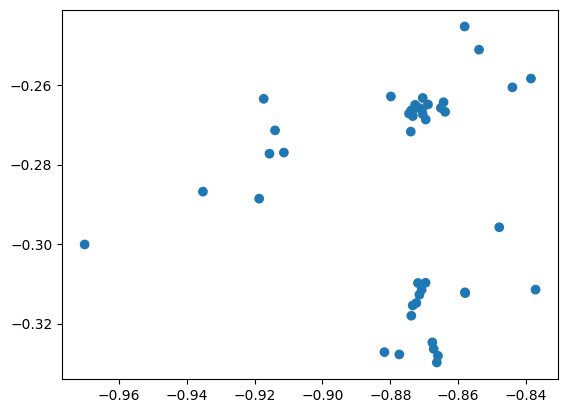

subcluster_0 size 45


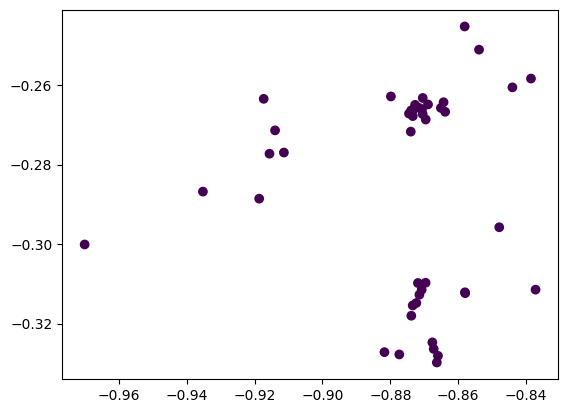

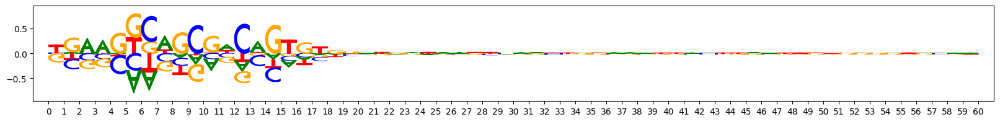

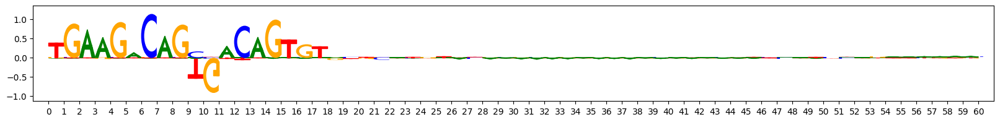

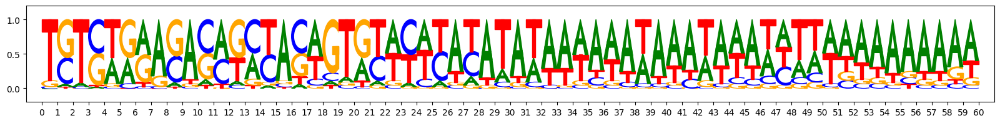

metacluster_0 pattern_6
total seqlets: 41
Task 1 hypothetical scores:


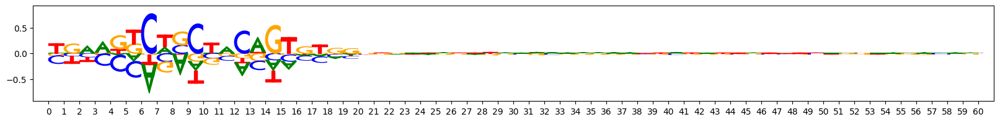

Task 1 actual importance scores:


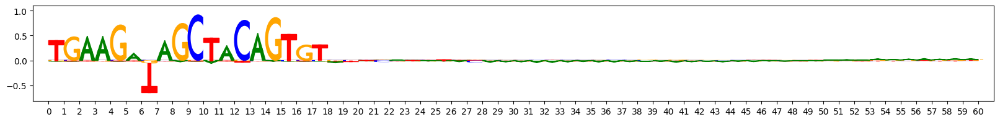

onehot, fwd and rev:


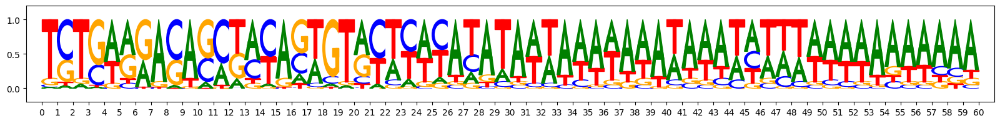

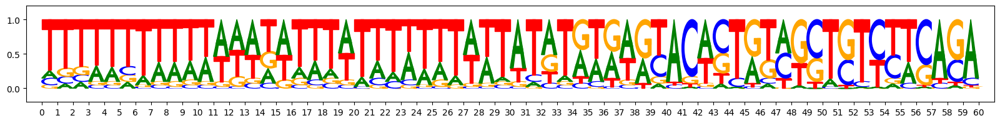

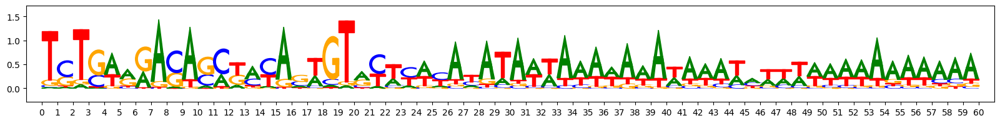

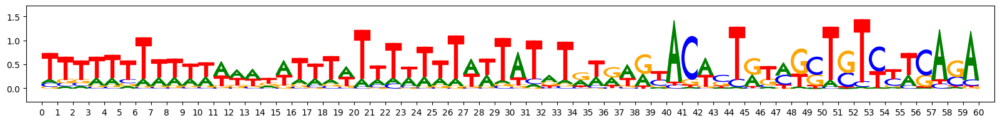

PLOTTING SUBCLUSTERS


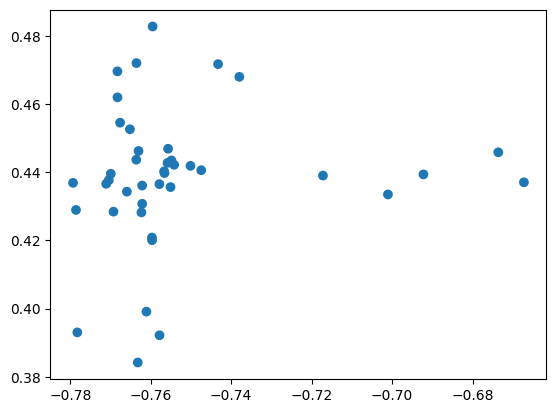

subcluster_0 size 41


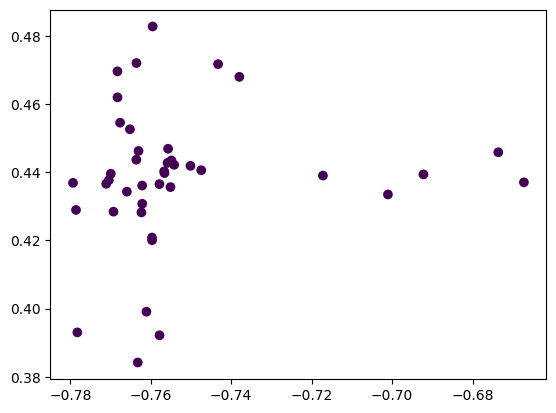

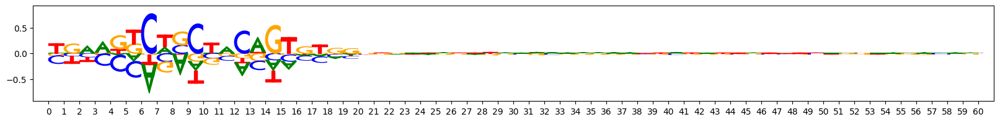

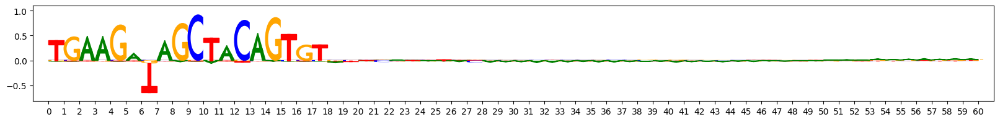

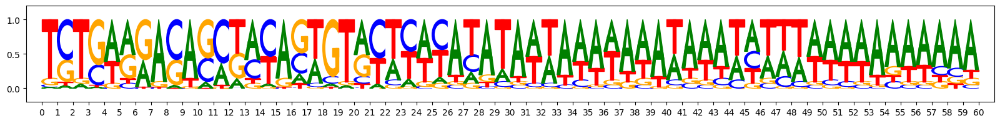

metacluster_0 pattern_7
total seqlets: 45
Task 1 hypothetical scores:


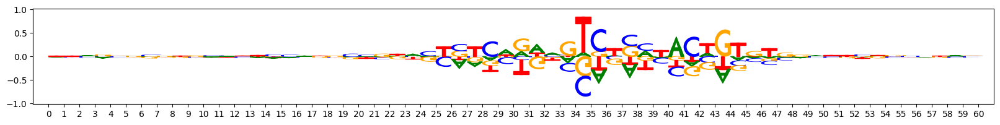

Task 1 actual importance scores:


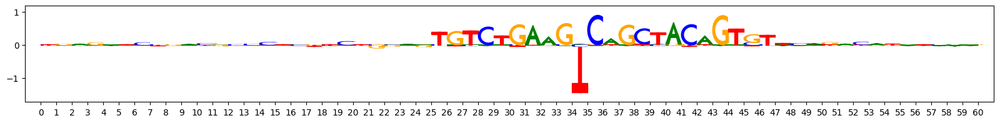

onehot, fwd and rev:


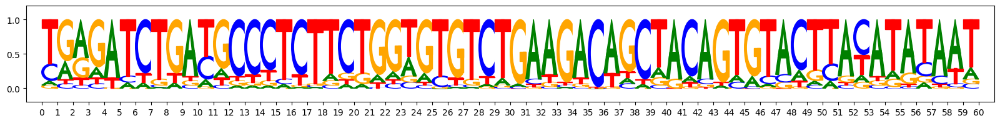

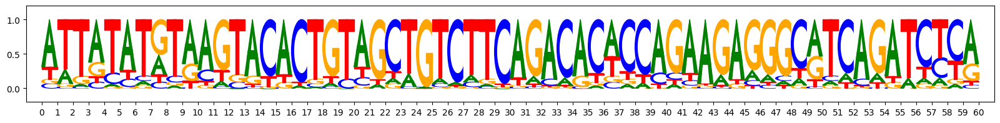

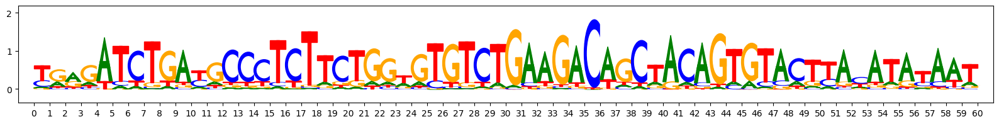

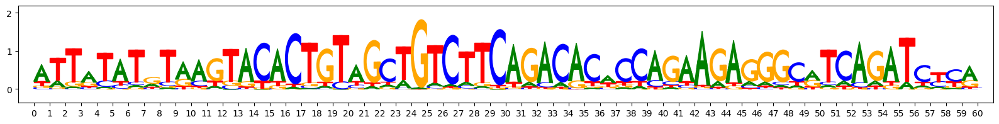

PLOTTING SUBCLUSTERS


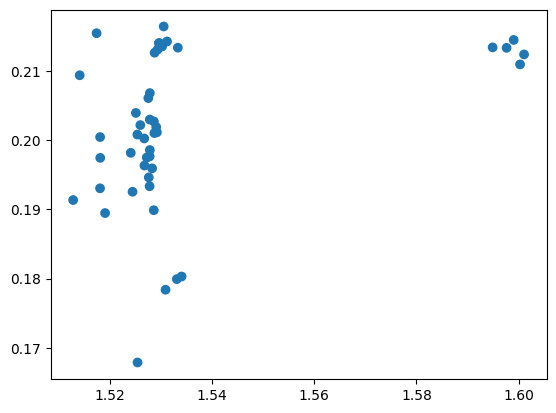

subcluster_0 size 45


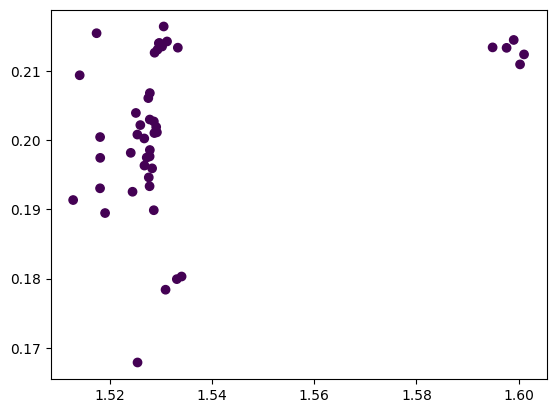

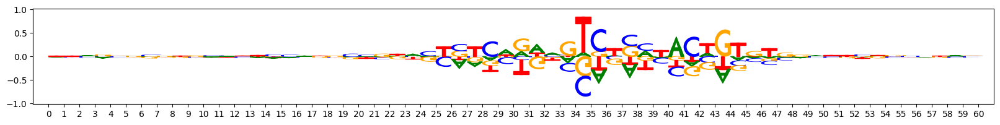

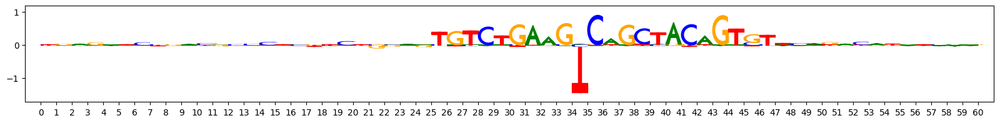

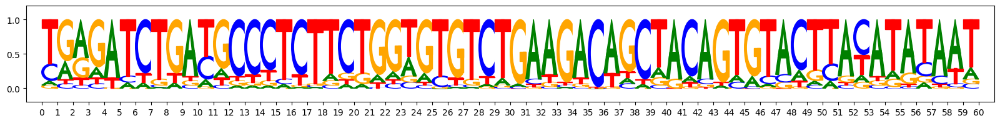

metacluster_0 pattern_8
total seqlets: 41
Task 1 hypothetical scores:


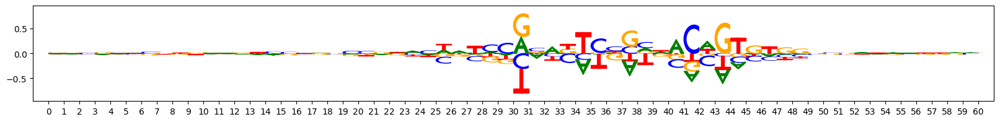

Task 1 actual importance scores:


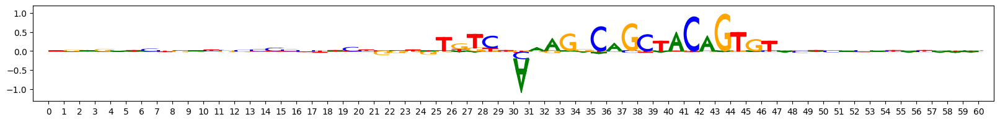

onehot, fwd and rev:


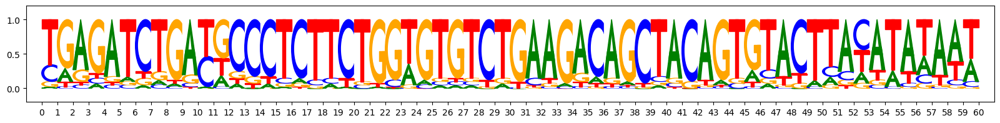

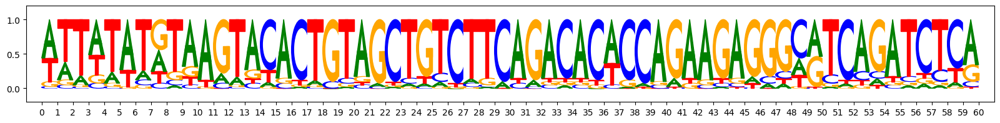

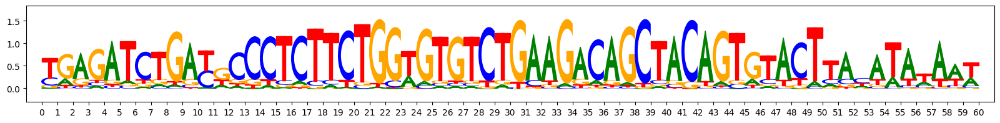

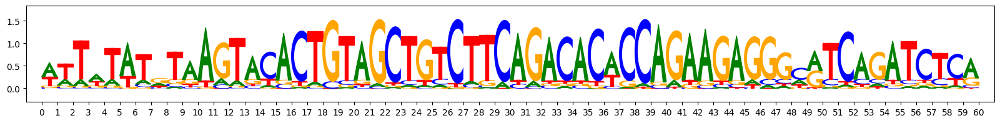

PLOTTING SUBCLUSTERS


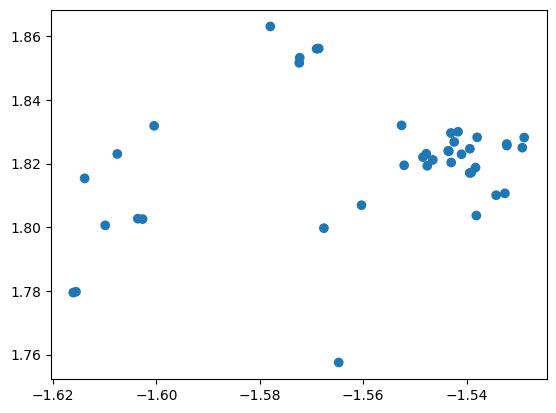

subcluster_0 size 41


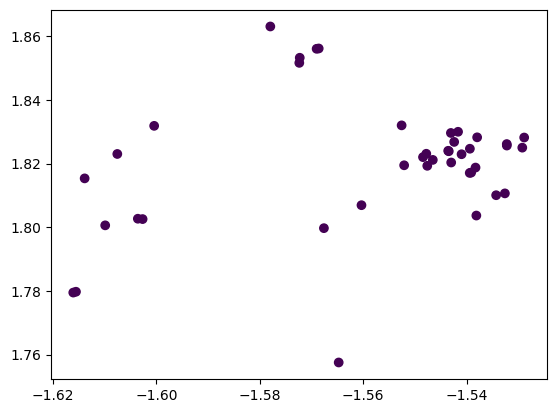

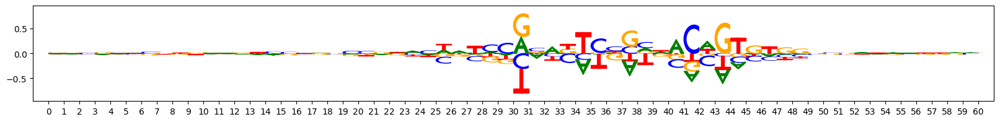

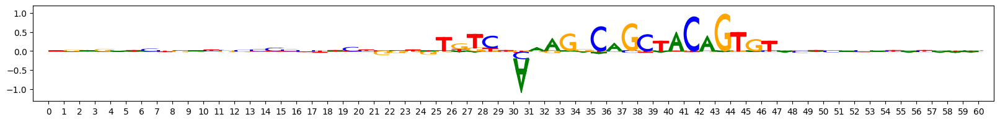

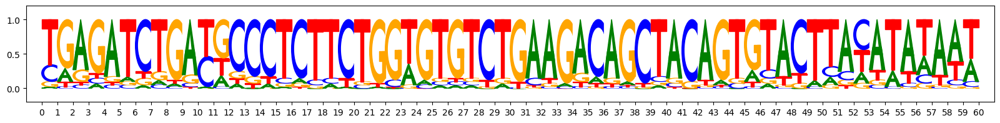

metacluster_0 pattern_9
total seqlets: 39
Task 1 hypothetical scores:


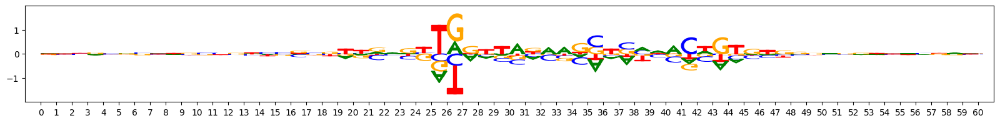

Task 1 actual importance scores:


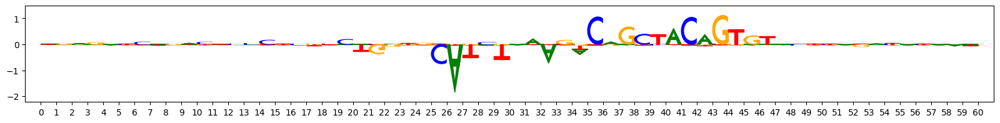

onehot, fwd and rev:


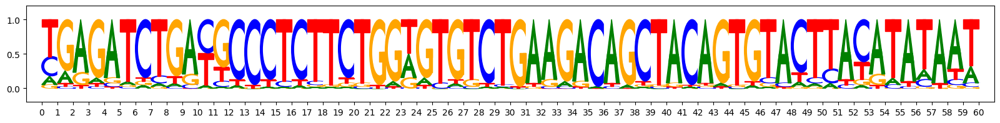

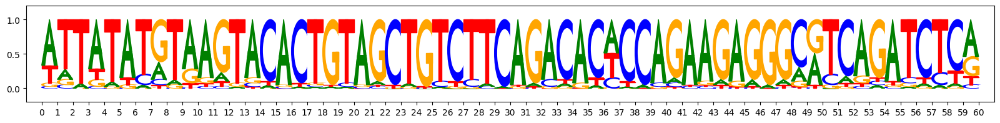

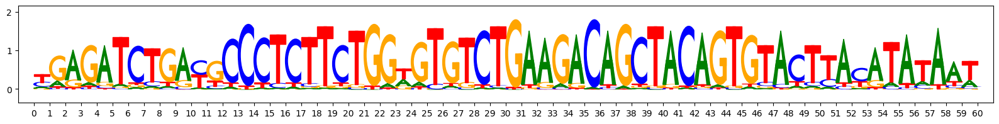

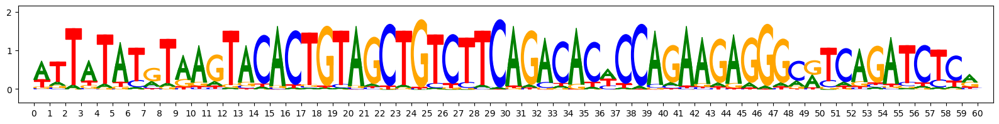

PLOTTING SUBCLUSTERS


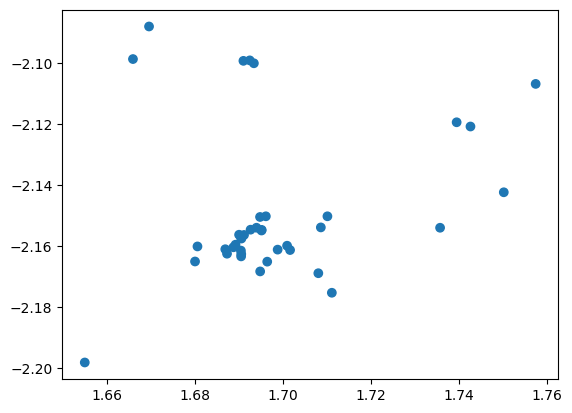

subcluster_0 size 39


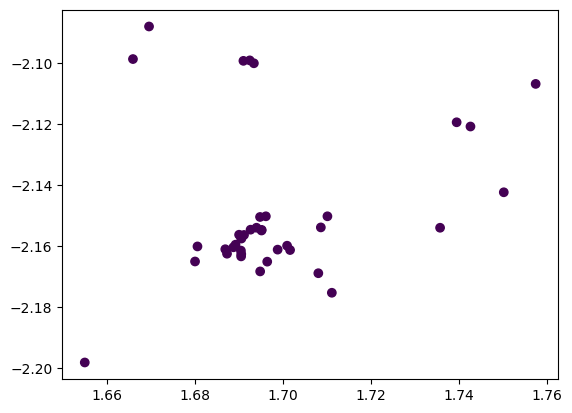

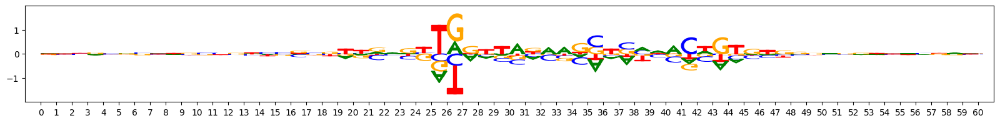

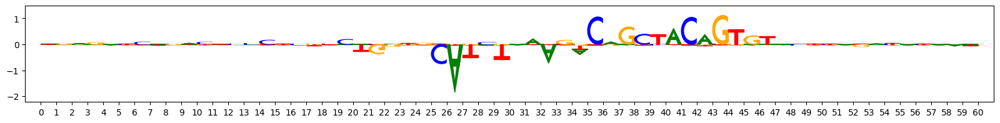

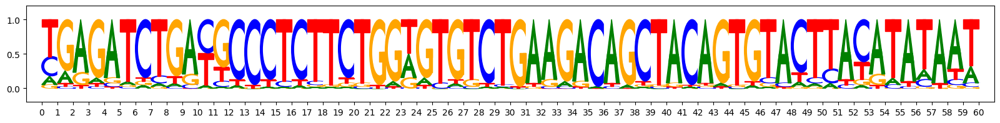

metacluster_0 pattern_10
total seqlets: 37
Task 1 hypothetical scores:


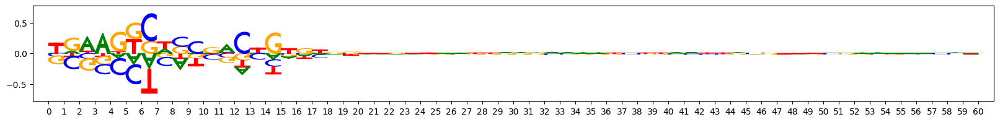

Task 1 actual importance scores:


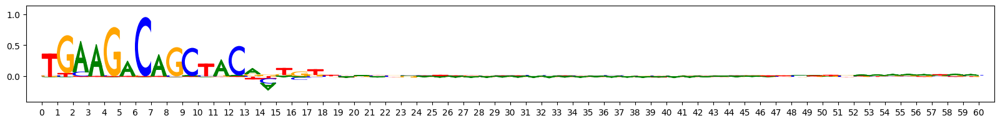

onehot, fwd and rev:


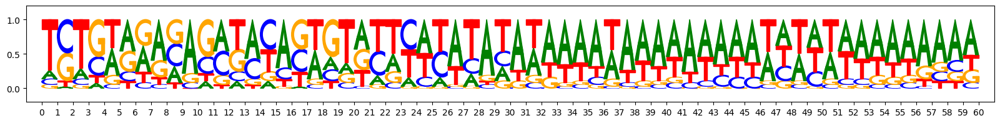

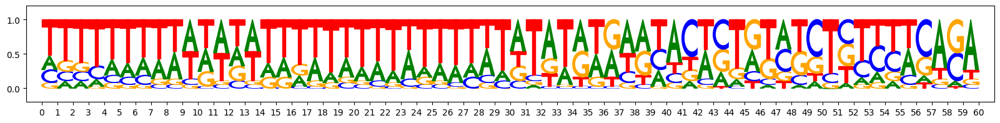

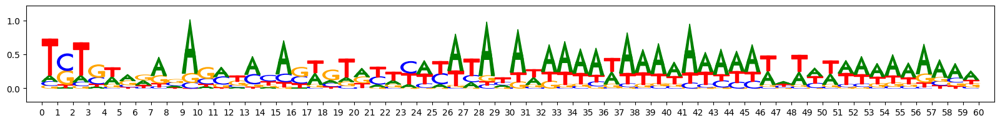

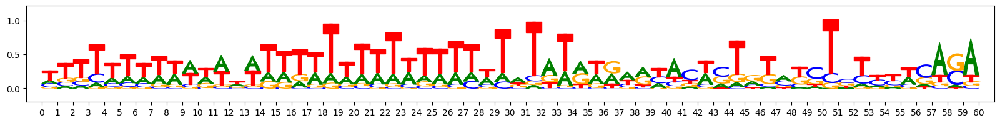

PLOTTING SUBCLUSTERS


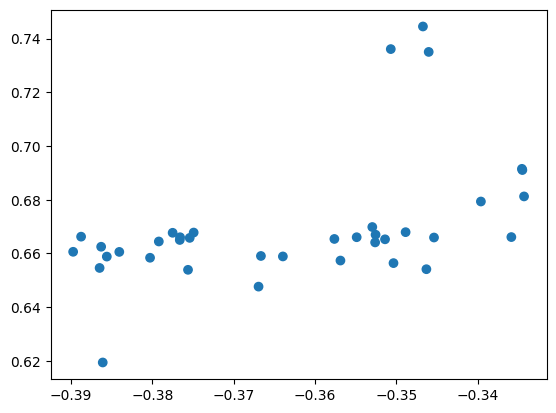

subcluster_0 size 37


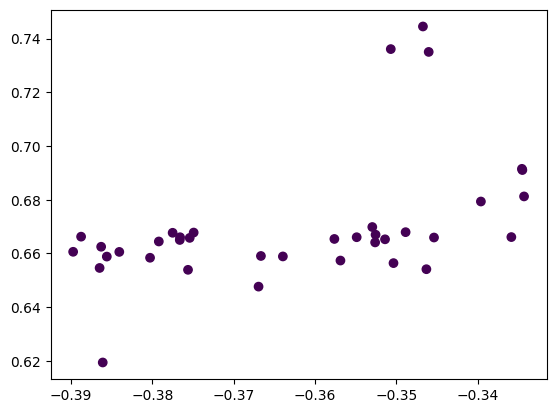

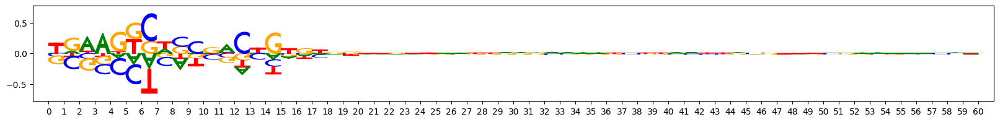

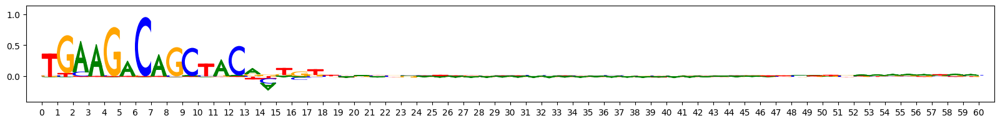

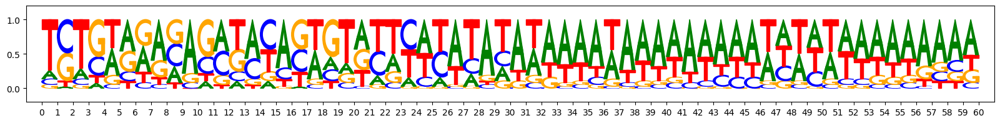

metacluster_0 pattern_11
total seqlets: 28
Task 1 hypothetical scores:


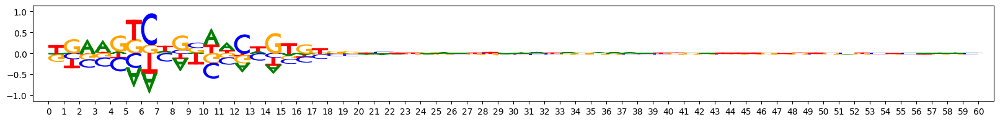

Task 1 actual importance scores:


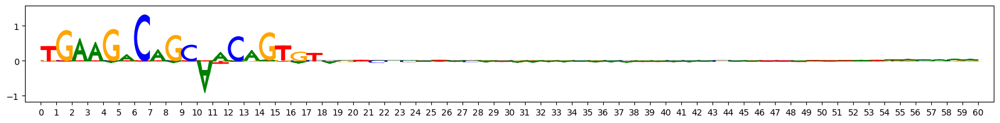

onehot, fwd and rev:


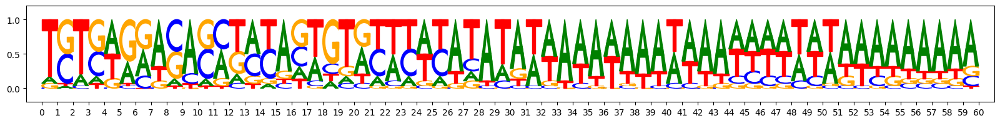

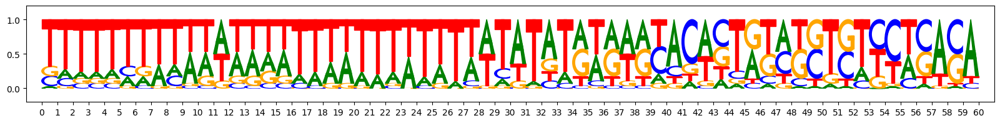

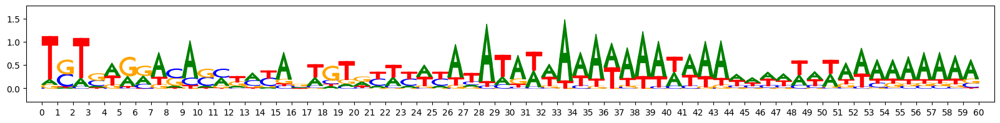

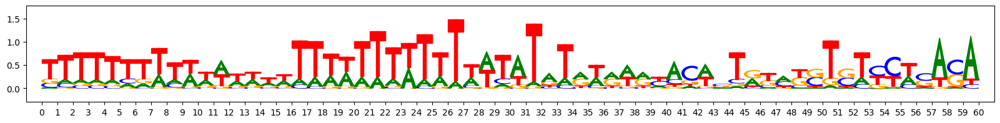

PLOTTING SUBCLUSTERS


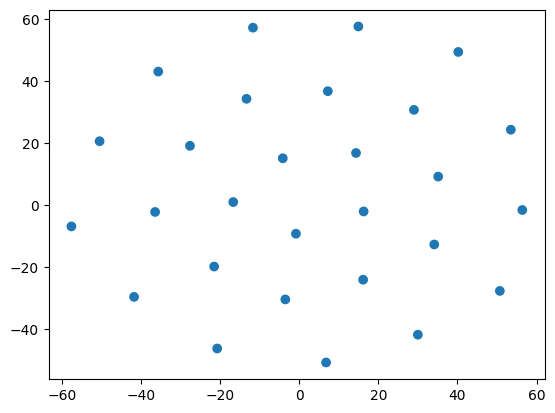

subcluster_0 size 28


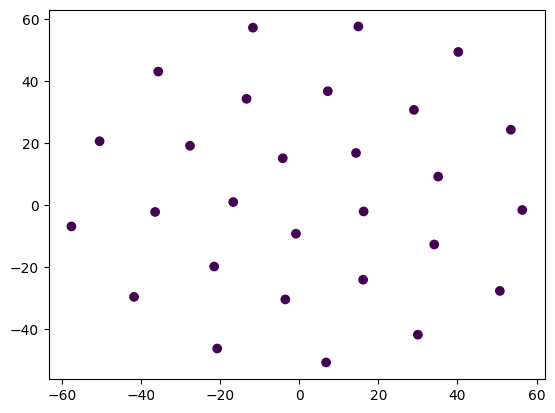

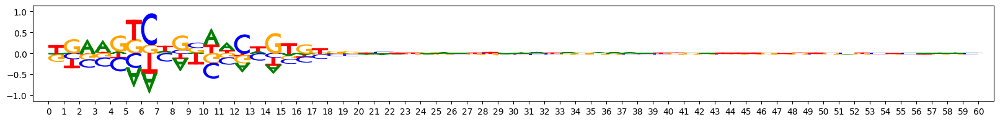

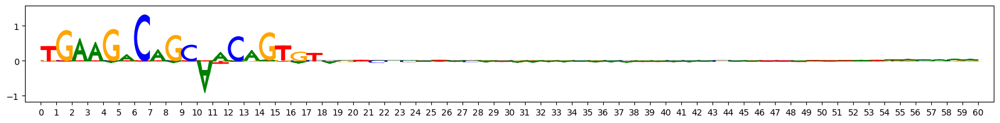

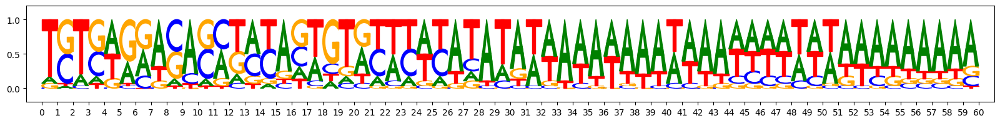

metacluster_0 pattern_12
total seqlets: 33
Task 1 hypothetical scores:


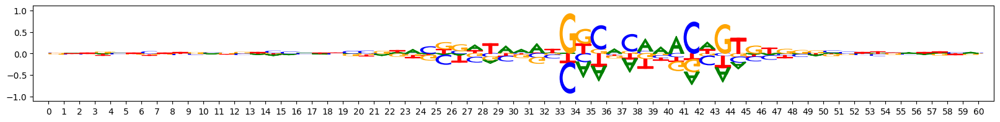

Task 1 actual importance scores:


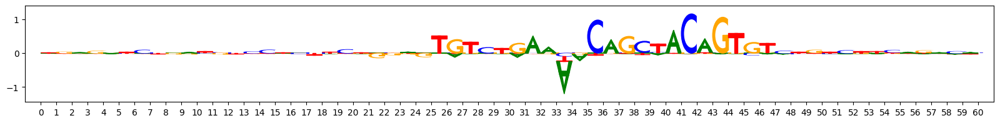

onehot, fwd and rev:


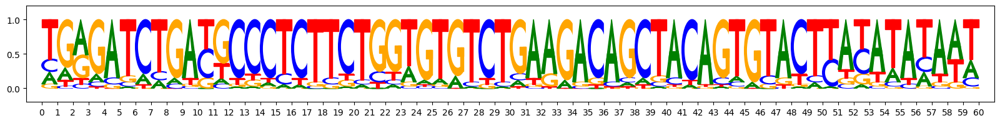

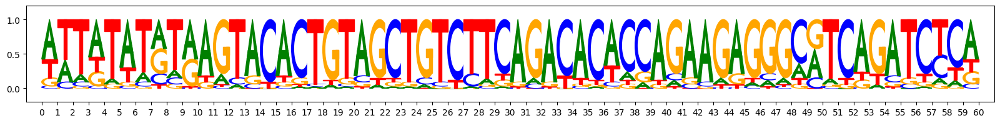

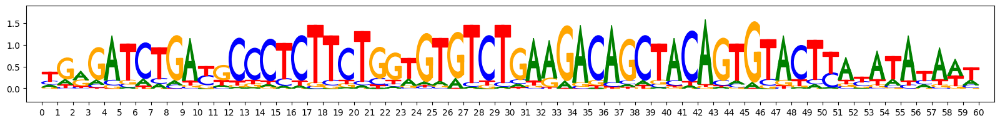

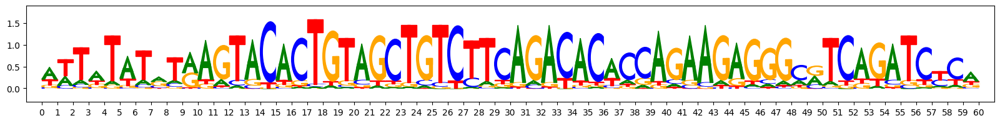

PLOTTING SUBCLUSTERS


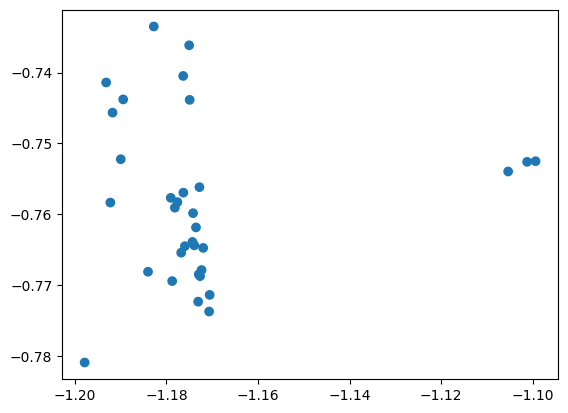

subcluster_0 size 33


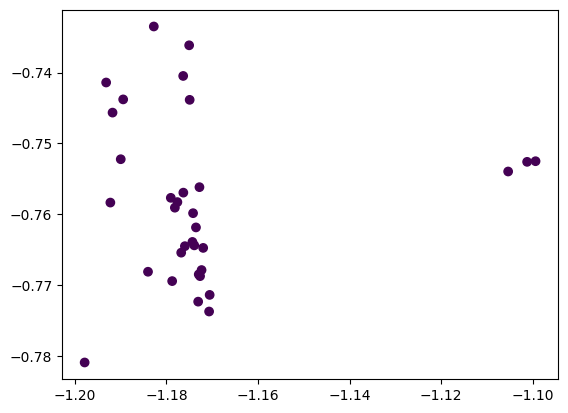

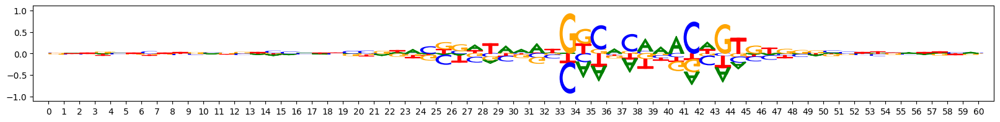

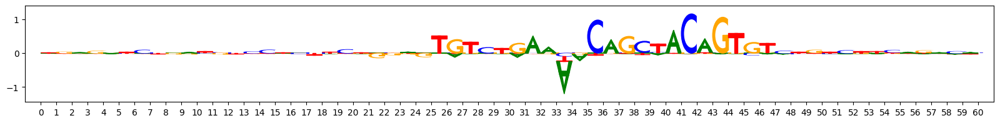

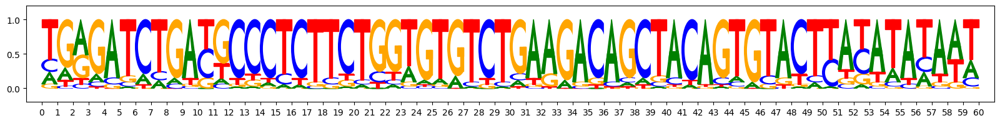

metacluster_0 pattern_13
total seqlets: 32
Task 1 hypothetical scores:


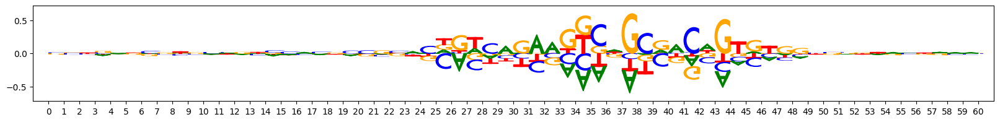

Task 1 actual importance scores:


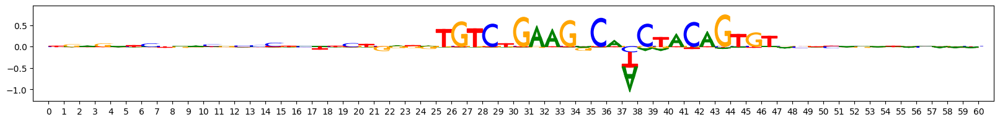

onehot, fwd and rev:


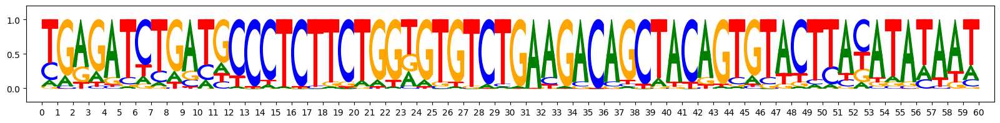

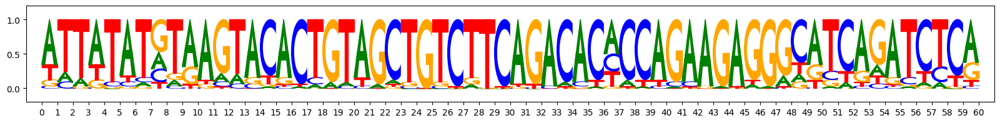

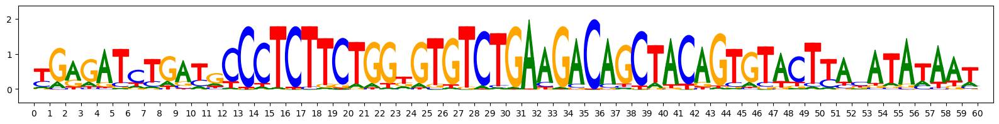

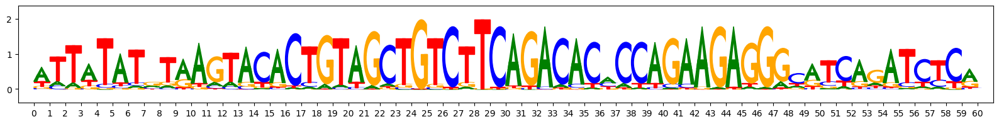

PLOTTING SUBCLUSTERS


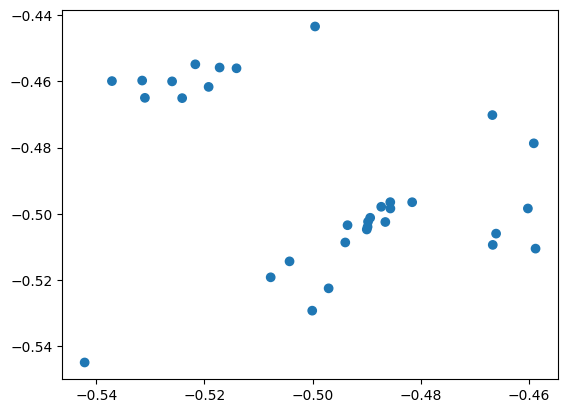

subcluster_0 size 32


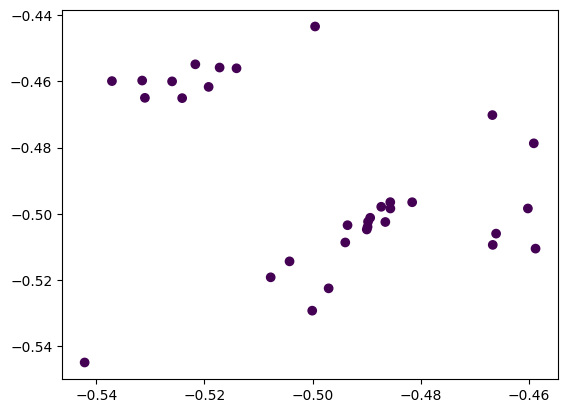

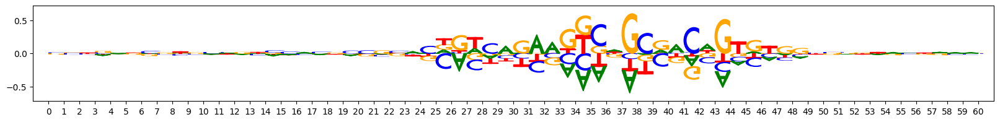

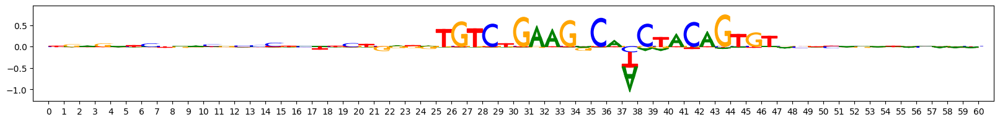

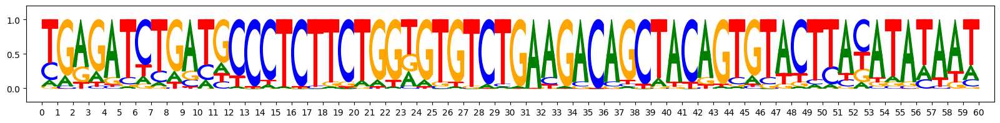

In [91]:
hdf5_results = h5py.File(f"../tf_modisco/data/{b2_family}_results_trial.hdf5","r")

print("Metaclusters heatmap")
activity_patterns = np.array(hdf5_results['metaclustering_results']['attribute_vectors'])[
                    np.array(
        [x[0] for x in sorted(
                enumerate(hdf5_results['metaclustering_results']['metacluster_indices']),
               key=lambda x: x[1])])]
sns.heatmap(activity_patterns, center=0)
plt.show()

metacluster_names = [
    x.decode("utf-8") for x in
    list(hdf5_results["metaclustering_results"]
         ["all_metacluster_names"][:])]

all_patterns = []
background = np.mean(input_data, axis=(0,1))
metacluster_names = ["metacluster_0"]
for metacluster_name in metacluster_names:
    print(metacluster_name)
    metacluster_grp = (hdf5_results["metacluster_idx_to_submetacluster_results"]
                                   [metacluster_name])
    print("activity pattern:",metacluster_grp["activity_pattern"][:])
    all_pattern_names = [x.decode("utf-8") for x in
                         list(metacluster_grp["seqlets_to_patterns_result"]
                                             ["patterns"]["all_pattern_names"][:])]
    if (len(all_pattern_names)==0):
        print("No motifs found for this activity pattern")
    for pattern_name in all_pattern_names:
        print(metacluster_name, pattern_name)
        all_patterns.append((metacluster_name, pattern_name))
        pattern = metacluster_grp["seqlets_to_patterns_result"]["patterns"][pattern_name]
        print("total seqlets:",len(pattern["seqlets_and_alnmts"]["seqlets"]))
        print(f"Task {targets[0]} hypothetical scores:")
        viz_sequence.plot_weights(pattern[f"task{targets[0]}_hypothetical_contribs"]["fwd"])
        print(f"Task {targets[0]} actual importance scores:")
        viz_sequence.plot_weights(pattern[f"task{targets[0]}_contrib_scores"]["fwd"])
        print("onehot, fwd and rev:")
        viz_sequence.plot_weights(pattern["sequence"]["fwd"])
        viz_sequence.plot_weights(pattern["sequence"]["rev"])
        viz_sequence.plot_weights(viz_sequence.ic_scale(np.array(pattern["sequence"]["fwd"]),
                                                        background=background))
        viz_sequence.plot_weights(viz_sequence.ic_scale(np.array(pattern["sequence"]["rev"]),
                                                        background=background))
        #Plot the subclustering too, if available
        if ("subclusters" in pattern):
            print("PLOTTING SUBCLUSTERS")
            subclusters = np.array(pattern["subclusters"])
            twod_embedding = np.array(pattern["twod_embedding"])
            plt.scatter(twod_embedding[:,0], twod_embedding[:,1], c=subclusters, cmap="tab20")
            plt.show()
            for subcluster_name in list(pattern["subcluster_to_subpattern"]["subcluster_names"]):
                subpattern = pattern["subcluster_to_subpattern"][subcluster_name]
                print(subcluster_name.decode("utf-8"), "size", len(subpattern["seqlets_and_alnmts"]["seqlets"]))
                subcluster = int(subcluster_name.decode("utf-8").split("_")[1])
                plt.scatter(twod_embedding[:,0], twod_embedding[:,1], c=(subclusters==subcluster))
                plt.show()
                viz_sequence.plot_weights(subpattern[f"task{targets[0]}_hypothetical_contribs"]["fwd"])
                viz_sequence.plot_weights(subpattern[f"task{targets[0]}_contrib_scores"]["fwd"])
                viz_sequence.plot_weights(subpattern["sequence"]["fwd"])

hdf5_results.close()

In [92]:
track_set = modisco.tfmodisco_workflow.workflow.prep_track_set(
                task_names=[f"task{targets[0]}"],
                contrib_scores=task_to_scores,
                hypothetical_contribs=task_to_hyp_scores,
                one_hot=input_data)

grp = h5py.File(f"../tf_modisco/data/{b2_family}_results_trial.hdf5","r")
loaded_tfmodisco_results = workflow.TfModiscoResults.from_hdf5(grp, track_set=track_set)
grp.close()

In [93]:
def recursive_plot_hierarchy_motifs(nodes, path):
    #0 - A, 1 - C, 2 - G, 3 - T
    # Define custom colors for nucleotides
    custom_color_scheme = {
        0: "#CD0101",  # Red
        1: "#0101CD",  # Blue
        2: "#FEB402",  # Yellow
        3: "#038101"   # Green
    }
    num_seqlets_best = 0
    nodepath_save = ""
    for i in range(len(nodes)):
        num_seqlets = len(nodes[i].pattern.seqlets)
        if num_seqlets > num_seqlets_best:
            nodepath_tmp = path+"/"+str(i)
            if nodepath_tmp.count("/") == 1:
                nodepath_save = nodepath_tmp
                num_seqlets_best = num_seqlets
            
    for i in range(len(nodes)):
        nodepath = path+"/"+str(i)
        print("Path to node:",nodepath)
        print("Number of seqlets",len(nodes[i].pattern.seqlets))
        if (nodes[i].indices_merged is not None):
            #indices_merged, submat_crosscontam and submat_alignersim can
            # be used to inspect the steps in the merging
            #print("indices merged:",nodes[i].indices_merged)
            #print("submat crosscontam:\n",nodes[i].submat_crosscontam)
            #print("submat alignersim:\n",nodes[i].submat_alignersim)
            pass

        if nodepath == nodepath_save:
            #For plotting figures to a png, this code can be used...
            fig = plt.figure(figsize=(20,2.5))
            ax = fig.add_subplot(111)
            # Remove box around the plot
            for spine in ['top', 'right']:
                ax.spines[spine].set_visible(False)
            # Thicken axes lines
            for spine in ['left', 'bottom']:
                ax.spines[spine].set_linewidth(2)
            # Adjust tick marks
            ax.tick_params(axis='both', which='major', length=10, width=2)  # Major ticks
            # Increase text size for tick labels
            ax.tick_params(axis='both', labelsize=14)
            viz_sequence.plot_weights_given_ax(ax, nodes[i].pattern[f"task{targets[0]}_contrib_scores"].fwd, 
                                               colors=custom_color_scheme,
                                              ylabel="Contribution score")
            plt.savefig(f"../tf_modisco/figures/{b2_family}_contribution_scores.png", bbox_inches="tight")
            print(f"Saved figure at nodepath {nodepath_save}!")

        viz_sequence.plot_weights(nodes[i].pattern["sequence"].fwd)
        viz_sequence.plot_weights(nodes[i].pattern[f"task{targets[0]}_contrib_scores"].fwd)
        viz_sequence.plot_weights(nodes[i].pattern[f"task{targets[0]}_hypothetical_contribs"].fwd)
        recursive_plot_hierarchy_motifs(nodes[i].child_nodes, path=nodepath)

In [94]:
def hit_scoring(input_data, metacluster="metacluster_0"):
    #Conduct hit scoring
    orig_patterns = (loaded_tfmodisco_results.metacluster_idx_to_submetacluster_results[metacluster]
                    .seqlets_to_patterns_result.patterns)
    
    #The hit-scorer works in two stages:
    # (1) Identifying regions of high importance ("seqlets")
    # (2) Mapping those seqlets to patterns (motifs)
    #(The two stages are independent of each other)
    #instantiate the hit_scorer by providing the patterns
    # that identified seqlets will be mapped to. The patterns
    # will be trimmed to target_seqlet_size
    hit_scorer = densityadapted_hitscoring.MakeHitScorer(
        patterns=orig_patterns,
        target_seqlet_size=35,
        bg_freq=np.mean(input_data, axis=(0,1)),
        task_names_and_signs=[(f"task{targets[0]}",1)],
        n_cores=22)
    
    #set the method used to identify coordinates of high importance ("seqlets")
    #You have to provide a contribution score track as this will be used
    # to calibrate the threshold used for seqlet identification. You
    # can also optionally provide an empirical null distribution track via
    # the 'null_track' argument, similar to when tf-modisco is first run.
    hit_scorer.set_coordproducer(contrib_scores=task_to_scores,
                                 core_sliding_window_size=7,
                                 target_fdr=0.2,
                                 min_passing_windows_frac=0.03,
                                 max_passing_windows_frac=0.2,
                                 separate_pos_neg_thresholds=False,
                                 max_seqlets_total=np.inf)
    #Now that the hit-scorer is configured, you can call it on some data to
    # get the motif hit calls.
    #Note that the values provided to contrib_scores below DO NOT have to be
    # the same as the values provided to set_coordproducer above.
    #I recommend running this on a small number of regions first to get a feel
    # for the runtime; we're still working on improving the runtime here.
    (exampleidx_to_matches, patternidx_to_matches) = hit_scorer(
               contrib_scores=task_to_scores,
               hypothetical_contribs=task_to_hyp_scores,
               one_hot=input_data,
               hits_to_return_per_seqlet=1)
    
    #Note: if you already have a list of seqlets, you can score them
    # using: hit_scorer.seqlet_scorer(seqlets,hits_to_return_per_seqlet=1);
    # this will return a 3-tuple of
    # (seqlet_matches, patternidx_to_matches, exampleidx_to_matches)
    
    contrib_scores = task_to_scores[f"task{targets[0]}"]
    
    #visualize the matches
    for exampleidx in list(sorted(exampleidx_to_matches.keys()))[:3]: #visualizing the matches in the first 10 seqs
    
        print("EXAMPLE IDX",exampleidx,"hits:")
        matches = exampleidx_to_matches[exampleidx]
    
        coords = hit_scorer.coordproducer(score_track=np.sum(contrib_scores[exampleidx], axis=-1)[None,:],
                                         tnt_results=hit_scorer.tnt_results, null_track=None).coords
        #highlight the locations of all the matches
        print("Original core seqlet locations")
        viz_sequence.plot_weights(
            contrib_scores[exampleidx],
            highlight={'black': [
                (max(x.start+hit_scorer.coordproducer.flank,0),
                 min(x.end-hit_scorer.coordproducer.flank,len(contrib_scores[exampleidx])))
                 for x in coords]},
            subticks_frequency=20)
        print("Motif matches (red = without trimming)")
        viz_sequence.plot_weights(
            contrib_scores[exampleidx],
            highlight={'red': [
                (max(x.start,0), min(x.end,len(contrib_scores[exampleidx])))
                 for x in matches],
                       'black': [
                (max(x.trim_start,0), min(x.trim_end,len(contrib_scores[exampleidx])))
                 for x in matches]},
            subticks_frequency=20)
    
        for i in range(len(orig_patterns)):
            matches_to_pattern = [x for x in matches if x.patternidx==i]
            if (len(matches_to_pattern) > 0):
                print("Matches to pattern",i,"(the original pattern looks like this:)")
                viz_sequence.plot_weights(hit_scorer.seqlet_scorer.class_patterns[i][f"task{targets[0]}_contrib_scores"].fwd)
                viz_sequence.plot_weights(hit_scorer.seqlet_scorer.class_patterns[i]["sequence"].fwd)
                print("matches in this example...")
                for match in matches_to_pattern:
                    print(match)
                    if (match.is_revcomp==False):
                        viz_sequence.plot_weights(contrib_scores[exampleidx][match.start:match.end])
                    else:
                        viz_sequence.plot_weights(contrib_scores[exampleidx][match.start:match.end][::-1,::-1])
    
    print(f"For {metacluster}")
    recursive_plot_hierarchy_motifs(loaded_tfmodisco_results
        .metacluster_idx_to_submetacluster_results[metacluster]
        .seqlets_to_patterns_result.pattern_merge_hierarchy.root_nodes,
        path="root")

## Expressed B2s

### B2_Mm1a

Getting trimmed patterns, subclustering them
Trimming the patterns to the target length
Apply subclustering
[t-SNE] Computing 127 nearest neighbors...
[t-SNE] Indexed 128 samples in 0.001s...
[t-SNE] Computed neighbors for 128 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 128 / 128
[t-SNE] Mean sigma: 0.542514
[t-SNE] Computed conditional probabilities in 0.002s
[t-SNE] Iteration 50: error = 47.5401955, gradient norm = 0.4506888 (50 iterations in 0.014s)
[t-SNE] Iteration 100: error = 51.2170982, gradient norm = 0.4103281 (50 iterations in 0.014s)
[t-SNE] Iteration 150: error = 50.3001099, gradient norm = 0.5002903 (50 iterations in 0.014s)
[t-SNE] Iteration 200: error = 50.9091225, gradient norm = 0.5882171 (50 iterations in 0.014s)
[t-SNE] Iteration 250: error = 49.6781235, gradient norm = 0.6990666 (50 iterations in 0.014s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.678123
[t-SNE] Iteration 300: error = 0.3419705, gradient nor

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done 128 out of 128 | elapsed:    0.0s finished
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_base.py:246: EfficiencyWarning: Precomputed sparse input was not sorted by row values. Use the function sklearn.neighbors.sort_graph_by_row_values to sort the input by row values, with warn_when_not_sorted=False to remove this warning.
  warnings.warn(


[t-SNE] Iteration 700: error = 0.2431555, gradient norm = 0.0002930 (50 iterations in 0.011s)
[t-SNE] Iteration 750: error = 0.2430176, gradient norm = 0.0002246 (50 iterations in 0.011s)
[t-SNE] Iteration 800: error = 0.2432226, gradient norm = 0.0001938 (50 iterations in 0.011s)
[t-SNE] Iteration 850: error = 0.2430707, gradient norm = 0.0002730 (50 iterations in 0.011s)
[t-SNE] Iteration 900: error = 0.2430850, gradient norm = 0.0001843 (50 iterations in 0.011s)
[t-SNE] Iteration 950: error = 0.2432307, gradient norm = 0.0002183 (50 iterations in 0.011s)
[t-SNE] Iteration 1000: error = 0.2431405, gradient norm = 0.0003318 (50 iterations in 0.011s)
[t-SNE] KL divergence after 1000 iterations: 0.243140
[t-SNE] Computed conditional probabilities for sample 128 / 128
[t-SNE] Mean sigma: 0.404815
Beginning preprocessing + Leiden
2025-01-23 17:09:19.211995 MEMORY 2.473156608
Affmat transformed
2025-01-23 17:09:19.213307 MEMORY 2.473156608
sources, targets, weights extracted
2025-01-23 17:

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.7s


Parallel Leiden runs finished
2025-01-23 17:09:20.837753 MEMORY 2.473156608
Quality: 0.3492949679187831


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done  68 out of 111 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done 111 out of 111 | elapsed:    0.0s finished


Got subclusters: Counter({0: 36, 1: 25, 2: 16, 3: 15, 4: 13, 6: 10, 5: 10, 7: 3})
[t-SNE] Computing 110 nearest neighbors...
[t-SNE] Indexed 111 samples in 0.001s...
[t-SNE] Computed neighbors for 111 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 111 / 111
[t-SNE] Mean sigma: 0.221762
[t-SNE] Computed conditional probabilities in 0.002s
[t-SNE] Iteration 50: error = 45.8807602, gradient norm = 0.3843366 (50 iterations in 0.011s)
[t-SNE] Iteration 100: error = 48.1969414, gradient norm = 0.4486402 (50 iterations in 0.011s)
[t-SNE] Iteration 150: error = 50.4361382, gradient norm = 0.4374841 (50 iterations in 0.011s)
[t-SNE] Iteration 200: error = 50.1706429, gradient norm = 0.3882685 (50 iterations in 0.011s)
[t-SNE] Iteration 250: error = 45.6687088, gradient norm = 0.4991220 (50 iterations in 0.011s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 45.668709
[t-SNE] Iteration 300: error = 0.1684684, gradient norm = 0.0133378 (50 iteratio

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:09:22.554844 MEMORY 2.473156608
Quality: 0.3406550635987381
Quality: 0.3463165773511148
Quality: 0.3490534355713615
Got subclusters: Counter({0: 34, 1: 31, 2: 24, 3: 22})
[t-SNE] Computing 49 nearest neighbors...
[t-SNE] Indexed 50 samples in 0.000s...
[t-SNE] Computed neighbors for 50 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 50 / 50
[t-SNE] Mean sigma: 32.809729
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 40.7884560, gradient norm = 0.3906441 (50 iterations in 0.004s)
[t-SNE] Iteration 100: error = 38.7752151, gradient norm = 0.5652019 (50 iterations in 0.004s)
[t-SNE] Iteration 150: error = 37.8656693, gradient norm = 0.5578033 (50 iterations in 0.004s)
[t-SNE] Iteration 200: error = 37.6923637, gradient norm = 0.6578270 (50 iterations in 0.004s)
[t-SNE] Iteration 250: error = 43.3983421, gradient norm = 0.4425552 (50 iterations in 0.004s)
[t-SNE] KL divergence after 2

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.5s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:09:24.099140 MEMORY 2.473156608
Quality: -8.881784197001154e-16
Got subclusters: Counter({0: 50})
Preparing seqlet scorer
Pattern length (and hence target seqlet size) is 35
Prepare seqlet scorer
Computing best alignments for all motifseqlets
Launching nearest neighbors affmat calculation job
MEMORY 2.473156608
Parallel runs completed
MEMORY 2.473353216


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.5s finished


Job completed in: 0.19 s
MEMORY 2.427498496
Launching nearest neighbors affmat calculation job
MEMORY 2.427498496
Parallel runs completed
MEMORY 2.427498496
Job completed in: 0.16 s
MEMORY 2.427498496
On seqlets 0 to 289 out of 289


100%|████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:00<00:00, 26.06it/s]


0 seqlets out of 289 did not have themselves in their nearest neighbs, likelydue to alignment issues
Insantiating a precision scorer based on fann_perclasssum
Accuracy: 0.9930795847750865
Insantiating a precision scorer based on fann_perclassavg
Accuracy: 1.0
Launching nearest neighbors affmat calculation job
MEMORY 2.427498496


/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in ver

Parallel runs completed
MEMORY 2.427891712
Job completed in: 0.53 s
MEMORY 2.427891712
Launching nearest neighbors affmat calculation job
MEMORY 2.427891712
Parallel runs completed
MEMORY 2.42808832
Job completed in: 0.52 s
MEMORY 2.42808832
On seqlets 0 to 289 out of 289


100%|█████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 226.27it/s]

Insantiating a precision scorer based on aggregate sim
Accuracy: 0.8961937716262975
Mapping affinity to distmat
Symmetrizing nearest neighbors
Computing betas for density adaptation
Computing normalizing denominators
Computing density-adapted nn affmat



/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(


Beginning preprocessing + Leiden
2025-01-23 17:09:26.392733 MEMORY 2.42808832
sources, targets, weights extracted
2025-01-23 17:09:26.394644 MEMORY 2.42808832
initclusters length: 289
About to launch parallel Leiden runs
2025-01-23 17:09:26.395880 MEMORY 2.42808832


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.7s


Parallel Leiden runs finished
2025-01-23 17:09:28.315999 MEMORY 2.42808832
Quality: 0.19216955879380201
Quality: 0.1921695587938074
Quality: 0.1921695587938082
Number of reclustered idxs: 3
{(1, 1), (2, 2), (0, 0)}
Preparing modularity scorer
Accuracy: 1.0
Computing windowed sums on original


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.9s finished
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(


Generating null dist
peak(mu)= 0.0039174300432205204
Computing threshold
Subsampling!
For increasing = True , the minimum IR precision was 0.3454970050223376 occurring at 4.76837158203125e-07 implying a frac_neg of 0.5278768892938819
To be conservative, adjusted frac neg is 0.95
For increasing = False , the minimum IR precision was 0.15703630566202162 occurring at -1.341104507446289e-07 implying a frac_neg of 0.18629071064009478
To be conservative, adjusted frac neg is 0.95
Thresholds from null dist were -0.7764694392681122  and  1.4496560096740723 with frac passing 0.022427
Passing windows frac was 0.022427 , which is below  0.03 ; adjusting
Final raw thresholds are -1.0355948337912562  and  1.0355948337912562
Final transformed thresholds are -0.9699848527063356  and  0.9699848527063356


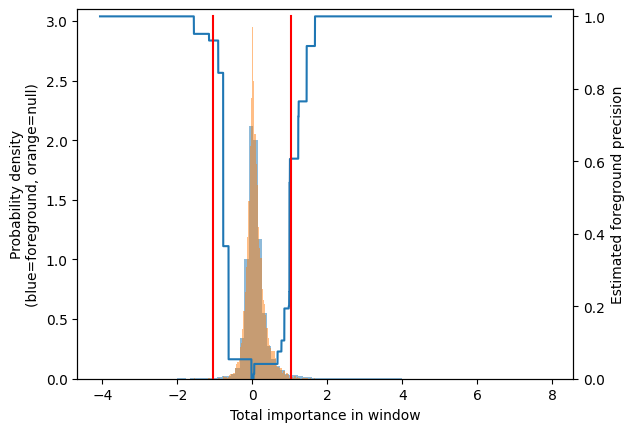

Only returning positive coords!
Got 9091 coords
Computing windowed sums on original
Only returning positive coords!
Got 9091 coords
Launching nearest neighbors affmat calculation job
MEMORY 2.48039424
Parallel runs completed
MEMORY 2.480787456
Job completed in: 13.87 s
MEMORY 2.480574464
Launching nearest neighbors affmat calculation job
MEMORY 2.480574464
Parallel runs completed
MEMORY 2.480574464
Job completed in: 14.43 s
MEMORY 2.480574464
On seqlets 0 to 5000 out of 9091


100%|████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:06<00:00,  2.06it/s]

On seqlets 5000 to 9091 out of 9091



100%|████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:05<00:00,  2.52it/s]


Launching nearest neighbors affmat calculation job
MEMORY 2.496888832
Parallel runs completed
MEMORY 2.497282048
Job completed in: 13.38 s
MEMORY 2.497282048
Launching nearest neighbors affmat calculation job
MEMORY 2.497073152
Parallel runs completed
MEMORY 2.49726976
Job completed in: 13.31 s
MEMORY 2.49726976
On seqlets 0 to 5000 out of 9091


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00,  6.44it/s]

On seqlets 5000 to 9091 out of 9091



100%|██████████████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00,  8.23it/s]


Removed 1415 duplicates
EXAMPLE IDX 2 hits:
Computing windowed sums on original
Only returning positive coords!
Got 2 coords
Original core seqlet locations


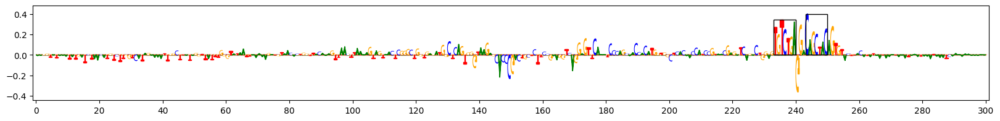

Motif matches (red = without trimming)


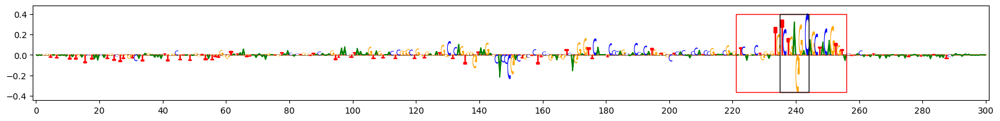

Matches to pattern 1 (the original pattern looks like this:)


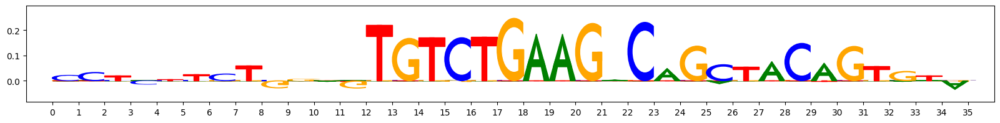

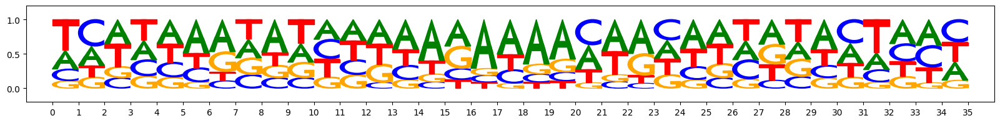

matches in this example...
MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=3.9691644, exampleidx=2, start=221, end=256, trim_start=235, trim_end=244, is_revcomp=False, seqlet_orig_start=219, seqlet_orig_end=254, seqlet_orig_revcomp=False, aggregate_sim=0.524771954091516, mod_delta=0.0006230521484309401, mod_precision=0.5924323453279958, mod_percentile=0.0, fann_perclasssum_perc=0.0, fann_perclassavg_perc=0.0)


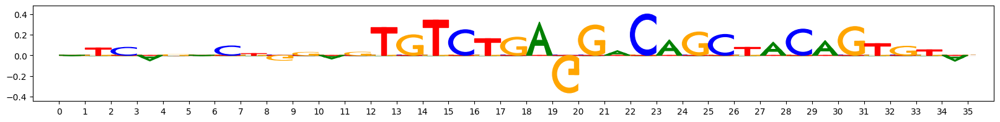

EXAMPLE IDX 5 hits:
Computing windowed sums on original
Only returning positive coords!
Got 1 coords
Original core seqlet locations


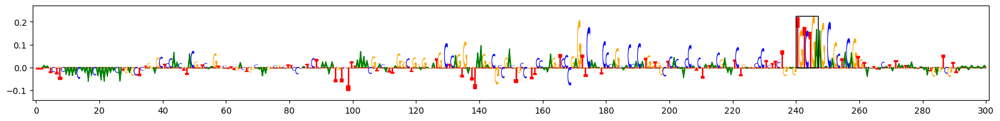

Motif matches (red = without trimming)


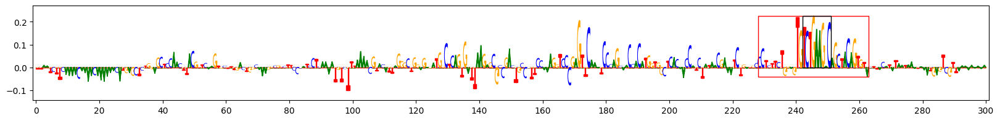

Matches to pattern 1 (the original pattern looks like this:)


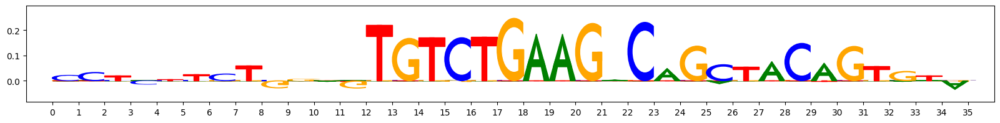

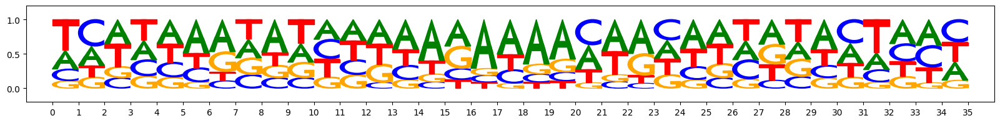

matches in this example...
MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=2.7635117, exampleidx=5, start=228, end=263, trim_start=242, trim_end=251, is_revcomp=False, seqlet_orig_start=226, seqlet_orig_end=261, seqlet_orig_revcomp=False, aggregate_sim=0.8155744103255563, mod_delta=0.0004452638014712457, mod_precision=0.317609714690663, mod_percentile=0.0, fann_perclasssum_perc=0.3873873873873874, fann_perclassavg_perc=0.36036036036036034)


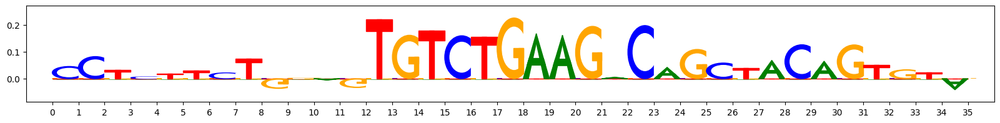

EXAMPLE IDX 7 hits:
Computing windowed sums on original
Only returning positive coords!
Got 1 coords
Original core seqlet locations


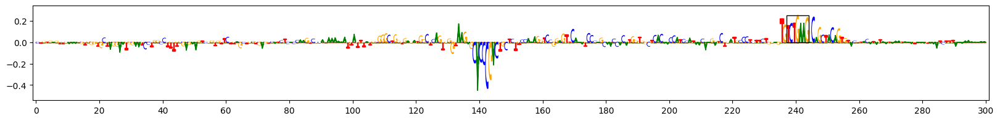

Motif matches (red = without trimming)


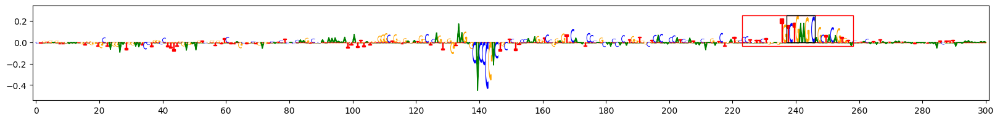

Matches to pattern 1 (the original pattern looks like this:)


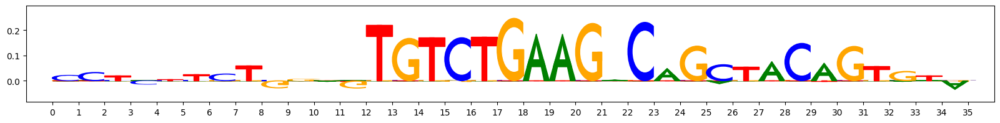

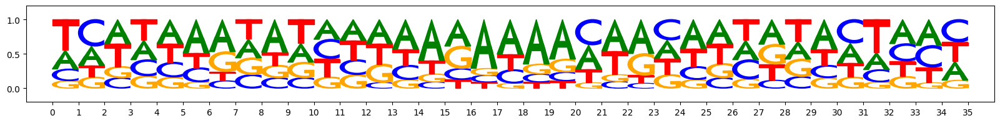

matches in this example...
MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=2.956987, exampleidx=7, start=223, end=258, trim_start=237, trim_end=246, is_revcomp=False, seqlet_orig_start=223, seqlet_orig_end=258, seqlet_orig_revcomp=False, aggregate_sim=0.88675432716556, mod_delta=0.0003252525532865492, mod_precision=0.13209807966958217, mod_percentile=0.0, fann_perclasssum_perc=0.9279279279279279, fann_perclassavg_perc=0.8558558558558559)


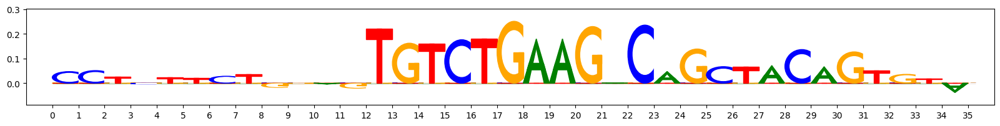

For metacluster_0
Path to node: root/0
Number of seqlets 128
Saved figure at nodepath root/0!


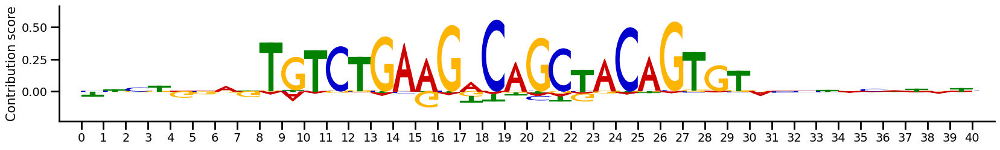

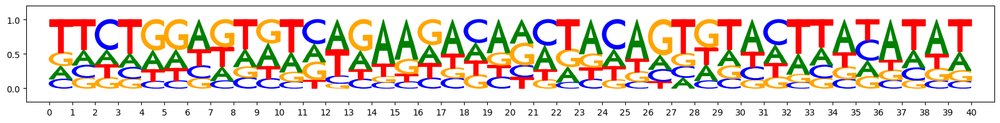

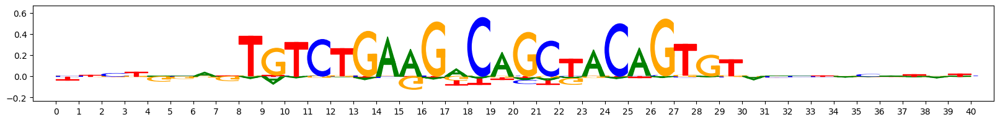

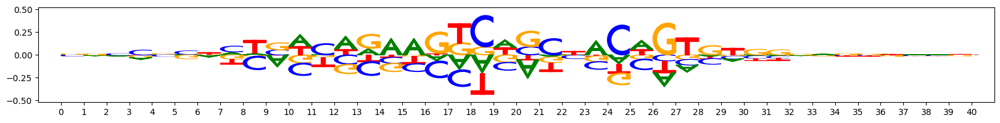

Path to node: root/0/0
Number of seqlets 72


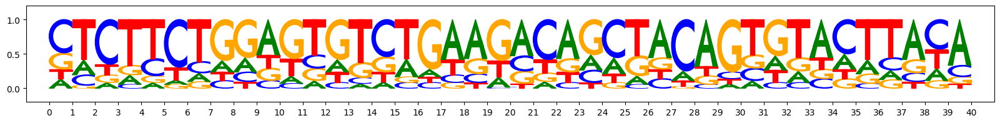

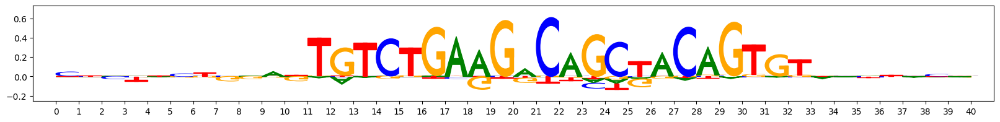

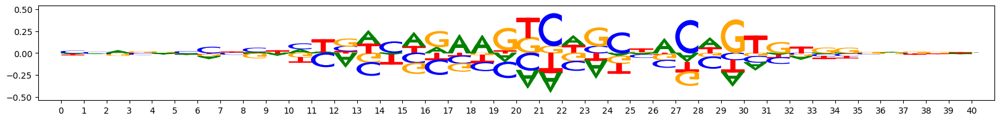

Path to node: root/0/1
Number of seqlets 56


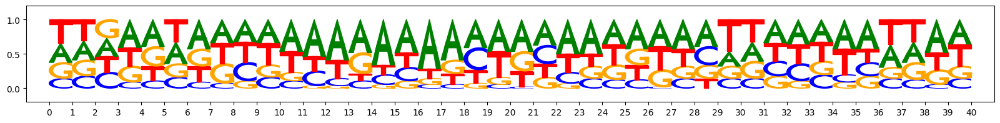

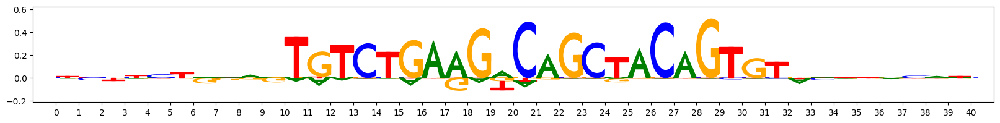

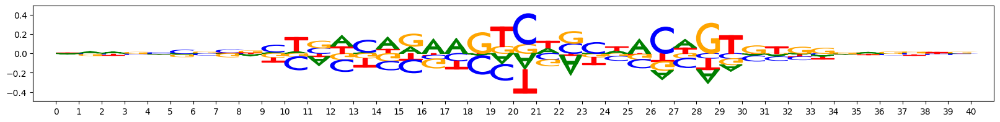

Path to node: root/1
Number of seqlets 111


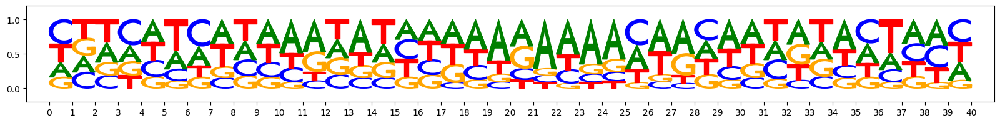

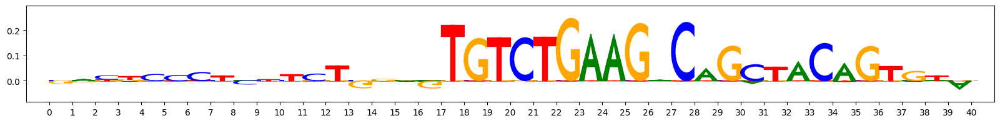

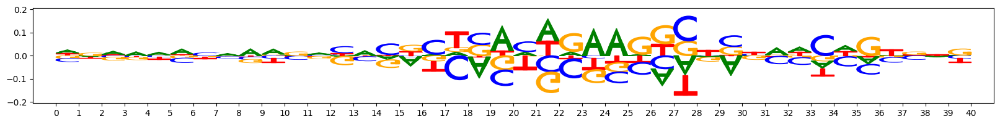

Path to node: root/2
Number of seqlets 50


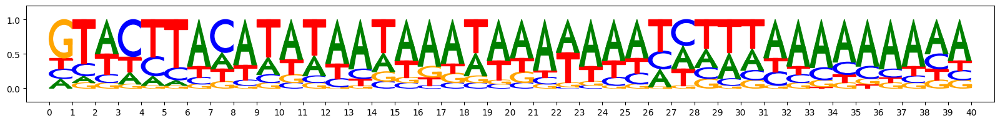

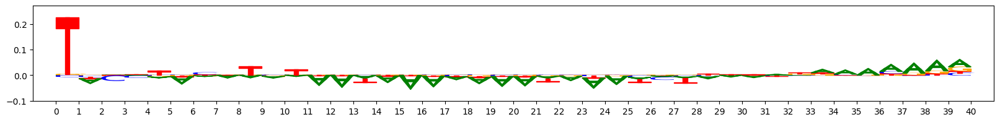

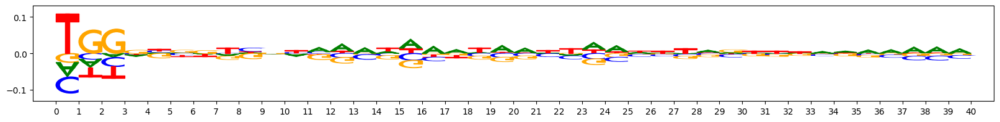

Path to node: root/3
Number of seqlets 25


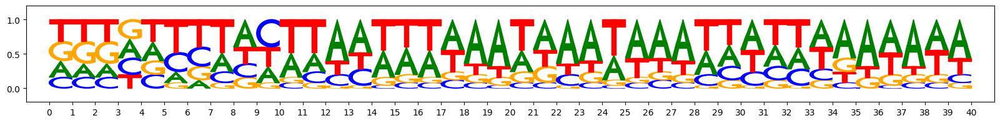

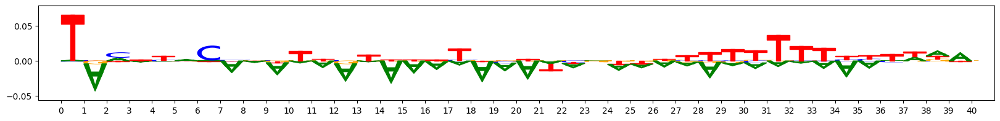

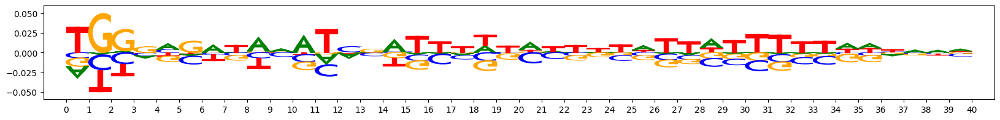

Path to node: root/4
Number of seqlets 25


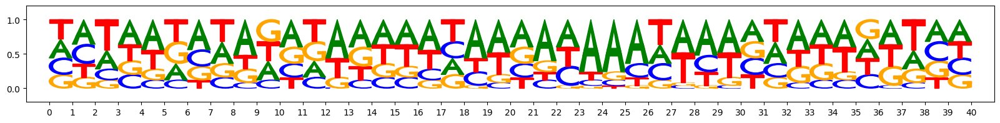

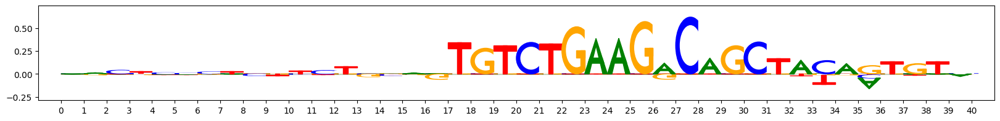

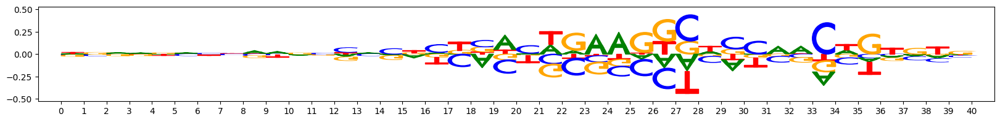

Path to node: root/5
Number of seqlets 21


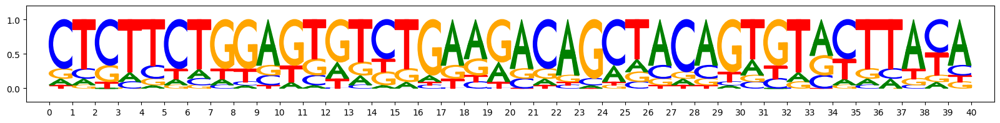

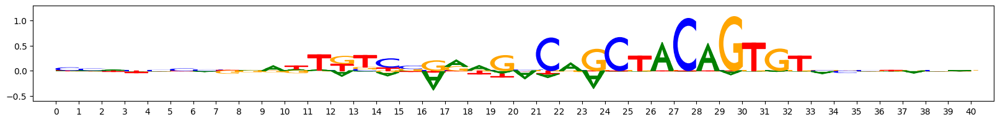

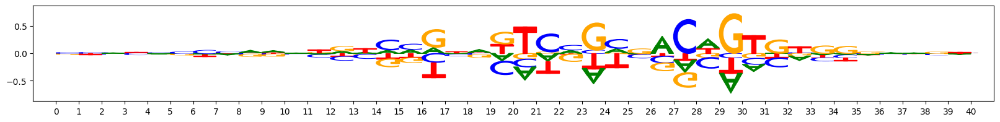

Path to node: root/6
Number of seqlets 18


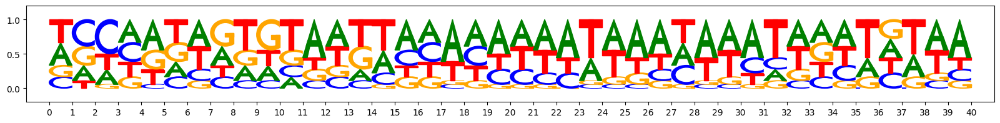

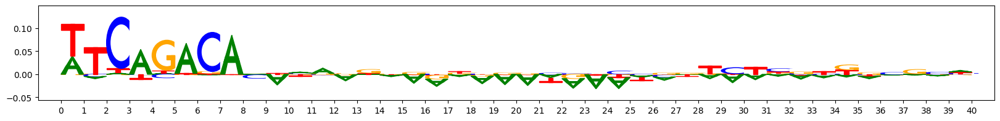

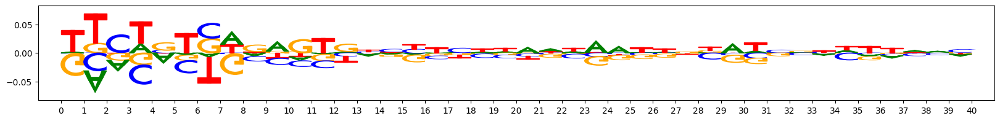

Path to node: root/7
Number of seqlets 8


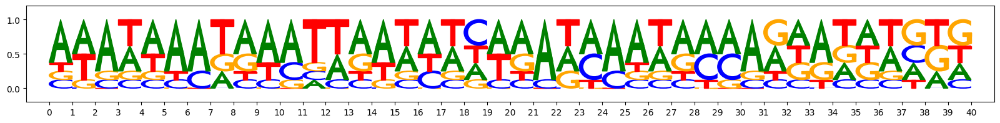

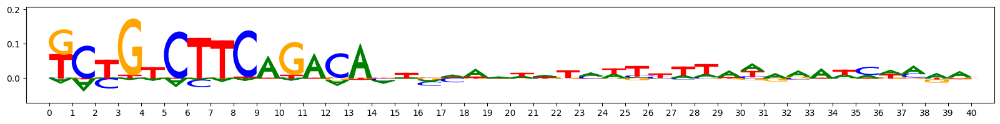

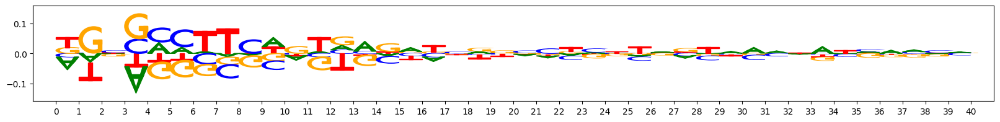

In [38]:
#Label=1
hit_scoring(input_data, metacluster="metacluster_0")

### B2 _Mm1t

Getting trimmed patterns, subclustering them
Trimming the patterns to the target length
Apply subclustering
[t-SNE] Computing 139 nearest neighbors...
[t-SNE] Indexed 140 samples in 0.001s...
[t-SNE] Computed neighbors for 140 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 140 / 140
[t-SNE] Mean sigma: 1.024627
[t-SNE] Computed conditional probabilities in 0.002s
[t-SNE] Iteration 50: error = 48.0560226, gradient norm = 0.3835937 (50 iterations in 0.016s)
[t-SNE] Iteration 100: error = 49.0780945, gradient norm = 0.3778246 (50 iterations in 0.017s)
[t-SNE] Iteration 150: error = 50.1046562, gradient norm = 0.4025113 (50 iterations in 0.016s)
[t-SNE] Iteration 200: error = 54.4199982, gradient norm = 0.3037275 (50 iterations in 0.016s)
[t-SNE] Iteration 250: error = 50.7654037, gradient norm = 0.4219185 (50 iterations in 0.016s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.765404
[t-SNE] Iteration 300: error = 0.4349458, gradient nor

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done 140 out of 140 | elapsed:    0.0s finished
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_base.py:246: EfficiencyWarning: Precomputed sparse input was not sorted by row values. Use the function sklearn.neighbors.sort_graph_by_row_values to sort the input by row values, with warn_when_not_sorted=False to remove this warning.
  warnings.warn(


[t-SNE] Iteration 600: error = 0.3675090, gradient norm = 0.0002837 (50 iterations in 0.013s)
[t-SNE] Iteration 650: error = 0.3675814, gradient norm = 0.0001930 (50 iterations in 0.013s)
[t-SNE] Iteration 700: error = 0.3675595, gradient norm = 0.0002847 (50 iterations in 0.013s)
[t-SNE] Iteration 750: error = 0.3675631, gradient norm = 0.0001826 (50 iterations in 0.013s)
[t-SNE] Iteration 750: did not make any progress during the last 300 episodes. Finished.
[t-SNE] KL divergence after 750 iterations: 0.367563
[t-SNE] Computed conditional probabilities for sample 140 / 140
[t-SNE] Mean sigma: 0.506357
Beginning preprocessing + Leiden
2025-01-23 17:16:06.352247 MEMORY 2.58265088
Affmat transformed
2025-01-23 17:16:06.353693 MEMORY 2.58265088
sources, targets, weights extracted
2025-01-23 17:16:06.354313 MEMORY 2.58265088
About to launch parallel Leiden runs
2025-01-23 17:16:06.354983 MEMORY 2.58265088


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.7s


Parallel Leiden runs finished
2025-01-23 17:16:08.079059 MEMORY 2.58265088
Quality: 0.3109036959739163
Quality: 0.3114570512218716
Quality: 0.3116492936400549
Got subclusters: Counter({0: 57, 1: 26, 2: 24, 3: 19, 4: 14})
[t-SNE] Computing 60 nearest neighbors...
[t-SNE] Indexed 61 samples in 0.000s...
[t-SNE] Computed neighbors for 61 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 61 / 61
[t-SNE] Mean sigma: 4.483569
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 41.8330498, gradient norm = 0.4610814 (50 iterations in 0.005s)
[t-SNE] Iteration 100: error = 39.8925514, gradient norm = 0.6057050 (50 iterations in 0.005s)
[t-SNE] Iteration 150: error = 40.7607002, gradient norm = 0.3914618 (50 iterations in 0.005s)
[t-SNE] Iteration 200: error = 41.3585167, gradient norm = 0.5257022 (50 iterations in 0.005s)
[t-SNE] Iteration 250: error = 39.6773872, gradient norm = 0.7377611 (50 iterations in 0.005s)
[t-SNE] KL divergence af

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.7s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done  61 out of  61 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:16:09.709576 MEMORY 2.58265088
Quality: 0.08418346868542098
Quality: 0.08439152826342108
Got subclusters: Counter({0: 41, 1: 20})
Preparing seqlet scorer
Pattern length (and hence target seqlet size) is 35
Prepare seqlet scorer
Computing best alignments for all motifseqlets
Launching nearest neighbors affmat calculation job
MEMORY 2.58265088
Parallel runs completed
MEMORY 2.582847488
Job completed in: 0.16 s
MEMORY 2.543132672
Launching nearest neighbors affmat calculation job
MEMORY 2.543132672
Parallel runs completed
MEMORY 2.54332928


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.5s finished


Job completed in: 0.14 s
MEMORY 2.54332928
On seqlets 0 to 201 out of 201


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:00<00:00, 32.95it/s]

0 seqlets out of 201 did not have themselves in their nearest neighbs, likelydue to alignment issues
Insantiating a precision scorer based on fann_perclasssum
Accuracy: 0.7263681592039801
Insantiating a precision scorer based on fann_perclassavg
Accuracy: 0.900497512437811
Launching nearest neighbors affmat calculation job
MEMORY 2.54332928



/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(


Parallel runs completed
MEMORY 2.54332928
Job completed in: 0.41 s
MEMORY 2.54332928
Launching nearest neighbors affmat calculation job
MEMORY 2.54332928
Parallel runs completed
MEMORY 2.543919104
Job completed in: 0.4 s
MEMORY 2.543919104
On seqlets 0 to 201 out of 201


100%|█████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 305.60it/s]

Insantiating a precision scorer based on aggregate sim
Accuracy: 0.6069651741293532
Mapping affinity to distmat
Symmetrizing nearest neighbors
Computing betas for density adaptation
Computing normalizing denominators
Computing density-adapted nn affmat
Beginning preprocessing + Leiden
2025-01-23 17:16:11.258574 MEMORY 2.543919104
sources, targets, weights extracted
2025-01-23 17:16:11.259756 MEMORY 2.543919104
initclusters length: 201
About to launch parallel Leiden runs
2025-01-23 17:16:11.260640 MEMORY 2.543919104



/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.7s


Parallel Leiden runs finished
2025-01-23 17:16:12.929490 MEMORY 2.543919104
Quality: 0.08835592547912972
Quality: 0.0883559254791355
Quality: 0.08835592547914271
Quality: 0.08888076444490721
Quality: 0.08889434265777647
Number of reclustered idxs: 8
{(0, 0), (3, 1), (6, 1), (1, 1), (7, 0), (2, 0), (5, 0), (4, 1)}
Preparing modularity scorer
Accuracy: 0.9800995024875622
Computing windowed sums on original


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.7s finished
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(


Generating null dist
peak(mu)= -0.0010659569501876832
Computing threshold
Subsampling!
For increasing = True , the minimum IR precision was 0.3570853463367885 occurring at 1.6689300537109375e-06 implying a frac_neg of 0.5554164060535575
To be conservative, adjusted frac neg is 0.95
For increasing = False , the minimum IR precision was 0.21907138543748145 occurring at -7.152557373046875e-07 implying a frac_neg of 0.28052677460180747
To be conservative, adjusted frac neg is 0.95
Thresholds from null dist were -1.0029725432395935  and  1.5806886330246925 with frac passing 0.026599
Passing windows frac was 0.026599 , which is below  0.03 ; adjusting
Final raw thresholds are -1.3272121381759652  and  1.3272121381759652
Final transformed thresholds are -0.9701098676399077  and  0.9701098676399077


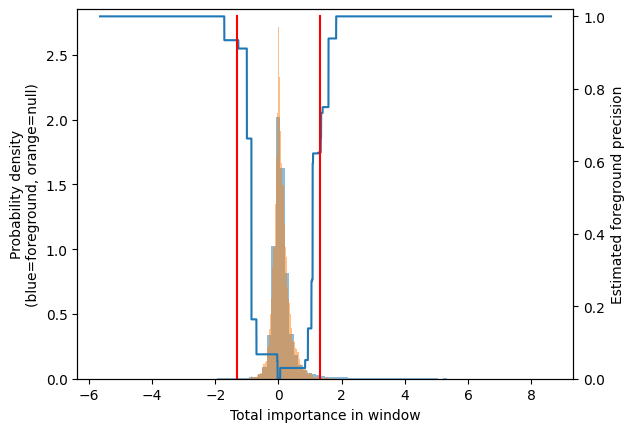

Only returning positive coords!
Got 9056 coords
Computing windowed sums on original
Only returning positive coords!
Got 9056 coords
Launching nearest neighbors affmat calculation job
MEMORY 2.564603904
Parallel runs completed
MEMORY 2.564603904
Job completed in: 9.95 s
MEMORY 2.564603904
Launching nearest neighbors affmat calculation job
MEMORY 2.564603904
Parallel runs completed
MEMORY 2.565193728
Job completed in: 9.93 s
MEMORY 2.565193728
On seqlets 0 to 5000 out of 9056


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:01<00:00,  4.54it/s]

On seqlets 5000 to 9056 out of 9056



100%|██████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [00:01<00:00,  4.96it/s]


Launching nearest neighbors affmat calculation job
MEMORY 2.593988608
Parallel runs completed
MEMORY 2.594185216
Job completed in: 9.93 s
MEMORY 2.594185216
Launching nearest neighbors affmat calculation job
MEMORY 2.593988608
Parallel runs completed
MEMORY 2.593988608
Job completed in: 10.12 s
MEMORY 2.593988608
On seqlets 0 to 5000 out of 9056


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 13.69it/s]

On seqlets 5000 to 9056 out of 9056



100%|██████████████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00, 17.19it/s]


Removed 14 duplicates
EXAMPLE IDX 0 hits:
Computing windowed sums on original
Only returning positive coords!
Got 3 coords
Original core seqlet locations


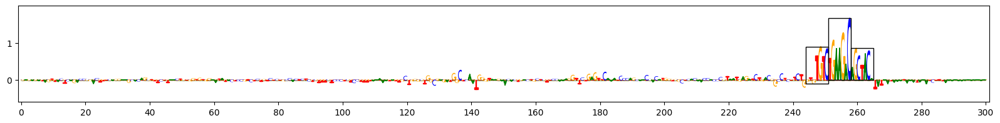

Motif matches (red = without trimming)


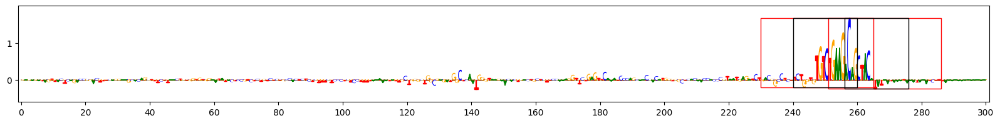

Matches to pattern 1 (the original pattern looks like this:)


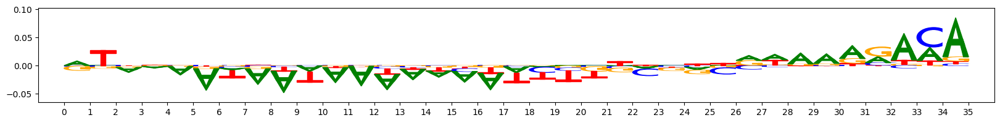

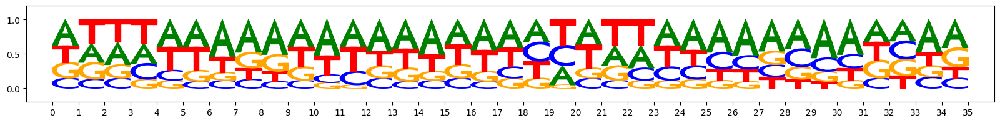

matches in this example...
MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=13.921758, exampleidx=0, start=230, end=265, trim_start=240, trim_end=260, is_revcomp=False, seqlet_orig_start=244, seqlet_orig_end=279, seqlet_orig_revcomp=False, aggregate_sim=0.042095253806810694, mod_delta=0.000553053598238833, mod_precision=0.9411764705882353, mod_percentile=0.11475409836065575, fann_perclasssum_perc=0.06557377049180324, fann_perclassavg_perc=0.049180327868852514)


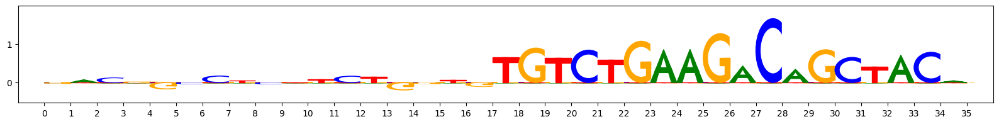

MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=9.358394, exampleidx=0, start=251, end=286, trim_start=256, trim_end=276, is_revcomp=True, seqlet_orig_start=237, seqlet_orig_end=272, seqlet_orig_revcomp=False, aggregate_sim=0.0521520365668999, mod_delta=0.00045452883589182326, mod_precision=0.5714285714285714, mod_percentile=0.08196721311475408, fann_perclasssum_perc=0.08196721311475408, fann_perclassavg_perc=0.08196721311475408)


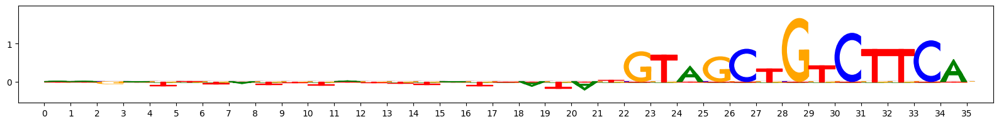

EXAMPLE IDX 1 hits:
Computing windowed sums on original
Only returning positive coords!
Got 2 coords
Original core seqlet locations


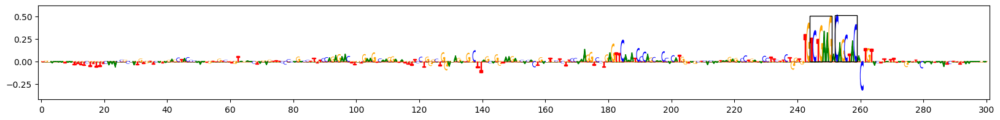

Motif matches (red = without trimming)


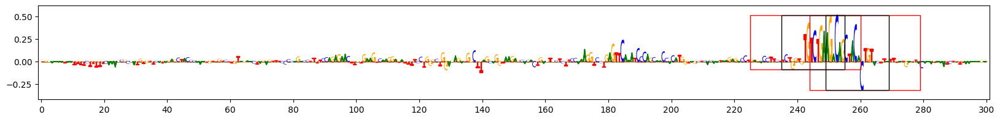

Matches to pattern 1 (the original pattern looks like this:)


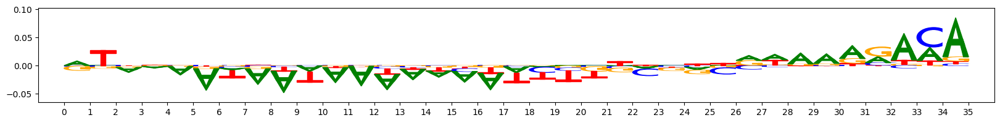

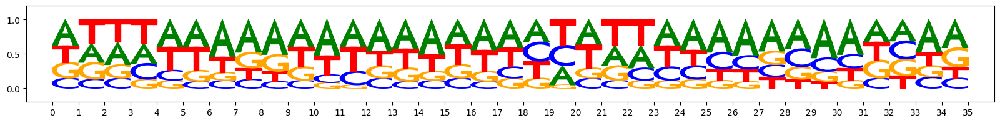

matches in this example...
MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=5.6263137, exampleidx=1, start=225, end=260, trim_start=235, trim_end=255, is_revcomp=False, seqlet_orig_start=238, seqlet_orig_end=273, seqlet_orig_revcomp=False, aggregate_sim=0.04124272771814486, mod_delta=0.0005500021507336438, mod_precision=0.9411764705882353, mod_percentile=0.11475409836065575, fann_perclasssum_perc=0.08196721311475408, fann_perclassavg_perc=0.06557377049180324)


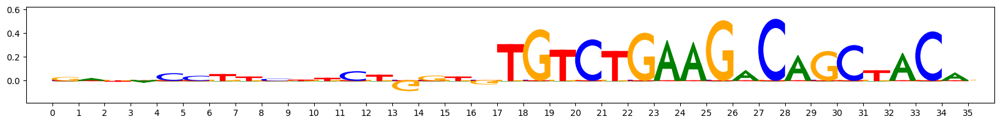

MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=4.6283436, exampleidx=1, start=244, end=279, trim_start=249, trim_end=269, is_revcomp=True, seqlet_orig_start=230, seqlet_orig_end=265, seqlet_orig_revcomp=False, aggregate_sim=0.0365309438384576, mod_delta=0.00029691015804079237, mod_precision=0.5, mod_percentile=0.016393442622950838, fann_perclasssum_perc=0.19672131147540983, fann_perclassavg_perc=0.19672131147540983)


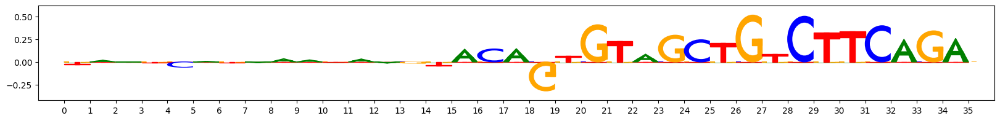

EXAMPLE IDX 2 hits:
Computing windowed sums on original
Only returning positive coords!
Got 3 coords
Original core seqlet locations


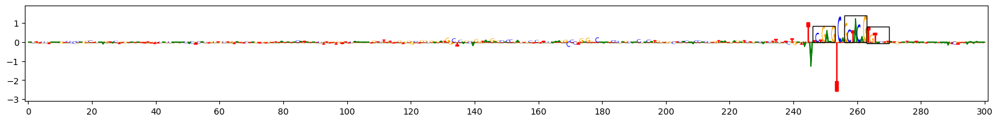

Motif matches (red = without trimming)


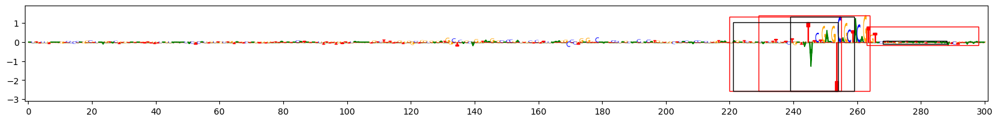

Matches to pattern 0 (the original pattern looks like this:)


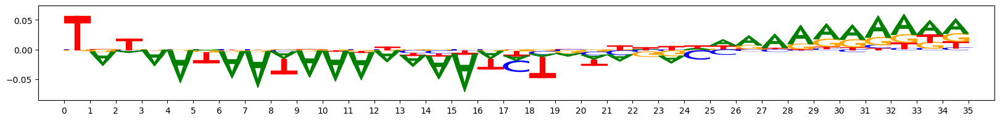

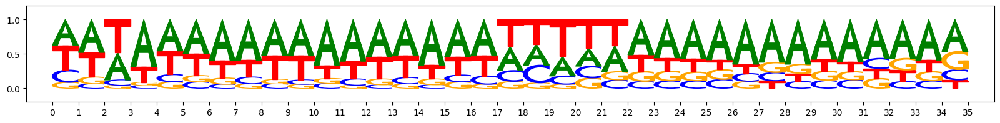

matches in this example...
MotifMatchWithImportance(patternidx=0, patternidx_rank=0, total_importance=1.4547907, exampleidx=2, start=220, end=255, trim_start=221, trim_end=254, is_revcomp=False, seqlet_orig_start=232, seqlet_orig_end=267, seqlet_orig_revcomp=False, aggregate_sim=0.008473934711242125, mod_delta=0.000410176409069559, mod_precision=0.8695652173913043, mod_percentile=0.12142857142857144, fann_perclasssum_perc=0.0071428571428571175, fann_perclassavg_perc=0.0071428571428571175)


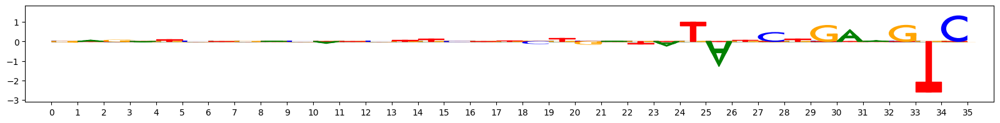

Matches to pattern 1 (the original pattern looks like this:)


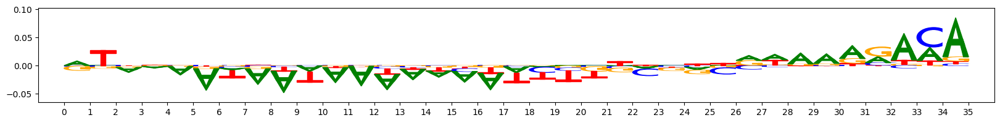

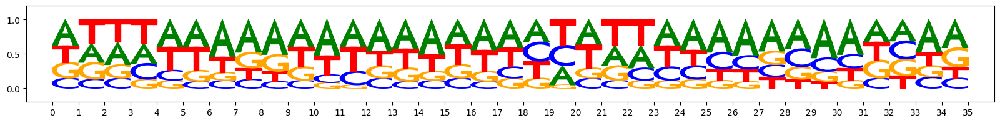

matches in this example...
MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=8.266979, exampleidx=2, start=229, end=264, trim_start=239, trim_end=259, is_revcomp=False, seqlet_orig_start=242, seqlet_orig_end=277, seqlet_orig_revcomp=False, aggregate_sim=0.03831803331448333, mod_delta=0.0003244078062143925, mod_precision=0.5695664027789787, mod_percentile=0.016393442622950838, fann_perclasssum_perc=0.09836065573770492, fann_perclassavg_perc=0.09836065573770492)


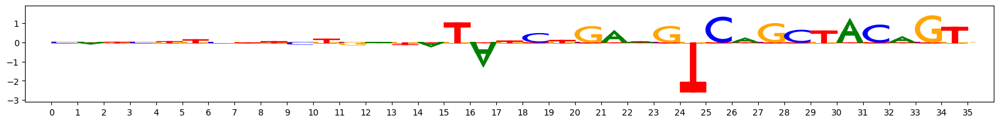

MotifMatchWithImportance(patternidx=1, patternidx_rank=0, total_importance=0.5563496, exampleidx=2, start=263, end=298, trim_start=268, trim_end=288, is_revcomp=True, seqlet_orig_start=249, seqlet_orig_end=284, seqlet_orig_revcomp=False, aggregate_sim=0.12791390725782312, mod_delta=0.0008016685822868222, mod_precision=1.0, mod_percentile=0.39344262295081966, fann_perclasssum_perc=0.19672131147540983, fann_perclassavg_perc=0.19672131147540983)


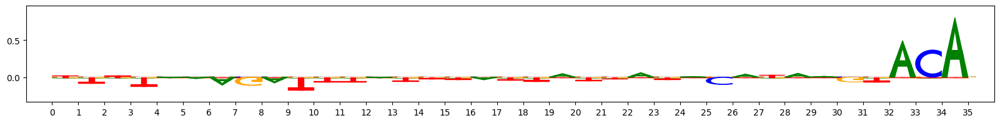

For metacluster_0
Path to node: root/0
Number of seqlets 140
Saved figure at nodepath root/0!


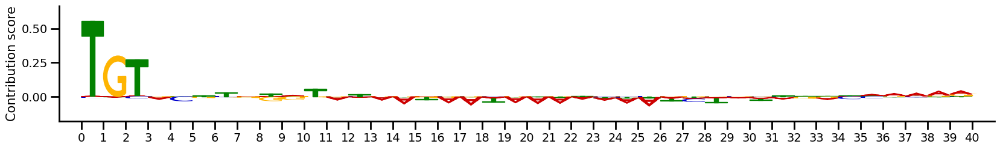

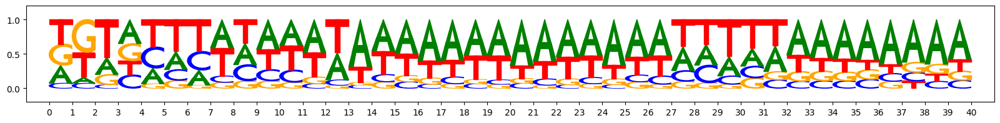

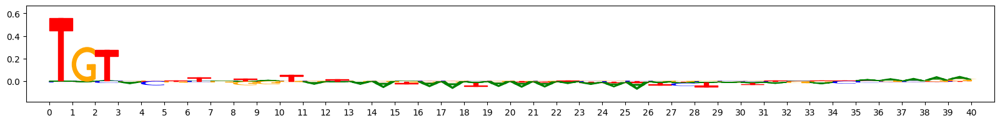

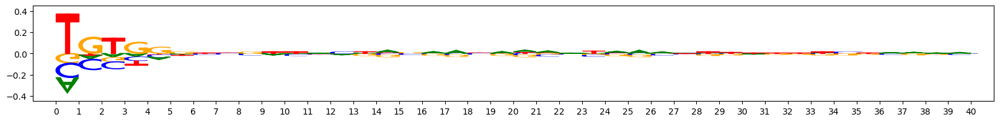

Path to node: root/0/0
Number of seqlets 76


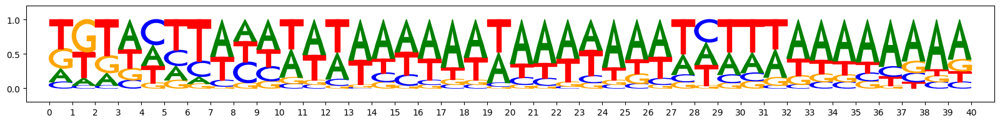

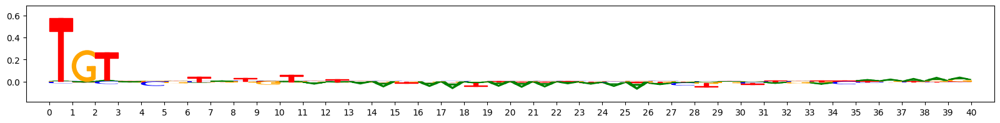

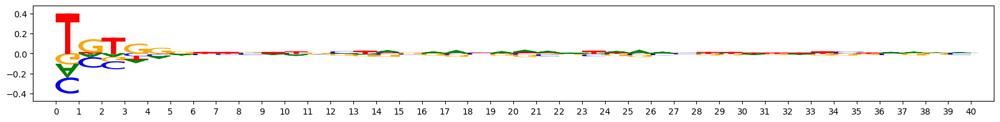

Path to node: root/0/1
Number of seqlets 65


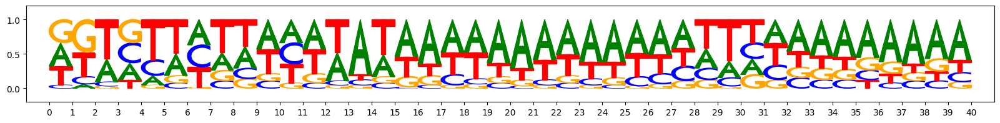

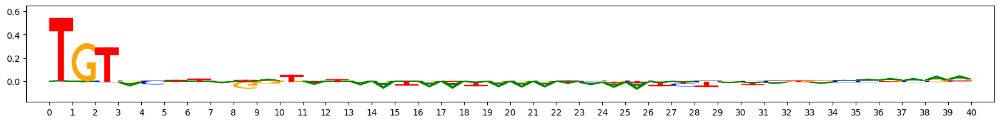

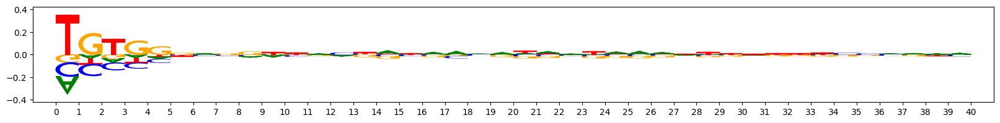

Path to node: root/1
Number of seqlets 61


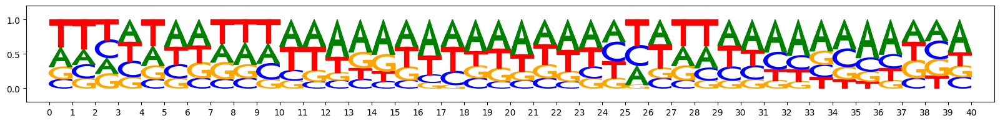

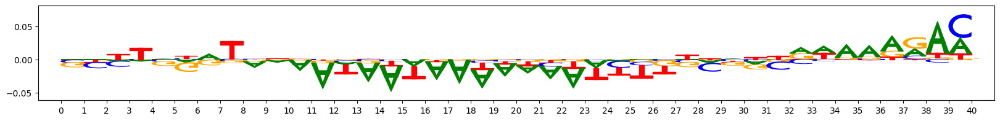

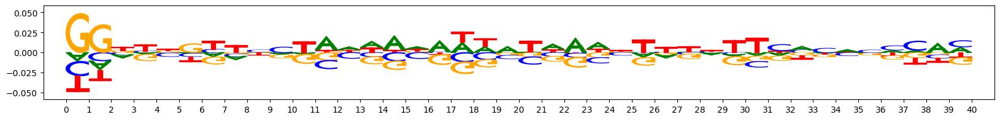

Path to node: root/2
Number of seqlets 29


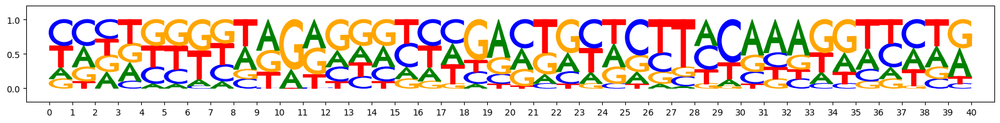

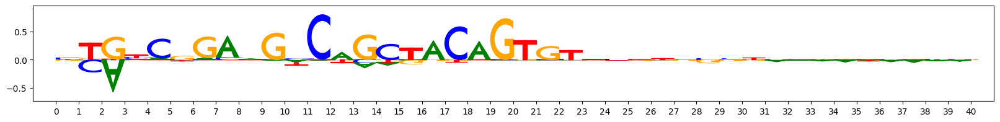

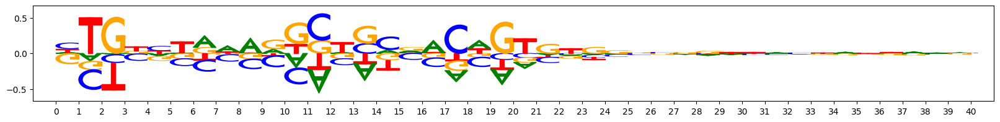

Path to node: root/3
Number of seqlets 17


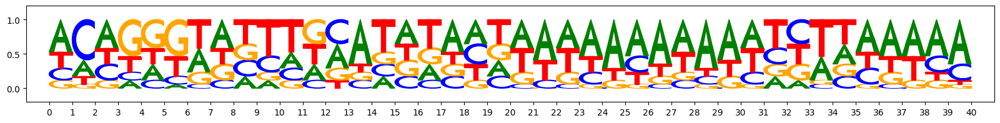

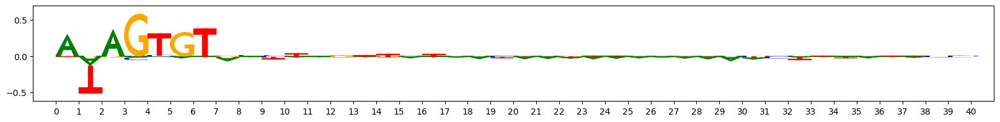

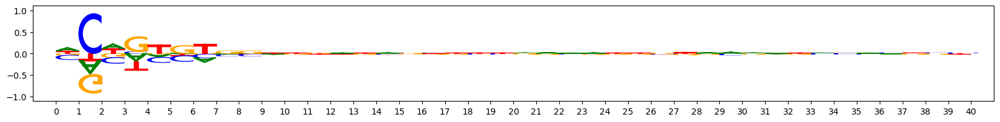

Path to node: root/4
Number of seqlets 8


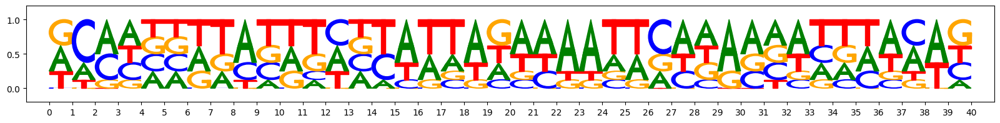

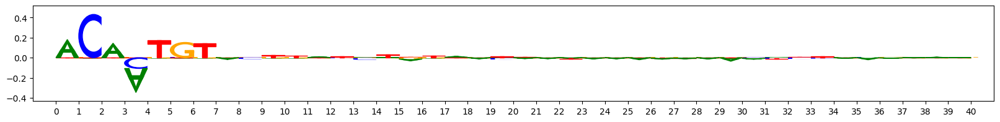

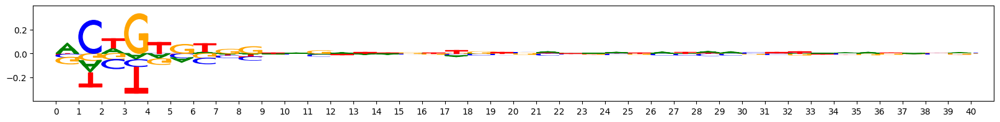

Path to node: root/5
Number of seqlets 8


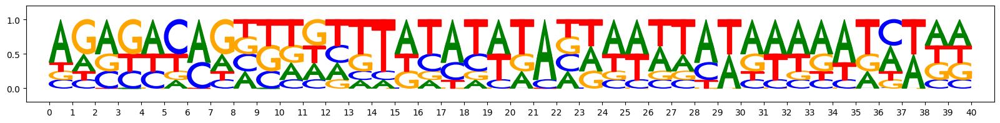

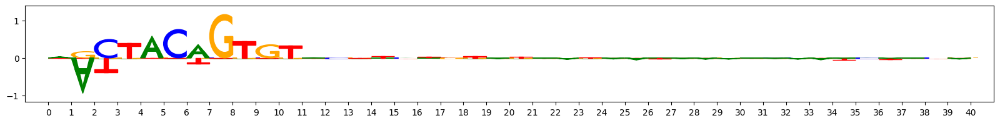

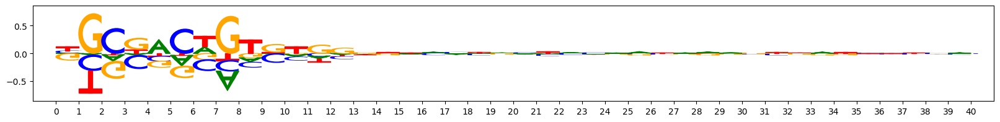

Path to node: root/6
Number of seqlets 5


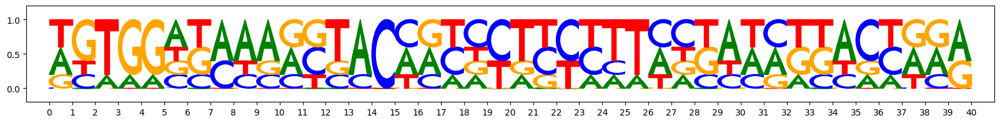

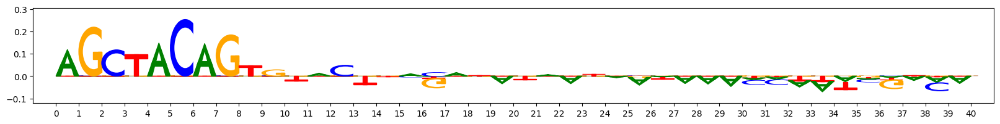

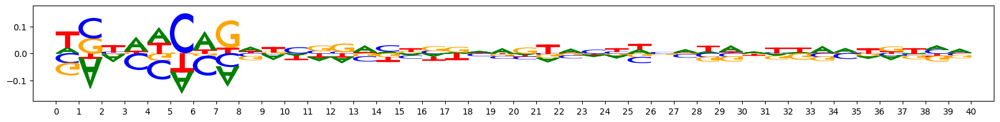

Path to node: root/7
Number of seqlets 3


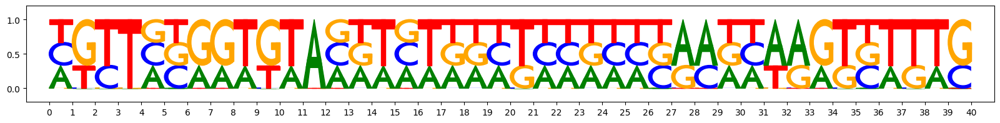

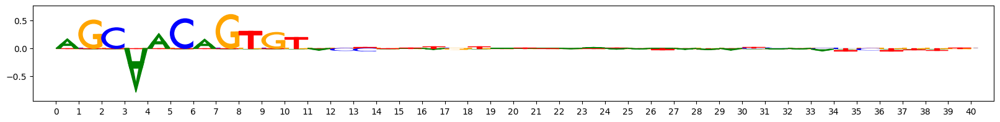

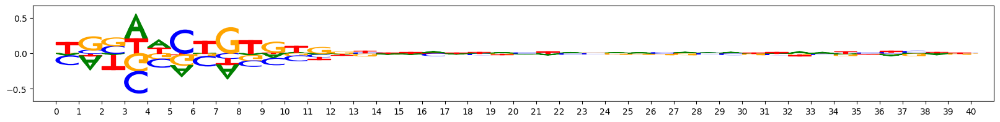

Path to node: root/8
Number of seqlets 2


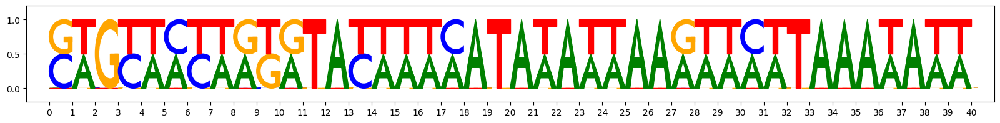

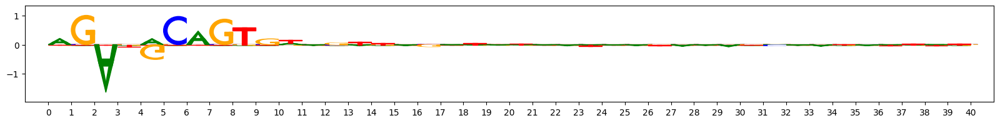

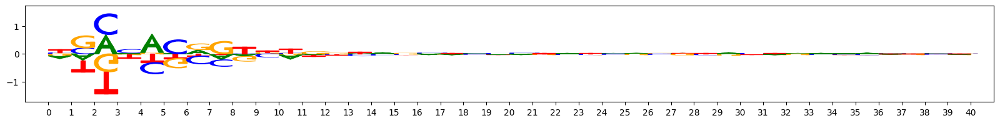

In [57]:
#Label=1
hit_scoring(input_data, metacluster="metacluster_0")

### B2_Mm2

Getting trimmed patterns, subclustering them
Trimming the patterns to the target length
Apply subclustering
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 217 samples in 0.002s...
[t-SNE] Computed neighbors for 217 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 217 / 217
[t-SNE] Mean sigma: 0.420099
[t-SNE] Computed conditional probabilities in 0.004s
[t-SNE] Iteration 50: error = 49.3743210, gradient norm = 0.2858907 (50 iterations in 0.031s)
[t-SNE] Iteration 100: error = 49.4503746, gradient norm = 0.3724467 (50 iterations in 0.032s)
[t-SNE] Iteration 150: error = 51.5444756, gradient norm = 0.2407760 (50 iterations in 0.031s)


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done 217 out of 217 | elapsed:    0.0s finished
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_base.py:246: EfficiencyWarning: Precomputed sparse input was not sorted by row values. Use the function sklearn.neighbors.sort_graph_by_row_values to sort the input by row values, with warn_when_not_sorted=False to remove this warning.
  warnings.warn(


[t-SNE] Iteration 200: error = 51.1265831, gradient norm = 0.2490856 (50 iterations in 0.031s)
[t-SNE] Iteration 250: error = 50.4795647, gradient norm = 0.2361168 (50 iterations in 0.030s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.479565
[t-SNE] Iteration 300: error = 0.4638993, gradient norm = 0.0046511 (50 iterations in 0.026s)
[t-SNE] Iteration 350: error = 0.4364952, gradient norm = 0.0029575 (50 iterations in 0.024s)
[t-SNE] Iteration 400: error = 0.4307611, gradient norm = 0.0022960 (50 iterations in 0.024s)
[t-SNE] Iteration 450: error = 0.4258811, gradient norm = 0.0012524 (50 iterations in 0.024s)
[t-SNE] Iteration 500: error = 0.4235363, gradient norm = 0.0009968 (50 iterations in 0.024s)
[t-SNE] Iteration 550: error = 0.4215162, gradient norm = 0.0013006 (50 iterations in 0.024s)
[t-SNE] Iteration 600: error = 0.4197215, gradient norm = 0.0003348 (50 iterations in 0.024s)
[t-SNE] Iteration 650: error = 0.4196921, gradient norm = 0.0004022 (50 it

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.7s


Parallel Leiden runs finished
2025-01-23 17:30:48.898416 MEMORY 3.277242368
Quality: 0.43442843814565757
Got subclusters: Counter({0: 38, 1: 37, 2: 27, 3: 26, 4: 22, 5: 21, 6: 20, 7: 11, 8: 10, 9: 5})
[t-SNE] Computing 69 nearest neighbors...
[t-SNE] Indexed 70 samples in 0.000s...
[t-SNE] Computed neighbors for 70 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 70 / 70
[t-SNE] Mean sigma: 0.945819
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 41.9001350, gradient norm = 0.5489330 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 43.7034073, gradient norm = 0.5950664 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 44.1406212, gradient norm = 0.5130909 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 42.7632713, gradient norm = 0.5529038 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 43.4785995, gradient norm = 0.4296693 (50 iterations in 0.006s)
[t-SNE] KL divergence after 250 iterations w

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.8s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done  70 out of  70 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:30:50.628520 MEMORY 3.277242368
Quality: 0.09820008846273752
Quality: 0.09828265674471758
Got subclusters: Counter({0: 26, 1: 20, 2: 9, 3: 8, 4: 7})
[t-SNE] Computing 32 nearest neighbors...
[t-SNE] Indexed 33 samples in 0.000s...
[t-SNE] Computed neighbors for 33 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 33 / 33
[t-SNE] Mean sigma: 40.084309
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 39.9890480, gradient norm = 0.6130359 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 39.7572861, gradient norm = 0.6544051 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 42.9458809, gradient norm = 0.6340745 (50 iterations in 0.004s)
[t-SNE] Iteration 200: error = 39.4868546, gradient norm = 0.5706074 (50 iterations in 0.003s)
[t-SNE] Iteration 250: error = 40.5380859, gradient norm = 0.5575528 (50 iterations in 0.003s)
[t-SNE] KL divergence after 250 iterations with ear

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  24 out of  33 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  33 out of  33 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:30:52.201183 MEMORY 3.277242368
Quality: -7.105427357600852e-15
Got subclusters: Counter({0: 33})
[t-SNE] Computing 29 nearest neighbors...
[t-SNE] Indexed 30 samples in 0.000s...
[t-SNE] Computed neighbors for 30 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 30 / 30
[t-SNE] Mean sigma: 72.895334
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 39.5920868, gradient norm = 0.8825397 (50 iterations in 0.003s)
[t-SNE] Iteration 100: error = 36.4271584, gradient norm = 0.7918267 (50 iterations in 0.002s)
[t-SNE] Iteration 150: error = 40.4826393, gradient norm = 0.6215631 (50 iterations in 0.002s)
[t-SNE] Iteration 200: error = 37.3149796, gradient norm = 0.5461470 (50 iterations in 0.002s)
[t-SNE] Iteration 250: error = 38.9954872, gradient norm = 0.5135575 (50 iterations in 0.002s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 38.995487
[t-SNE] Iteration 300: e

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.5s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  18 out of  30 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  30 out of  30 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:30:53.770296 MEMORY 3.277242368
Quality: 1.9095836023552904e-14
Got subclusters: Counter({0: 30})
[t-SNE] Computing 34 nearest neighbors...
[t-SNE] Indexed 35 samples in 0.000s...
[t-SNE] Computed neighbors for 35 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 35 / 35
[t-SNE] Mean sigma: 14.110674
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 42.5961342, gradient norm = 0.3743265 (50 iterations in 0.003s)
[t-SNE] Iteration 100: error = 40.5073891, gradient norm = 0.5500621 (50 iterations in 0.003s)
[t-SNE] Iteration 150: error = 40.3573532, gradient norm = 0.4141452 (50 iterations in 0.003s)
[t-SNE] Iteration 200: error = 40.1016159, gradient norm = 0.4306310 (50 iterations in 0.003s)
[t-SNE] Iteration 250: error = 38.0316734, gradient norm = 0.7054316 (50 iterations in 0.003s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 38.031673
[t-SNE] Iteration 300: e

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.5s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  28 out of  35 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  35 out of  35 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.6s


Parallel Leiden runs finished
2025-01-23 17:30:55.379458 MEMORY 3.277242368
Quality: 2.2204460492503205e-16
Got subclusters: Counter({0: 35})
Preparing seqlet scorer
Pattern length (and hence target seqlet size) is 35
Prepare seqlet scorer
Computing best alignments for all motifseqlets
Launching nearest neighbors affmat calculation job
MEMORY 3.277242368
Parallel runs completed
MEMORY 3.2780288


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    1.5s finished


Job completed in: 0.22 s
MEMORY 3.241639936
Launching nearest neighbors affmat calculation job
MEMORY 3.241639936
Parallel runs completed
MEMORY 3.241836544
Job completed in: 0.23 s
MEMORY 3.241836544
On seqlets 0 to 385 out of 385


100%|████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 21.55it/s]


0 seqlets out of 385 did not have themselves in their nearest neighbs, likelydue to alignment issues
Insantiating a precision scorer based on fann_perclasssum
Accuracy: 0.9506493506493506
Insantiating a precision scorer based on fann_perclassavg
Accuracy: 0.9818181818181818
Launching nearest neighbors affmat calculation job
MEMORY 3.241836544


/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in ver

Parallel runs completed
MEMORY 3.241836544
Job completed in: 0.71 s
MEMORY 3.241836544
Launching nearest neighbors affmat calculation job
MEMORY 3.241836544
Parallel runs completed
MEMORY 3.242033152
Job completed in: 0.74 s
MEMORY 3.242033152
On seqlets 0 to 385 out of 385


100%|█████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 178.08it/s]

Insantiating a precision scorer based on aggregate sim
Accuracy: 0.5818181818181818
Mapping affinity to distmat
Symmetrizing nearest neighbors



/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in ve

Computing betas for density adaptation
Computing normalizing denominators
Computing density-adapted nn affmat
Beginning preprocessing + Leiden
2025-01-23 17:30:58.872383 MEMORY 3.242033152
sources, targets, weights extracted
2025-01-23 17:30:58.874605 MEMORY 3.242033152
initclusters length: 385
About to launch parallel Leiden runs
2025-01-23 17:30:58.875868 MEMORY 3.242033152


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.9s


Parallel Leiden runs finished
2025-01-23 17:31:01.058414 MEMORY 3.242033152
Quality: 0.24214775400630936
Quality: 0.24214775400632507
Quality: 0.24214775400632957
Quality: 0.2421477540063333


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.2s finished
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/me

Number of reclustered idxs: 5
{(2, 4), (4, 3), (0, 0), (1, 1), (3, 2)}
Preparing modularity scorer
Accuracy: 1.0
Computing windowed sums on original
Generating null dist
peak(mu)= 0.03043542945384979
Computing threshold
Subsampling!
For increasing = True , the minimum IR precision was 0.3464422053272827 occurring at 0.0 implying a frac_neg of 0.530086563347884
To be conservative, adjusted frac neg is 0.95
For increasing = False , the minimum IR precision was 0.423286754465908 occurring at -3.557652235031128e-07 implying a frac_neg of 0.733963989458754
To be conservative, adjusted frac neg is 0.95
Thresholds from null dist were -1.6859095692634583  and  1.459328830242157 with frac passing 0.037484
Final raw thresholds are -1.6859095692634583  and  1.459328830242157
Final transformed thresholds are -0.966427687648093  and  0.9624062874213356


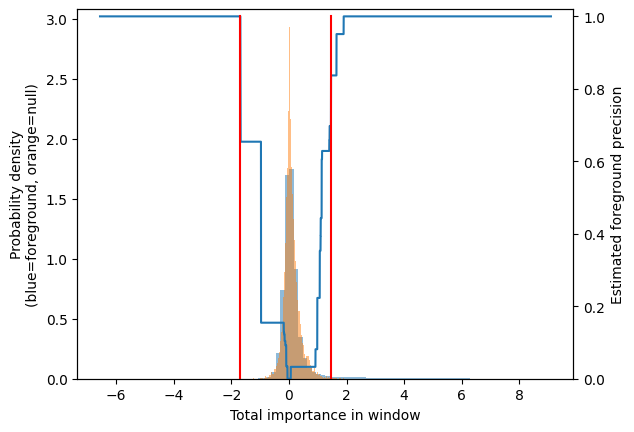

Only returning positive coords!
Got 25235 coords
Computing windowed sums on original
Only returning positive coords!
Got 25235 coords
Launching nearest neighbors affmat calculation job
MEMORY 3.249106944
Parallel runs completed
MEMORY 3.249696768
Job completed in: 32.36 s
MEMORY 3.249696768
Launching nearest neighbors affmat calculation job
MEMORY 3.248717824
Parallel runs completed
MEMORY 3.24911104
Job completed in: 32.76 s
MEMORY 3.24911104
On seqlets 0 to 5000 out of 25235


100%|████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:04<00:00,  4.38it/s]

On seqlets 5000 to 10000 out of 25235



100%|████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:04<00:00,  4.13it/s]

On seqlets 10000 to 15000 out of 25235



100%|████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:04<00:00,  4.34it/s]

On seqlets 15000 to 20000 out of 25235



100%|████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:04<00:00,  4.25it/s]

On seqlets 20000 to 25000 out of 25235



100%|████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:04<00:00,  4.36it/s]

On seqlets 25000 to 25235 out of 25235



100%|████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 33.06it/s]


Launching nearest neighbors affmat calculation job
MEMORY 3.464224768
Parallel runs completed
MEMORY 3.46402816
Job completed in: 30.13 s
MEMORY 3.46402816
Launching nearest neighbors affmat calculation job
MEMORY 3.46402816
Parallel runs completed
MEMORY 3.46402816
Job completed in: 32.5 s
MEMORY 3.46402816
On seqlets 0 to 5000 out of 25235


100%|██████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 12.69it/s]

On seqlets 5000 to 10000 out of 25235



100%|██████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00,  7.08it/s]

On seqlets 10000 to 15000 out of 25235



100%|██████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 11.73it/s]

On seqlets 15000 to 20000 out of 25235



100%|██████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00,  8.71it/s]

On seqlets 20000 to 25000 out of 25235



100%|██████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00,  9.30it/s]

On seqlets 25000 to 25235 out of 25235



100%|█████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 278.52it/s]


Removed 0 duplicates
EXAMPLE IDX 6 hits:
Computing windowed sums on original
Only returning positive coords!
Got 3 coords
Original core seqlet locations


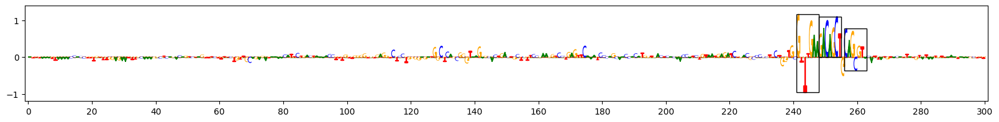

Motif matches (red = without trimming)


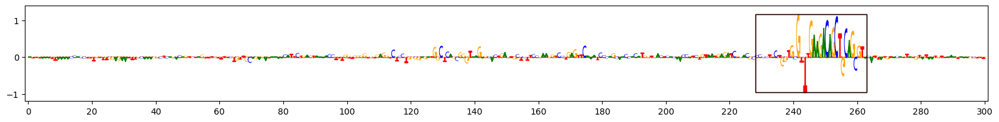

Matches to pattern 0 (the original pattern looks like this:)


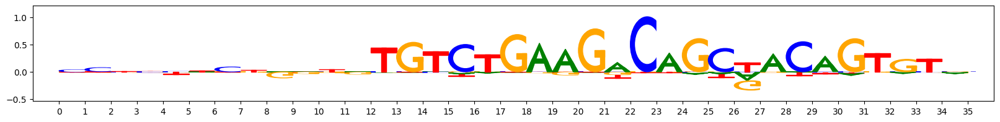

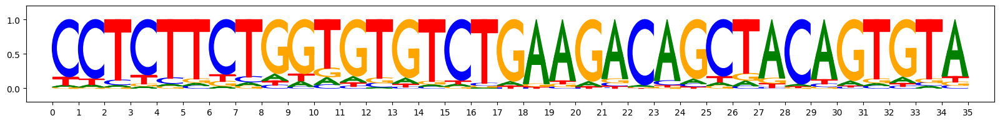

matches in this example...
MotifMatchWithImportance(patternidx=0, patternidx_rank=0, total_importance=9.8916025, exampleidx=6, start=228, end=263, trim_start=228, trim_end=263, is_revcomp=False, seqlet_orig_start=227, seqlet_orig_end=262, seqlet_orig_revcomp=False, aggregate_sim=0.39882460349992344, mod_delta=0.00033866616451370263, mod_precision=0.48771664103952084, mod_percentile=0.0, fann_perclasssum_perc=0.004608294930875556, fann_perclassavg_perc=0.004608294930875556)


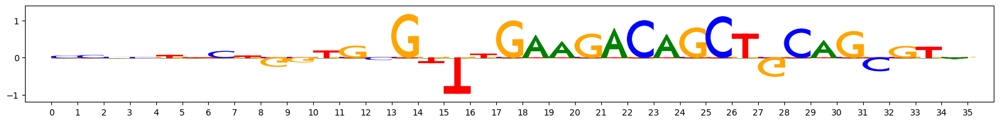

EXAMPLE IDX 92 hits:
Computing windowed sums on original
Only returning positive coords!
Got 3 coords
Original core seqlet locations


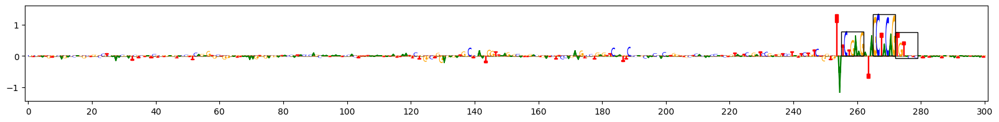

Motif matches (red = without trimming)


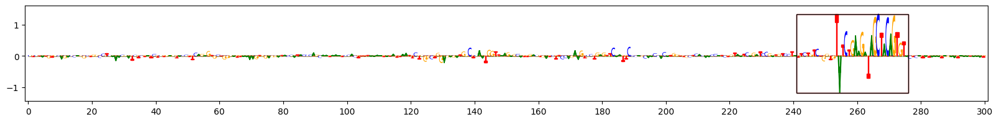

Matches to pattern 0 (the original pattern looks like this:)


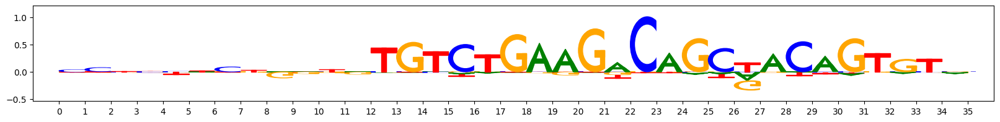

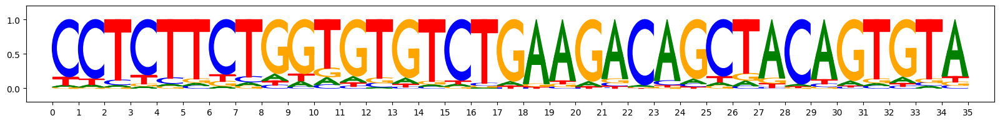

matches in this example...
MotifMatchWithImportance(patternidx=0, patternidx_rank=0, total_importance=12.625812, exampleidx=92, start=241, end=276, trim_start=241, trim_end=276, is_revcomp=False, seqlet_orig_start=241, seqlet_orig_end=276, seqlet_orig_revcomp=False, aggregate_sim=0.4448040694986976, mod_delta=0.00027258980709699704, mod_precision=0.422211262846587, mod_percentile=0.0, fann_perclasssum_perc=0.01382488479262678, fann_perclassavg_perc=0.01382488479262678)


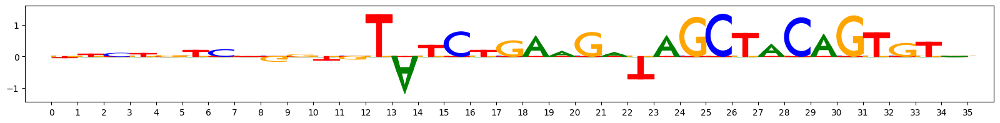

EXAMPLE IDX 133 hits:
Computing windowed sums on original
Only returning positive coords!
Got 2 coords
Original core seqlet locations


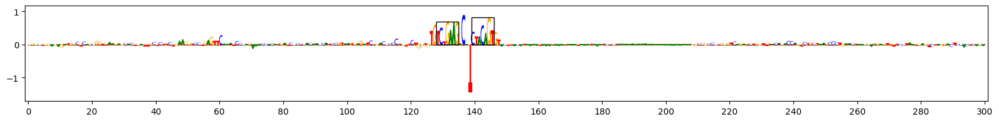

Motif matches (red = without trimming)


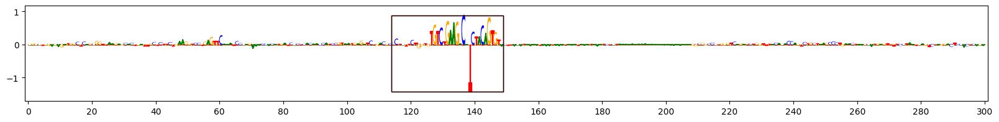

Matches to pattern 0 (the original pattern looks like this:)


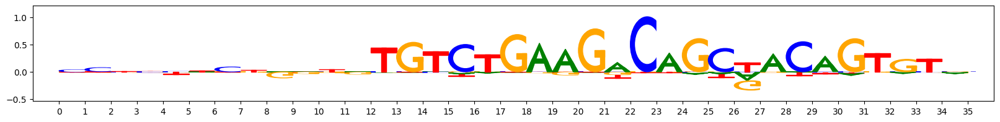

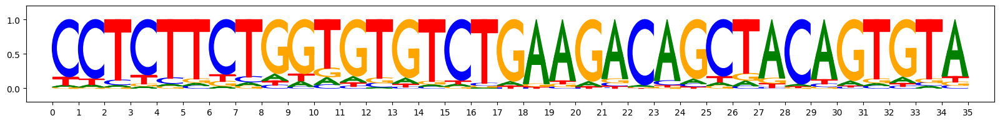

matches in this example...
MotifMatchWithImportance(patternidx=0, patternidx_rank=0, total_importance=7.651917, exampleidx=133, start=114, end=149, trim_start=114, trim_end=149, is_revcomp=False, seqlet_orig_start=114, seqlet_orig_end=149, seqlet_orig_revcomp=False, aggregate_sim=0.5583220247549737, mod_delta=0.0003362460548792445, mod_precision=0.4853174440639099, mod_percentile=0.0, fann_perclasssum_perc=0.14746543778801846, fann_perclassavg_perc=0.13364055299539168)


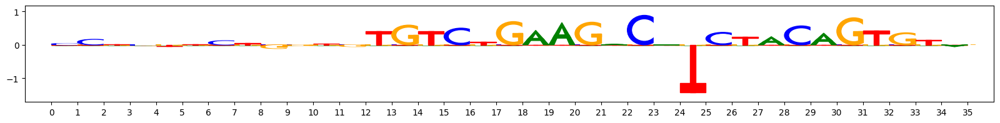

For metacluster_0
Path to node: root/0
Number of seqlets 217
Saved figure at nodepath root/0!


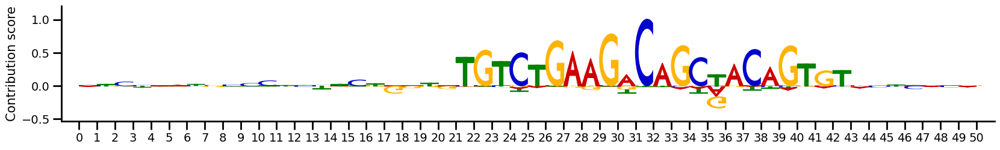

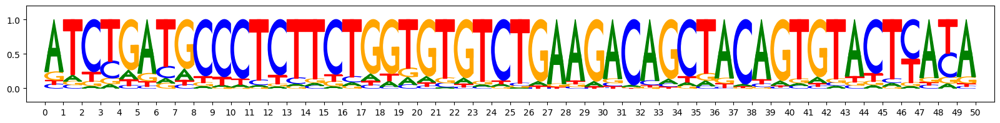

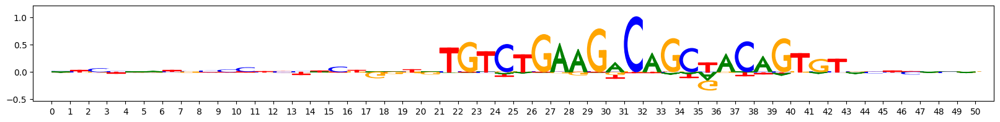

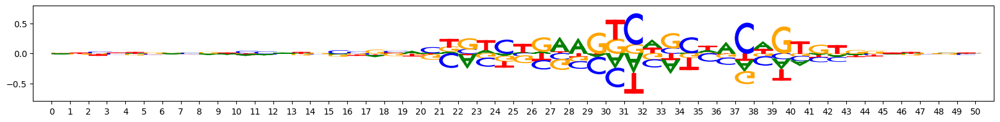

Path to node: root/1
Number of seqlets 35


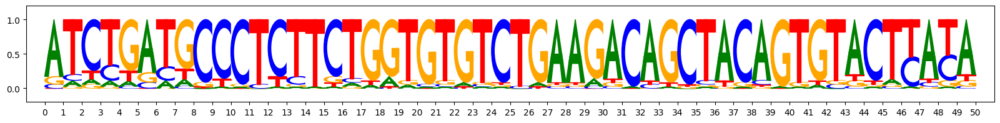

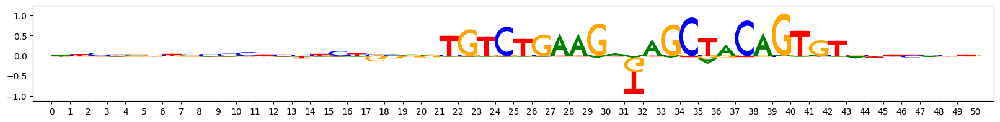

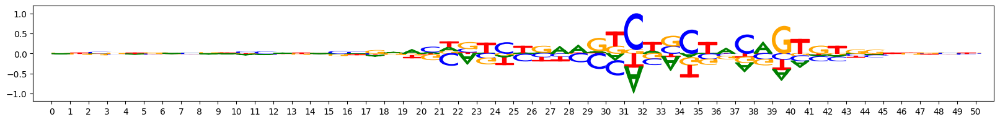

Path to node: root/2
Number of seqlets 29


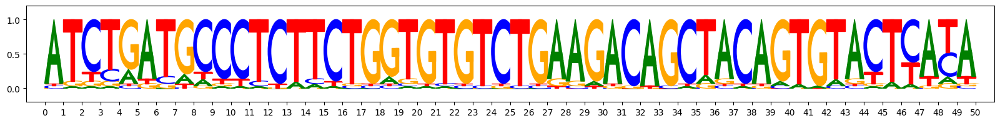

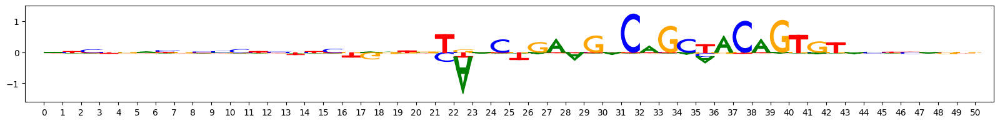

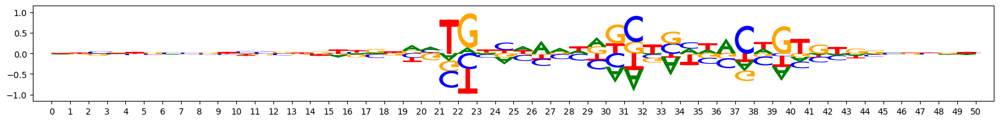

Path to node: root/3
Number of seqlets 22


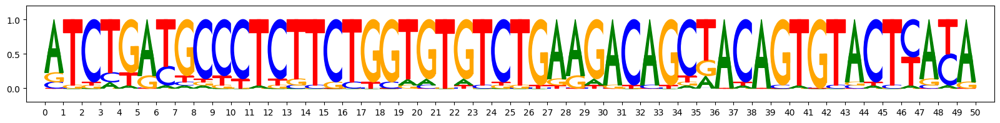

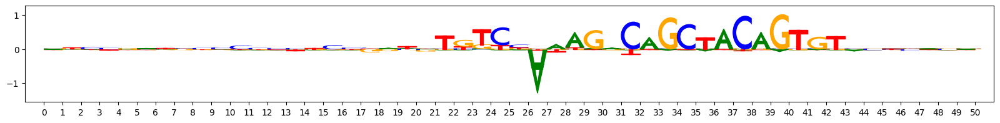

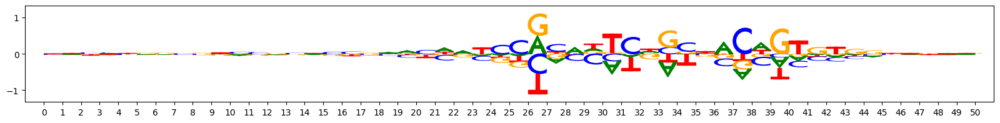

Path to node: root/4
Number of seqlets 19


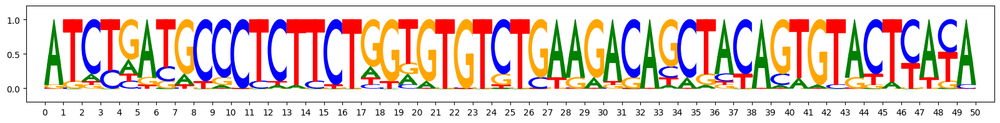

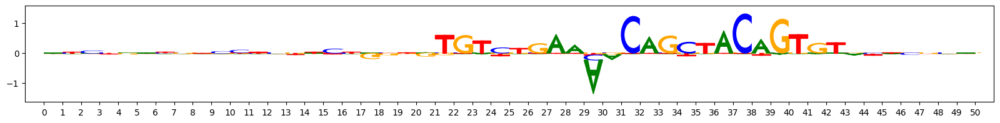

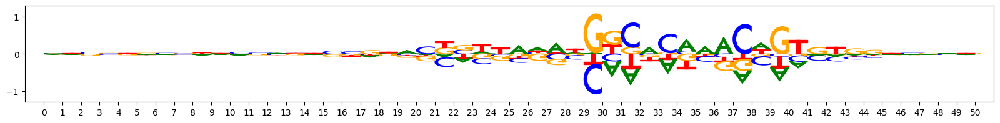

Path to node: root/5
Number of seqlets 70


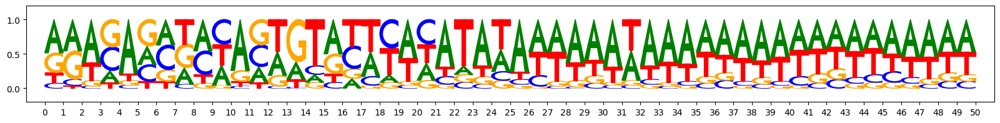

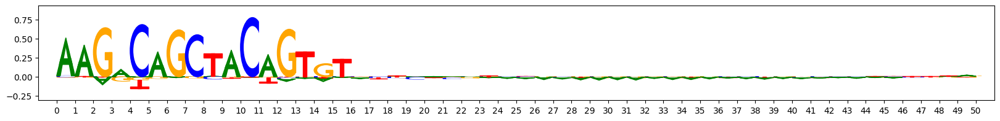

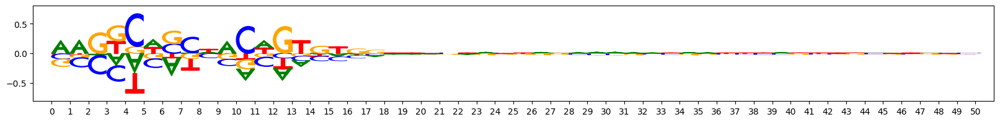

Path to node: root/6
Number of seqlets 40


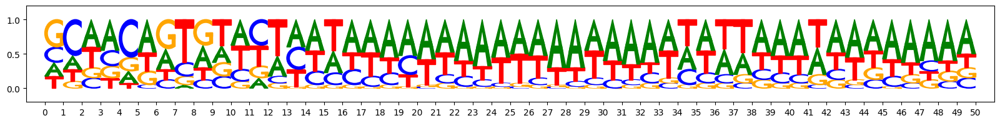

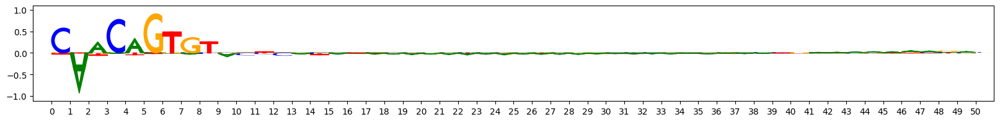

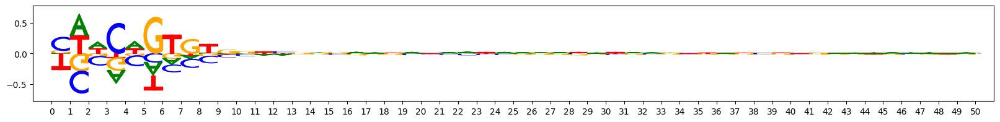

Path to node: root/7
Number of seqlets 39


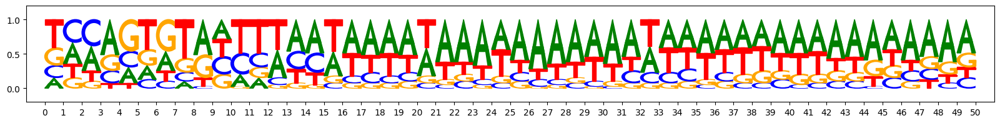

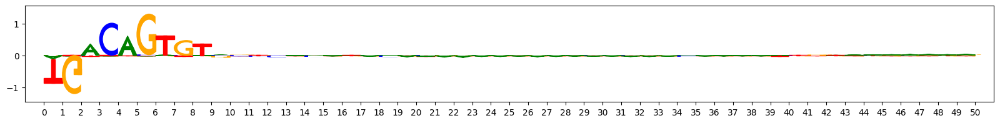

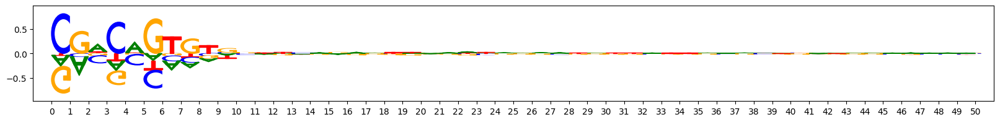

Path to node: root/8
Number of seqlets 15


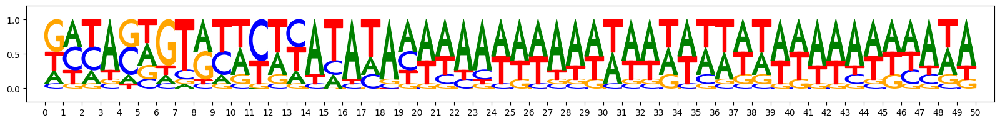

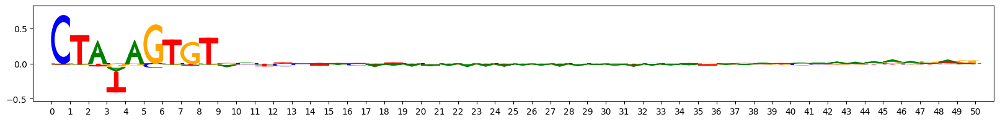

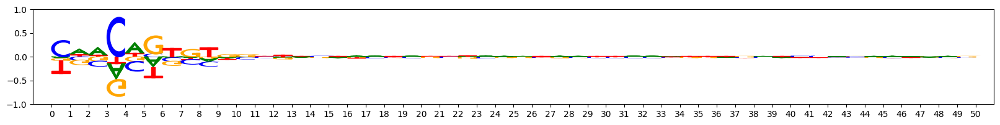

Path to node: root/9
Number of seqlets 13


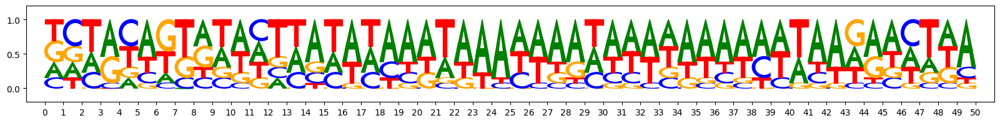

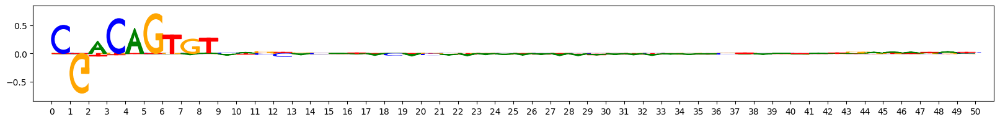

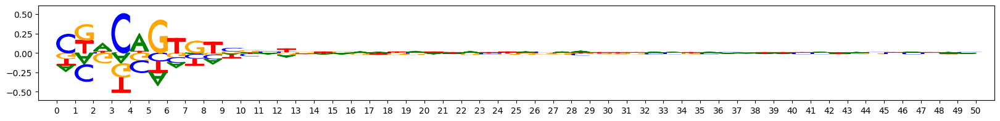

In [76]:
#Label=1
hit_scoring(input_data, metacluster="metacluster_0")

### All B2 Families

Getting trimmed patterns, subclustering them
Trimming the patterns to the target length
Apply subclustering


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done 353 out of 353 | elapsed:    0.3s finished
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/neighbors/_base.py:246: EfficiencyWarning: Precomputed sparse input was not sorted by row values. Use the function sklearn.neighbors.sort_graph_by_row_values to sort the input by row values, with warn_when_not_sorted=False to remove this warning.
  warnings.warn(


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 353 samples in 0.003s...
[t-SNE] Computed neighbors for 353 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 353 / 353
[t-SNE] Mean sigma: 0.408421
[t-SNE] Computed conditional probabilities in 0.015s
[t-SNE] Iteration 50: error = 50.5771866, gradient norm = 0.0489933 (50 iterations in 0.102s)
[t-SNE] Iteration 100: error = 50.6412010, gradient norm = 0.0660953 (50 iterations in 0.100s)
[t-SNE] Iteration 150: error = 50.6672554, gradient norm = 0.0773142 (50 iterations in 0.101s)
[t-SNE] Iteration 200: error = 50.5907669, gradient norm = 0.0530716 (50 iterations in 0.100s)
[t-SNE] Iteration 250: error = 50.6582642, gradient norm = 0.0741300 (50 iterations in 0.100s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.658264
[t-SNE] Iteration 300: error = 0.5965178, gradient norm = 0.0057553 (50 iterations in 0.075s)
[t-SNE] Iteration 350: error = 0.5461276, gradient norm = 0.0030089 

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.5s


Parallel Leiden runs finished
2025-01-23 17:51:22.091887 MEMORY 3.99357952
Quality: 0.5283558153741624


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    3.9s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   1 out of   1 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Done   2 out of   2 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Done 197 out of 240 | elapsed:    0.1s remaining:    0.0s


Got subclusters: Counter({0: 70, 1: 56, 2: 54, 3: 48, 4: 39, 5: 34, 6: 26, 7: 23, 8: 3})
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 240 samples in 0.002s...
[t-SNE] Computed neighbors for 240 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 240 / 240
[t-SNE] Mean sigma: 1.054980


[Parallel(n_jobs=22)]: Done 240 out of 240 | elapsed:    0.2s finished


[t-SNE] Computed conditional probabilities in 0.008s
[t-SNE] Iteration 50: error = 47.1875343, gradient norm = 0.1733590 (50 iterations in 0.060s)
[t-SNE] Iteration 100: error = 50.4550362, gradient norm = 0.1619041 (50 iterations in 0.059s)
[t-SNE] Iteration 150: error = 49.7213669, gradient norm = 0.2269620 (50 iterations in 0.059s)
[t-SNE] Iteration 200: error = 48.9509926, gradient norm = 0.5344465 (50 iterations in 0.063s)
[t-SNE] Iteration 250: error = 50.3279991, gradient norm = 0.3430100 (50 iterations in 0.066s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.327999
[t-SNE] Iteration 300: error = 0.7545149, gradient norm = 0.0030302 (50 iterations in 0.055s)
[t-SNE] Iteration 350: error = 0.7472779, gradient norm = 0.0010939 (50 iterations in 0.050s)
[t-SNE] Iteration 400: error = 0.7454606, gradient norm = 0.0005963 (50 iterations in 0.047s)
[t-SNE] Iteration 450: error = 0.7439573, gradient norm = 0.0003571 (50 iterations in 0.048s)
[t-SNE] Iteration 5

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.5s


Parallel Leiden runs finished
2025-01-23 17:51:27.091679 MEMORY 3.993776128
Quality: 0.3620100081648783
Quality: 0.3622097394009047
Quality: 0.3624223227266678


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    3.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   1 out of   1 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Done   7 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done  75 out of  75 | elapsed:    0.2s finished


Got subclusters: Counter({0: 83, 1: 54, 2: 38, 3: 29, 4: 26, 5: 10})
[t-SNE] Computing 74 nearest neighbors...
[t-SNE] Indexed 75 samples in 0.001s...
[t-SNE] Computed neighbors for 75 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 75 / 75
[t-SNE] Mean sigma: 1.860658
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 42.9411354, gradient norm = 0.6014464 (50 iterations in 0.012s)
[t-SNE] Iteration 100: error = 43.9670067, gradient norm = 0.5338926 (50 iterations in 0.012s)
[t-SNE] Iteration 150: error = 45.0976334, gradient norm = 0.4907362 (50 iterations in 0.012s)
[t-SNE] Iteration 200: error = 47.0654106, gradient norm = 0.4558325 (50 iterations in 0.011s)
[t-SNE] Iteration 250: error = 44.0938416, gradient norm = 0.6332004 (50 iterations in 0.012s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 44.093842
[t-SNE] Iteration 300: error = 0.1733974, gradient norm = 0.0035507 (50 iterations in 0.011s)
[t-S

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.1s


Parallel Leiden runs finished
2025-01-23 17:51:30.447764 MEMORY 3.993776128
Quality: 0.15106951475776068


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.9s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  30 out of  73 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  73 out of  73 | elapsed:    0.0s finished


Got subclusters: Counter({0: 30, 1: 26, 2: 19})
[t-SNE] Computing 72 nearest neighbors...
[t-SNE] Indexed 73 samples in 0.001s...
[t-SNE] Computed neighbors for 73 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 73 / 73
[t-SNE] Mean sigma: 0.572621
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 49.2982903, gradient norm = 0.5111902 (50 iterations in 0.011s)
[t-SNE] Iteration 100: error = 51.2947388, gradient norm = 0.4778512 (50 iterations in 0.016s)
[t-SNE] Iteration 150: error = 53.1118126, gradient norm = 0.6870253 (50 iterations in 0.012s)
[t-SNE] Iteration 200: error = 50.6885910, gradient norm = 0.5724692 (50 iterations in 0.012s)
[t-SNE] Iteration 250: error = 45.2590714, gradient norm = 0.6613221 (50 iterations in 0.012s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 45.259071
[t-SNE] Iteration 300: error = 0.0875935, gradient norm = 0.0076510 (50 iterations in 0.011s)
[t-SNE] Iteration 350: er

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.0s


Parallel Leiden runs finished
2025-01-23 17:51:33.402119 MEMORY 3.993776128
Quality: 0.0965915267732678


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.7s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.0s
[Parallel(n_jobs=22)]: Done  57 out of  57 | elapsed:    0.0s finished


Got subclusters: Counter({0: 26, 1: 20, 2: 10, 3: 7, 4: 7, 5: 3})
[t-SNE] Computing 56 nearest neighbors...
[t-SNE] Indexed 57 samples in 0.001s...
[t-SNE] Computed neighbors for 57 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 57 / 57
[t-SNE] Mean sigma: 3.934037
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 40.8457642, gradient norm = 0.7018380 (50 iterations in 0.010s)
[t-SNE] Iteration 100: error = 39.5382652, gradient norm = 0.4139694 (50 iterations in 0.014s)
[t-SNE] Iteration 150: error = 43.7327309, gradient norm = 0.6074595 (50 iterations in 0.010s)
[t-SNE] Iteration 200: error = 42.0253029, gradient norm = 0.4466352 (50 iterations in 0.010s)
[t-SNE] Iteration 250: error = 39.3695335, gradient norm = 0.4846880 (50 iterations in 0.010s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 39.369534
[t-SNE] Iteration 300: error = 0.0590183, gradient norm = 0.0024435 (50 iterations in 0.009s)
[t-SNE]

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.1s


Parallel Leiden runs finished
2025-01-23 17:51:36.387562 MEMORY 3.993776128
Quality: 0.04545530844334996
Quality: 0.04725631451901988
Got subclusters: Counter({0: 26, 1: 20, 2: 11})
[t-SNE] Computing 44 nearest neighbors...
[t-SNE] Indexed 45 samples in 0.001s...
[t-SNE] Computed neighbors for 45 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 45 / 45
[t-SNE] Mean sigma: 11.313708
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 43.5470886, gradient norm = 0.5395784 (50 iterations in 0.007s)
[t-SNE] Iteration 100: error = 42.8295708, gradient norm = 0.3922090 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 43.1812744, gradient norm = 0.5249483 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 40.6261406, gradient norm = 0.5692709 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 40.4217796, gradient norm = 0.5312914 (50 iterations in 0.007s)
[t-SNE] KL divergence after 250 iterations with early exaggera

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.7s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  45 out of  45 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.0s


Parallel Leiden runs finished
2025-01-23 17:51:39.165573 MEMORY 3.993776128
Quality: -1.6509016376176883e-13


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  41 out of  41 | elapsed:    0.1s finished


Got subclusters: Counter({0: 45})
[t-SNE] Computing 40 nearest neighbors...
[t-SNE] Indexed 41 samples in 0.001s...
[t-SNE] Computed neighbors for 41 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 41 / 41
[t-SNE] Mean sigma: 11.313708
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 38.0224915, gradient norm = 0.4167755 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 39.9446182, gradient norm = 0.6458361 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 43.9788589, gradient norm = 0.3659860 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 39.1974678, gradient norm = 0.5943425 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 39.8947258, gradient norm = 0.4983019 (50 iterations in 0.006s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 39.894726
[t-SNE] Iteration 300: error = 0.0068443, gradient norm = 0.0073718 (50 iterations in 0.006s)
[t-SNE] Iteration 350: error = 0.00002

[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.0s


Parallel Leiden runs finished
2025-01-23 17:51:42.031671 MEMORY 3.993776128
Quality: 1.8185453143360052e-13
Got subclusters: Counter({0: 41})
[t-SNE] Computing 44 nearest neighbors...
[t-SNE] Indexed 45 samples in 0.001s...
[t-SNE] Computed neighbors for 45 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 45 / 45
[t-SNE] Mean sigma: 23.562273
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 39.2319336, gradient norm = 0.5307223 (50 iterations in 0.008s)
[t-SNE] Iteration 100: error = 36.7947693, gradient norm = 0.5561855 (50 iterations in 0.008s)
[t-SNE] Iteration 150: error = 40.9187012, gradient norm = 0.7643834 (50 iterations in 0.012s)
[t-SNE] Iteration 200: error = 39.7381821, gradient norm = 0.5021952 (50 iterations in 0.008s)
[t-SNE] Iteration 250: error = 38.9709816, gradient norm = 0.6896095 (50 iterations in 0.008s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 38.970982
[t-SNE] Iteration 300: e

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  45 out of  45 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.1s


Parallel Leiden runs finished
2025-01-23 17:51:45.047666 MEMORY 3.993776128
Quality: -1.6509016376176883e-13
Got subclusters: Counter({0: 45})
[t-SNE] Computing 40 nearest neighbors...
[t-SNE] Indexed 41 samples in 0.001s...
[t-SNE] Computed neighbors for 41 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 41 / 41
[t-SNE] Mean sigma: 19.536446
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 37.1070747, gradient norm = 0.8100354 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 40.8642044, gradient norm = 0.5087940 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 38.1112289, gradient norm = 0.7175925 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 39.3225060, gradient norm = 0.6190300 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 37.3088760, gradient norm = 0.6193737 (50 iterations in 0.006s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 37.308876
[t-SNE] Iteration 300: 

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.8s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  41 out of  41 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.1s


Parallel Leiden runs finished
2025-01-23 17:51:47.791689 MEMORY 3.993776128
Quality: 1.8185453143360052e-13
Got subclusters: Counter({0: 41})
[t-SNE] Computing 38 nearest neighbors...
[t-SNE] Indexed 39 samples in 0.001s...
[t-SNE] Computed neighbors for 39 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 39 / 39
[t-SNE] Mean sigma: 11.102219
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 39.8825302, gradient norm = 0.5102641 (50 iterations in 0.006s)
[t-SNE] Iteration 100: error = 40.0926323, gradient norm = 0.5209159 (50 iterations in 0.006s)
[t-SNE] Iteration 150: error = 38.1525917, gradient norm = 0.6925372 (50 iterations in 0.006s)
[t-SNE] Iteration 200: error = 38.4315948, gradient norm = 0.4644917 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 37.6781883, gradient norm = 0.4985493 (50 iterations in 0.006s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 37.678188
[t-SNE] Iteration 300: e

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  36 out of  39 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  39 out of  39 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.0s


Parallel Leiden runs finished
2025-01-23 17:51:50.547631 MEMORY 3.993776128
Quality: 4.0412118096357004e-14
Got subclusters: Counter({0: 39})
[t-SNE] Computing 36 nearest neighbors...
[t-SNE] Indexed 37 samples in 0.001s...
[t-SNE] Computed neighbors for 37 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 37 / 37
[t-SNE] Mean sigma: 130.676248
[t-SNE] Computed conditional probabilities in 0.001s
[t-SNE] Iteration 50: error = 38.8206863, gradient norm = 0.7157288 (50 iterations in 0.007s)
[t-SNE] Iteration 100: error = 39.3339958, gradient norm = 0.5061025 (50 iterations in 0.007s)
[t-SNE] Iteration 150: error = 40.2696915, gradient norm = 0.4433918 (50 iterations in 0.007s)
[t-SNE] Iteration 200: error = 39.4465942, gradient norm = 0.3794513 (50 iterations in 0.011s)
[t-SNE] Iteration 250: error = 40.2296066, gradient norm = 0.6148723 (50 iterations in 0.007s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 40.229607
[t-SNE] Iteration 300: 

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.6s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  32 out of  37 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  37 out of  37 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.9s


Parallel Leiden runs finished
2025-01-23 17:51:53.229611 MEMORY 3.993776128
Quality: 3.463895836830574e-14
Got subclusters: Counter({0: 37})
[t-SNE] Computing 27 nearest neighbors...
[t-SNE] Indexed 28 samples in 0.000s...
[t-SNE] Computed neighbors for 28 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 28 / 28
[t-SNE] Mean sigma: 39.401272
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 38.6517563, gradient norm = 0.7982572 (50 iterations in 0.005s)
[t-SNE] Iteration 100: error = 46.3012886, gradient norm = 0.4535037 (50 iterations in 0.005s)
[t-SNE] Iteration 150: error = 49.7330856, gradient norm = 0.4526806 (50 iterations in 0.005s)
[t-SNE] Iteration 200: error = 36.3194351, gradient norm = 0.9813539 (50 iterations in 0.005s)
[t-SNE] Iteration 250: error = 42.3145943, gradient norm = 0.4952598 (50 iterations in 0.005s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 42.314594
[t-SNE] Iteration 300: er

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.5s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  14 out of  28 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  28 out of  28 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.1s


Parallel Leiden runs finished
2025-01-23 17:51:56.003517 MEMORY 3.993776128
Quality: -6.694644838489791e-14
Got subclusters: Counter({0: 28})
[t-SNE] Computing 32 nearest neighbors...
[t-SNE] Indexed 33 samples in 0.001s...
[t-SNE] Computed neighbors for 33 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 33 / 33
[t-SNE] Mean sigma: 22.800810
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 40.8770409, gradient norm = 0.4861758 (50 iterations in 0.005s)
[t-SNE] Iteration 100: error = 40.6766739, gradient norm = 0.6656039 (50 iterations in 0.005s)
[t-SNE] Iteration 150: error = 39.9422188, gradient norm = 0.4354587 (50 iterations in 0.005s)
[t-SNE] Iteration 200: error = 38.4214821, gradient norm = 0.4638101 (50 iterations in 0.006s)
[t-SNE] Iteration 250: error = 41.1344604, gradient norm = 0.6943148 (50 iterations in 0.005s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 41.134460
[t-SNE] Iteration 300: e

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.7s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  24 out of  33 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  33 out of  33 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    0.9s


Parallel Leiden runs finished
2025-01-23 17:51:58.646438 MEMORY 3.993776128
Quality: -7.105427357600852e-15
Got subclusters: Counter({0: 33})
[t-SNE] Computing 31 nearest neighbors...
[t-SNE] Indexed 32 samples in 0.001s...
[t-SNE] Computed neighbors for 32 samples in 0.000s...
[t-SNE] Computed conditional probabilities for sample 32 / 32
[t-SNE] Mean sigma: 13.965945
[t-SNE] Computed conditional probabilities in 0.000s
[t-SNE] Iteration 50: error = 40.8068199, gradient norm = 0.4540437 (50 iterations in 0.005s)
[t-SNE] Iteration 100: error = 38.6476784, gradient norm = 0.6696473 (50 iterations in 0.005s)
[t-SNE] Iteration 150: error = 42.1266479, gradient norm = 0.5506212 (50 iterations in 0.005s)
[t-SNE] Iteration 200: error = 41.0597801, gradient norm = 0.5716942 (50 iterations in 0.005s)
[t-SNE] Iteration 250: error = 43.3624420, gradient norm = 0.4269990 (50 iterations in 0.005s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 43.362442
[t-SNE] Iteration 300: e

[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.5s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done  22 out of  32 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=22)]: Done  32 out of  32 | elapsed:    0.0s finished
[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    1.1s


Parallel Leiden runs finished
2025-01-23 17:52:01.507625 MEMORY 3.993776128
Quality: 2.0650148258028073e-14
Got subclusters: Counter({0: 32})
Preparing seqlet scorer
Pattern length (and hence target seqlet size) is 35
Prepare seqlet scorer
Computing best alignments for all motifseqlets
Launching nearest neighbors affmat calculation job
MEMORY 3.993972736


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    2.8s finished


Parallel runs completed
MEMORY 3.994759168
Job completed in: 0.43 s
MEMORY 3.994550272
Launching nearest neighbors affmat calculation job
MEMORY 3.994550272
Parallel runs completed
MEMORY 3.994550272
Job completed in: 0.52 s
MEMORY 3.994341376
On seqlets 0 to 1139 out of 1139


100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:07<00:00,  4.81it/s]


1 seqlets out of 1139 did not have themselves in their nearest neighbs, likelydue to alignment issues
Insantiating a precision scorer based on fann_perclasssum
Accuracy: 0.6505706760316067
Insantiating a precision scorer based on fann_perclassavg
Accuracy: 0.874451273046532
Launching nearest neighbors affmat calculation job
MEMORY 3.994734592


/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in ver

Parallel runs completed
MEMORY 3.9949312
Job completed in: 5.27 s
MEMORY 3.9949312
Launching nearest neighbors affmat calculation job
MEMORY 3.994927104
Parallel runs completed
MEMORY 3.99532032
Job completed in: 4.92 s
MEMORY 3.995111424
On seqlets 0 to 1139 out of 1139


100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 27.97it/s]
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/h

Insantiating a precision scorer based on aggregate sim
Accuracy: 0.11501316944688324
Mapping affinity to distmat
Symmetrizing nearest neighbors
Computing betas for density adaptation
Computing normalizing denominators
Computing density-adapted nn affmat
Beginning preprocessing + Leiden
2025-01-23 17:52:29.007187 MEMORY 4.002500608
sources, targets, weights extracted
2025-01-23 17:52:29.030369 MEMORY 4.002500608
initclusters length: 1139
About to launch parallel Leiden runs
2025-01-23 17:52:29.037169 MEMORY 4.002500608


[Parallel(n_jobs=22)]: Using backend LokyBackend with 22 concurrent workers.
[Parallel(n_jobs=22)]: Done   6 tasks      | elapsed:    3.0s


Parallel Leiden runs finished
2025-01-23 17:52:36.640133 MEMORY 4.002500608
Quality: 0.1550064141369631
Quality: 0.15500677673973
Quality: 0.15500677673974694
Quality: 0.15500677673974897


[Parallel(n_jobs=22)]: Done  50 out of  50 | elapsed:    7.6s finished


Number of reclustered idxs: 19
{(14, 1), (12, 13), (2, 2), (13, 11), (18, 1), (3, 3), (8, 8), (15, 10), (6, 7), (7, 6), (4, 4), (17, 1), (5, 5), (0, 0), (9, 9), (1, 1), (11, 12), (16, 2), (10, 10)}
Preparing modularity scorer
Accuracy: 0.5750658472344161


/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in version 1.5 and will be removed in 1.7.Please use ``y_score`` instead.
  warnings.warn(
/home/sahil/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_ranking.py:993: FutureWarning: probas_pred was deprecated in ver

Computing windowed sums on original
Generating null dist
peak(mu)= -0.00106702595949173
Computing threshold
Subsampling!
For increasing = True , the minimum IR precision was 0.3586397820572713 occurring at 2.384185791015625e-07 implying a frac_neg of 0.5591861983701906
To be conservative, adjusted frac neg is 0.95
For increasing = False , the minimum IR precision was 0.16577659438485354 occurring at -1.341104507446289e-07 implying a frac_neg of 0.19871966342470557
To be conservative, adjusted frac neg is 0.95
Thresholds from null dist were -0.9866450726985931  and  1.5834530591964722 with frac passing 0.029091
Passing windows frac was 0.029091 , which is below  0.03 ; adjusting
Final raw thresholds are -1.4468339824676544  and  1.4468339824676544
Final transformed thresholds are -0.969872364413121  and  0.969872364413121


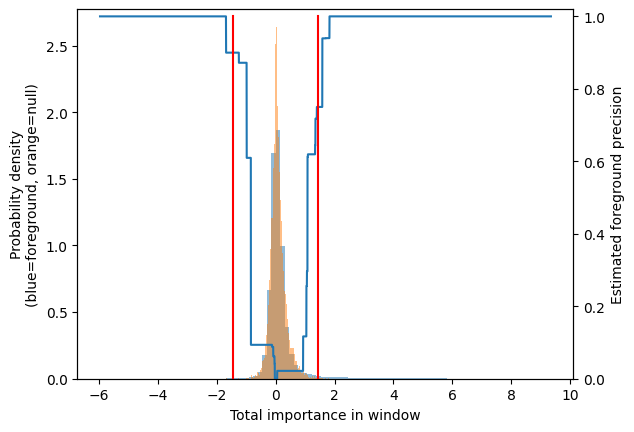

Only returning positive coords!
Got 38134 coords
Computing windowed sums on original
Only returning positive coords!
Got 38134 coords
Launching nearest neighbors affmat calculation job
MEMORY 4.165382144
Parallel runs completed
MEMORY 4.165971968
Job completed in: 62.96 s
MEMORY 4.165971968
Launching nearest neighbors affmat calculation job
MEMORY 4.165640192
Parallel runs completed
MEMORY 4.166033408
Job completed in: 51.42 s
MEMORY 4.165820416
On seqlets 0 to 5000 out of 38134


100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:07<00:00,  4.63it/s]

On seqlets 5000 to 10000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:08<00:00,  4.40it/s]

On seqlets 10000 to 15000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:08<00:00,  4.41it/s]

On seqlets 15000 to 20000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:07<00:00,  4.72it/s]

On seqlets 20000 to 25000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:08<00:00,  4.47it/s]

On seqlets 25000 to 30000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:08<00:00,  4.44it/s]

On seqlets 30000 to 35000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:07<00:00,  4.56it/s]

On seqlets 35000 to 38134 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 36/36 [00:06<00:00,  5.36it/s]


Launching nearest neighbors affmat calculation job
MEMORY 4.453040128
Parallel runs completed
MEMORY 4.453629952
Job completed in: 43.8 s
MEMORY 4.453629952
Launching nearest neighbors affmat calculation job
MEMORY 4.453634048
Parallel runs completed
MEMORY 4.454027264
Job completed in: 46.44 s
MEMORY 4.454027264
On seqlets 0 to 5000 out of 38134


100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:01<00:00, 13.23it/s]

On seqlets 5000 to 10000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:01<00:00, 13.06it/s]

On seqlets 10000 to 15000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:01<00:00, 13.27it/s]

On seqlets 15000 to 20000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:01<00:00, 12.93it/s]

On seqlets 20000 to 25000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:01<00:00, 12.96it/s]

On seqlets 25000 to 30000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:01<00:00, 13.04it/s]

On seqlets 30000 to 35000 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:01<00:00, 13.09it/s]

On seqlets 35000 to 38134 out of 38134



100%|████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 21.15it/s]


Removed 13399 duplicates
EXAMPLE IDX 0 hits:
Computing windowed sums on original
Only returning positive coords!
Got 2 coords
Original core seqlet locations


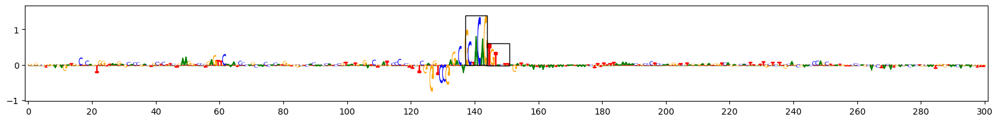

Motif matches (red = without trimming)


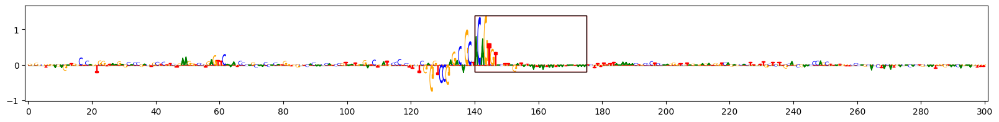

Matches to pattern 3 (the original pattern looks like this:)


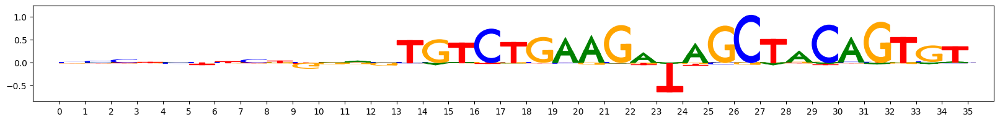

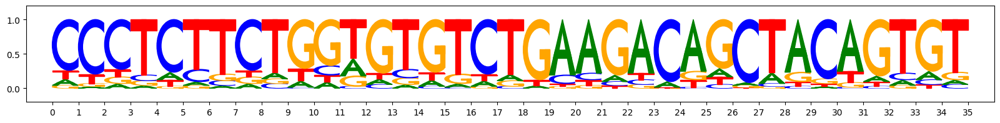

matches in this example...
MotifMatchWithImportance(patternidx=3, patternidx_rank=0, total_importance=4.709729, exampleidx=0, start=140, end=175, trim_start=140, trim_end=175, is_revcomp=True, seqlet_orig_start=130, seqlet_orig_end=165, seqlet_orig_revcomp=False, aggregate_sim=0.12783738521772764, mod_delta=0.00010849268842673076, mod_precision=0.16666666666666666, mod_percentile=0.013698630136986356, fann_perclasssum_perc=0.0, fann_perclassavg_perc=0.013698630136986356)


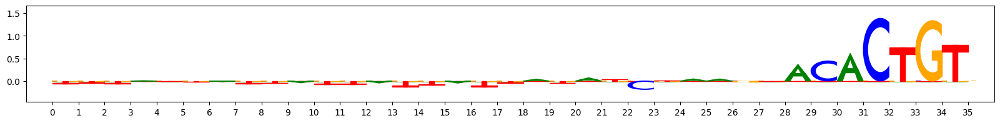

EXAMPLE IDX 1 hits:
Computing windowed sums on original
Only returning positive coords!
Got 2 coords
Original core seqlet locations


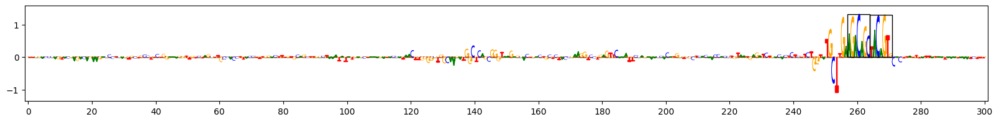

Motif matches (red = without trimming)


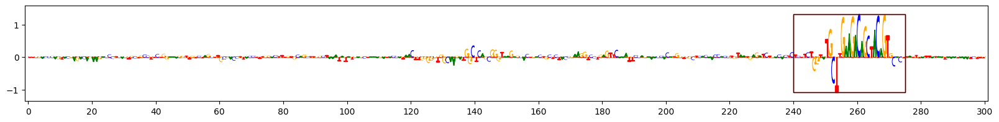

Matches to pattern 0 (the original pattern looks like this:)


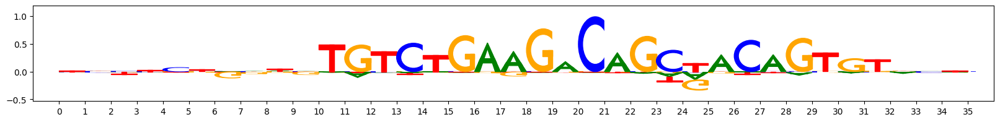

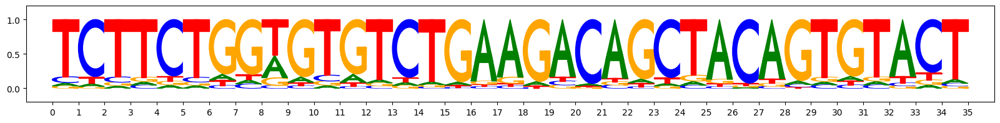

matches in this example...
MotifMatchWithImportance(patternidx=0, patternidx_rank=0, total_importance=11.372472, exampleidx=1, start=240, end=275, trim_start=240, trim_end=275, is_revcomp=False, seqlet_orig_start=250, seqlet_orig_end=285, seqlet_orig_revcomp=False, aggregate_sim=0.46912901750375713, mod_delta=0.00037198393349028723, mod_precision=0.9230769230769231, mod_percentile=0.5722379603399433, fann_perclasssum_perc=0.04249291784702547, fann_perclassavg_perc=0.1331444759206799)


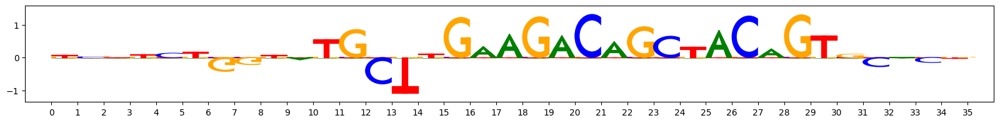

EXAMPLE IDX 2 hits:
Computing windowed sums on original
Only returning positive coords!
Got 3 coords
Original core seqlet locations


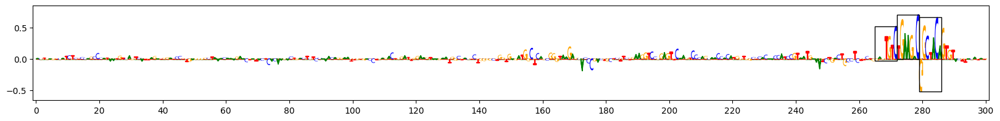

Motif matches (red = without trimming)


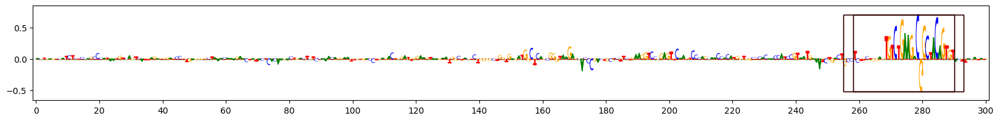

Matches to pattern 0 (the original pattern looks like this:)


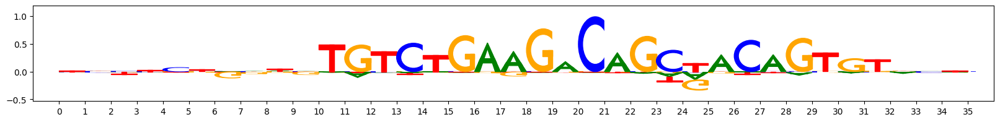

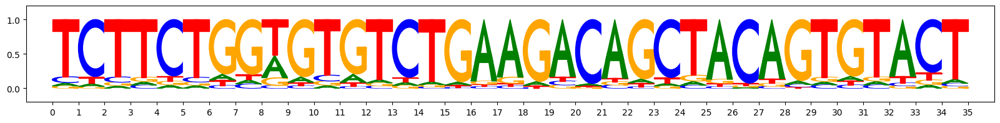

matches in this example...
MotifMatchWithImportance(patternidx=0, patternidx_rank=0, total_importance=6.697672, exampleidx=2, start=255, end=290, trim_start=255, trim_end=290, is_revcomp=True, seqlet_orig_start=251, seqlet_orig_end=286, seqlet_orig_revcomp=False, aggregate_sim=0.1363220506894967, mod_delta=0.0004013572465910172, mod_precision=0.9230769230769231, mod_percentile=0.8045325779036827, fann_perclasssum_perc=0.0, fann_perclassavg_perc=0.0)


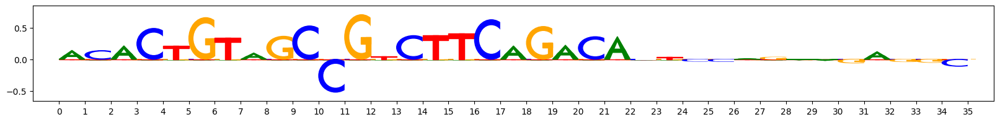

MotifMatchWithImportance(patternidx=0, patternidx_rank=0, total_importance=6.803493, exampleidx=2, start=258, end=293, trim_start=258, trim_end=293, is_revcomp=False, seqlet_orig_start=265, seqlet_orig_end=300, seqlet_orig_revcomp=False, aggregate_sim=0.5597464975329306, mod_delta=0.0003869451380028178, mod_precision=0.9230769230769231, mod_percentile=0.6883852691218131, fann_perclasssum_perc=0.12464589235127477, fann_perclassavg_perc=0.5070821529745042)


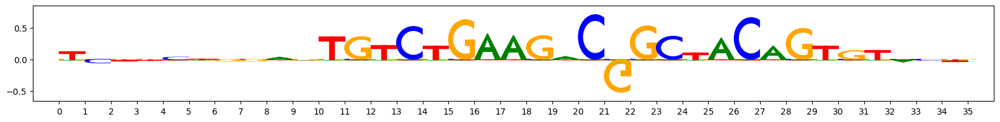

For metacluster_0
Path to node: root/0
Number of seqlets 353
Saved figure at nodepath root/0!


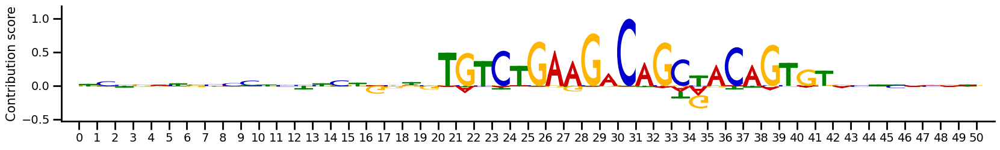

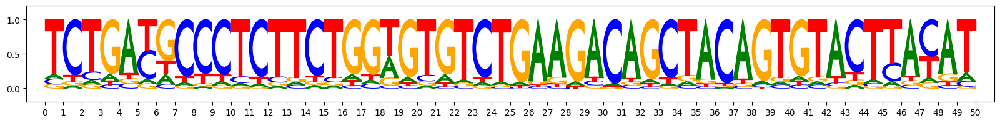

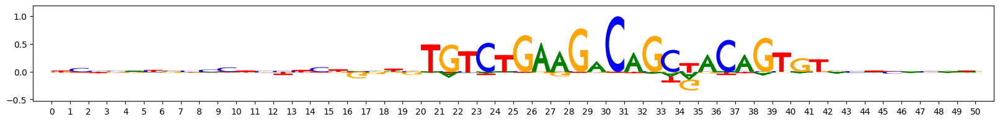

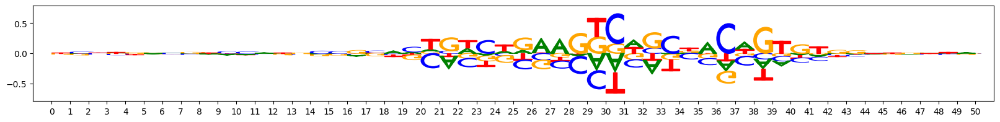

Path to node: root/0/0
Number of seqlets 347


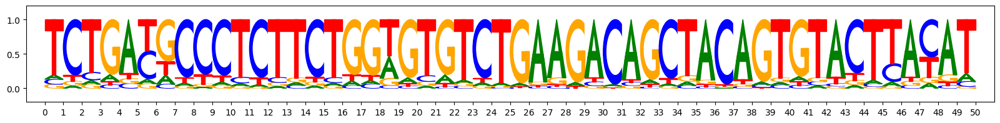

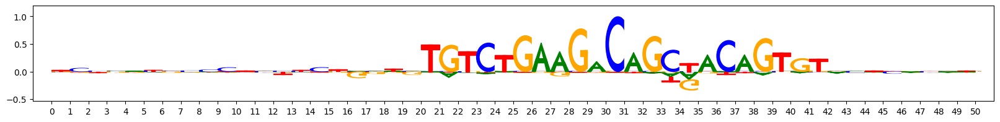

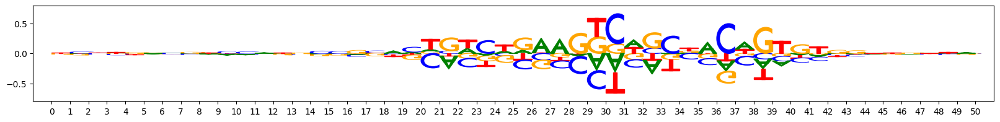

Path to node: root/0/1
Number of seqlets 6


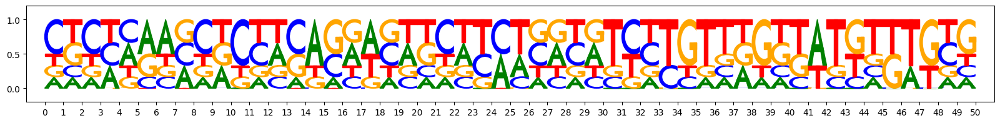

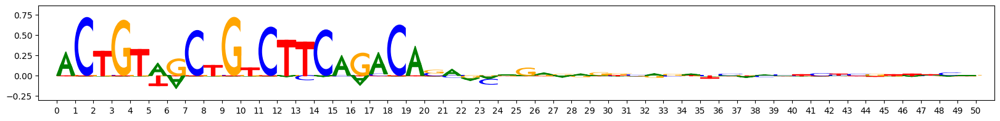

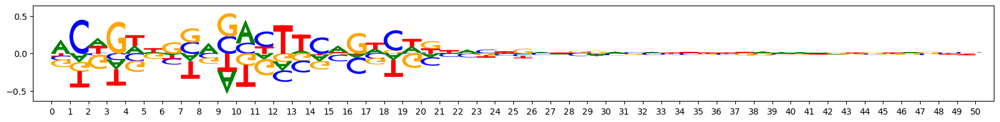

Path to node: root/1
Number of seqlets 240


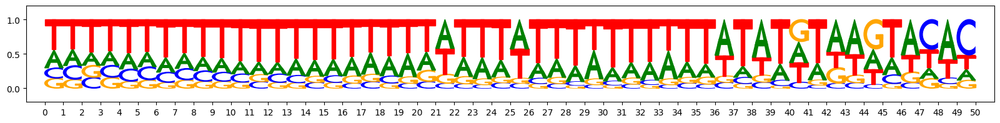

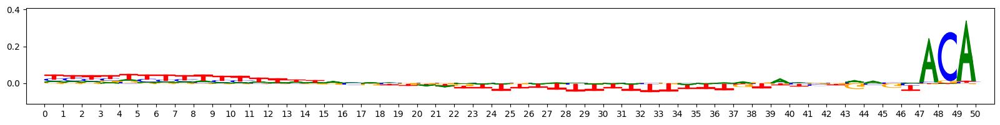

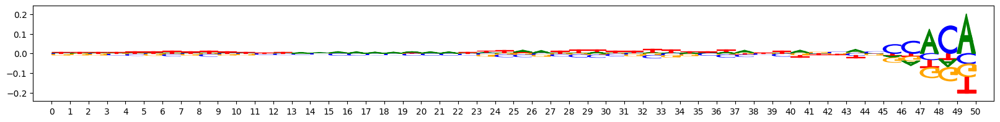

Path to node: root/2
Number of seqlets 75


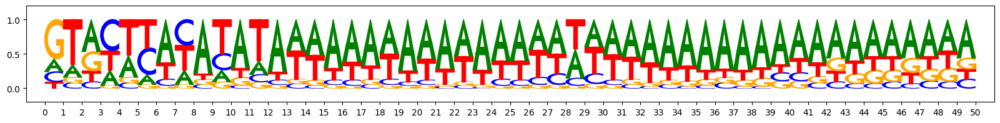

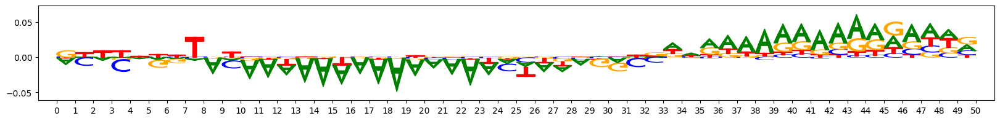

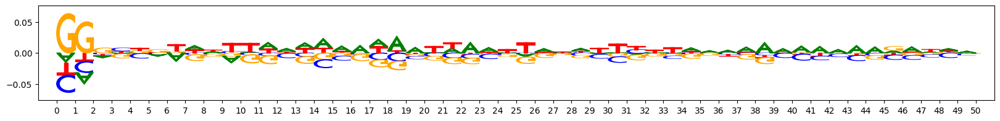

Path to node: root/3
Number of seqlets 73


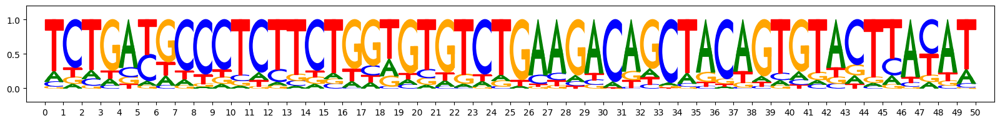

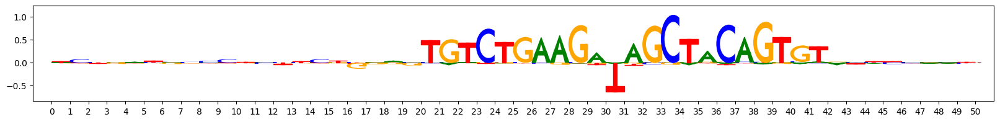

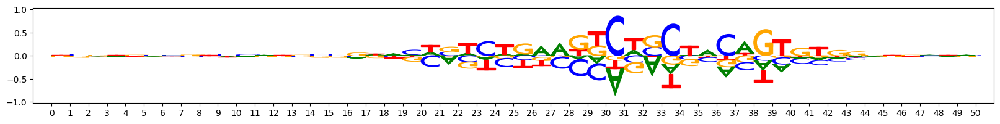

Path to node: root/4
Number of seqlets 62


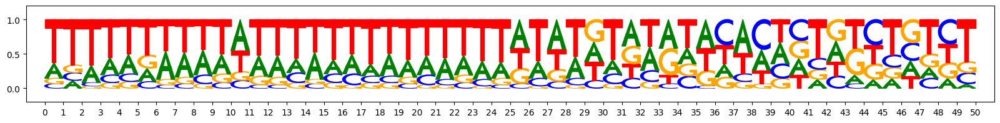

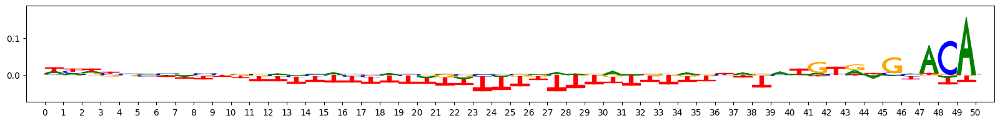

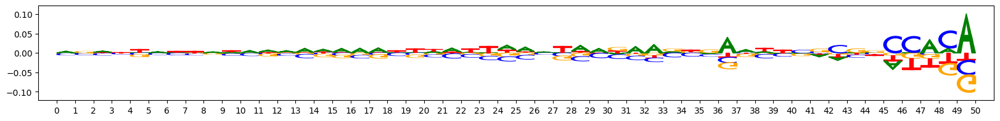

Path to node: root/5
Number of seqlets 57


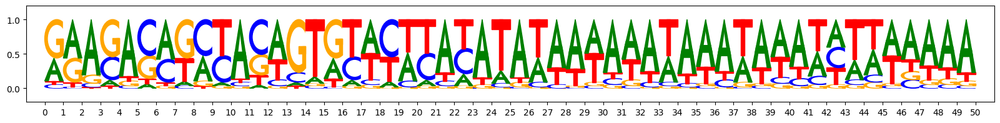

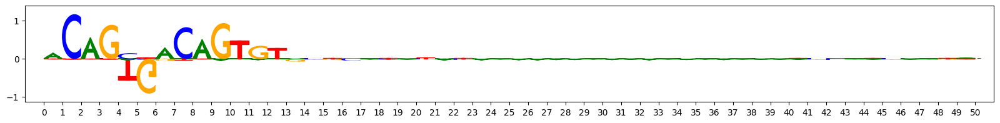

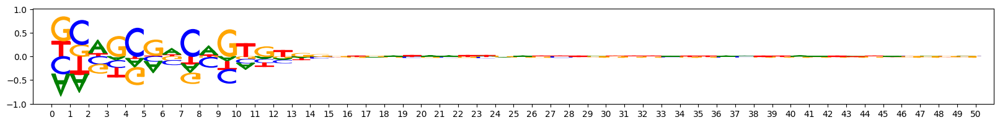

Path to node: root/6
Number of seqlets 49


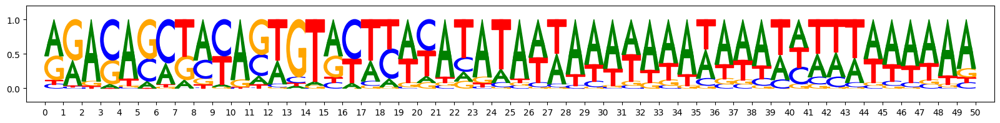

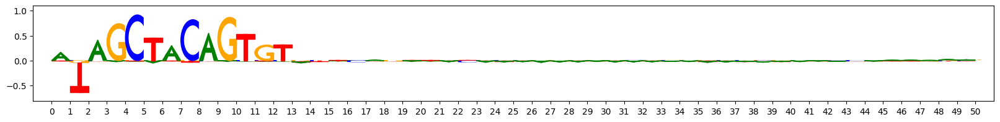

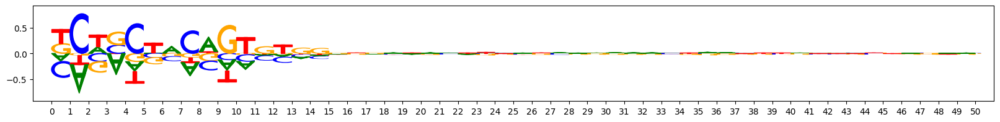

Path to node: root/7
Number of seqlets 45


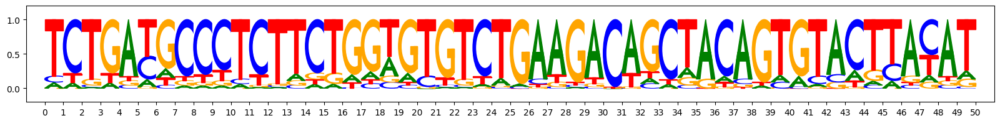

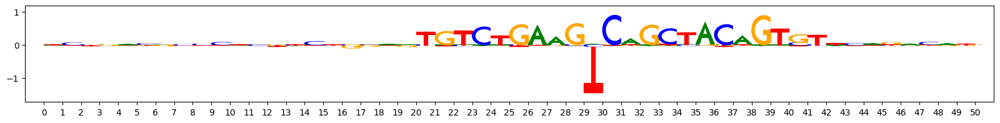

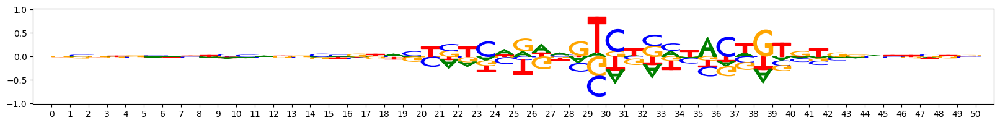

Path to node: root/8
Number of seqlets 41


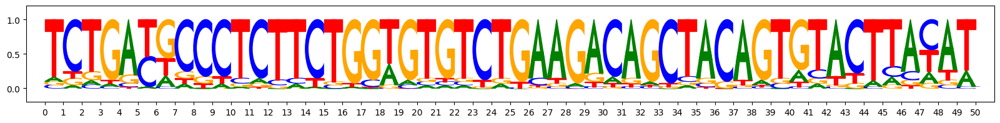

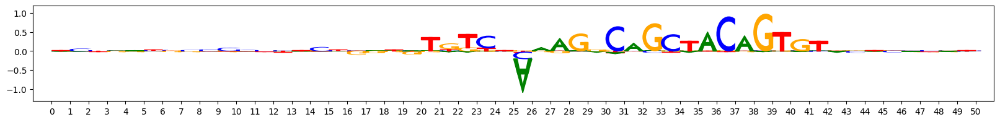

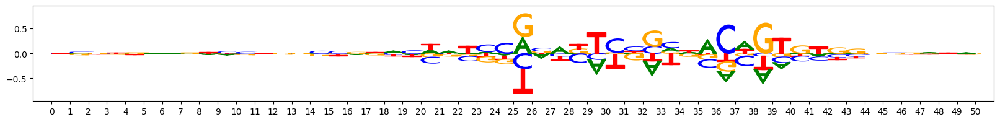

Path to node: root/9
Number of seqlets 39


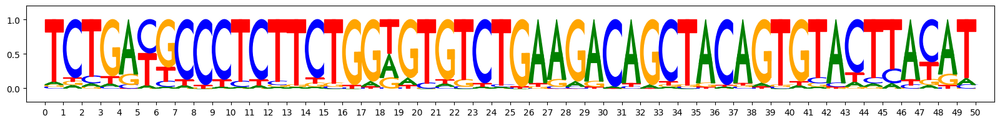

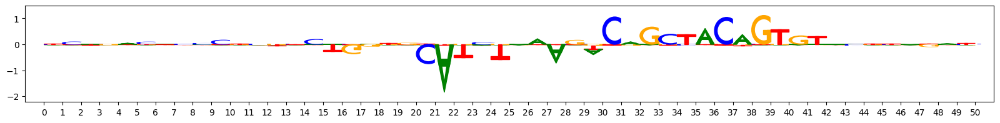

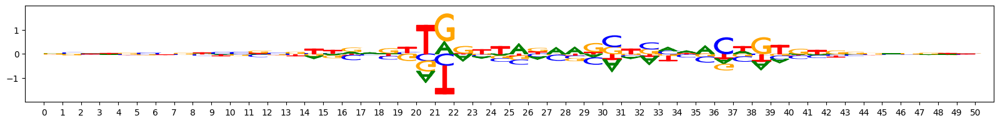

Path to node: root/10
Number of seqlets 38


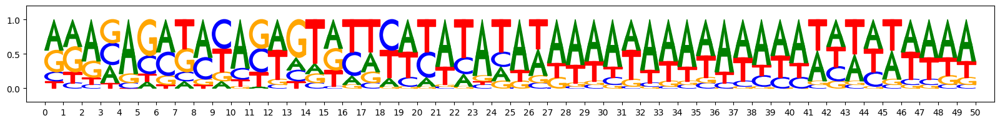

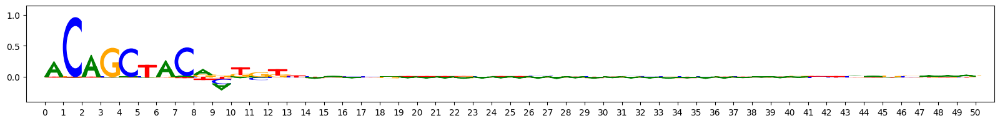

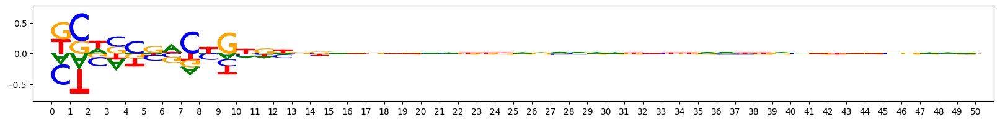

Path to node: root/11
Number of seqlets 34


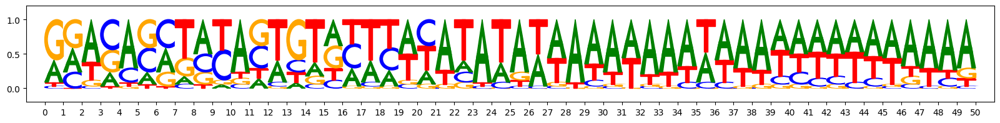

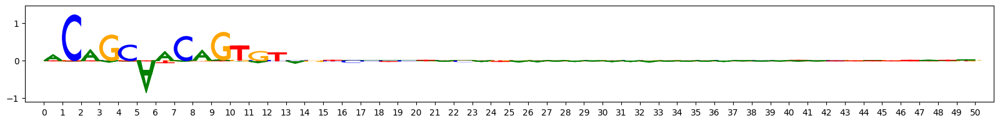

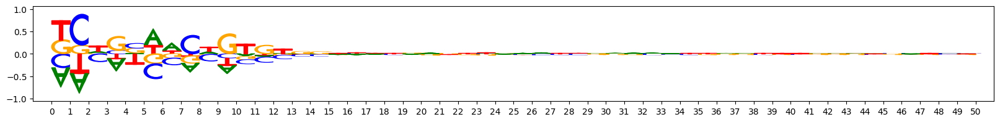

Path to node: root/12
Number of seqlets 33


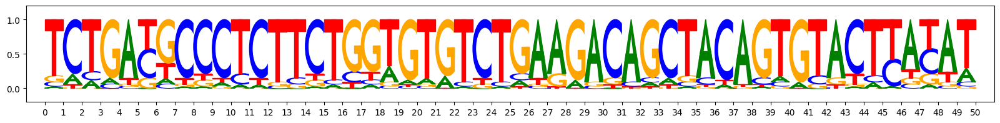

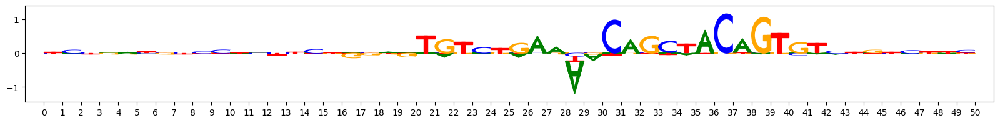

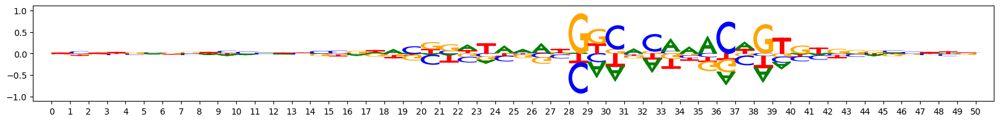

Path to node: root/13
Number of seqlets 32


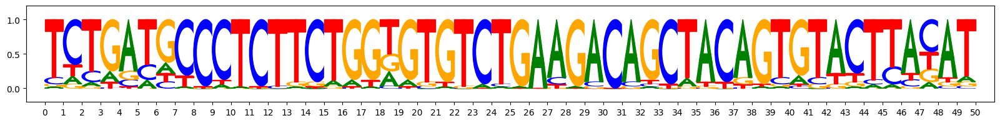

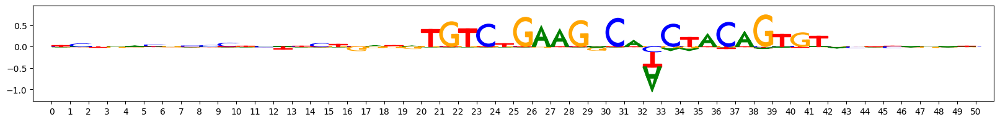

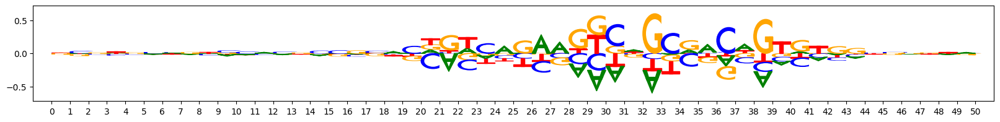

Path to node: root/14
Number of seqlets 25


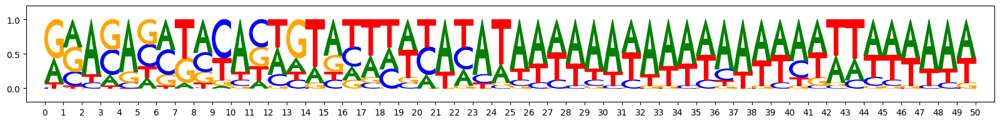

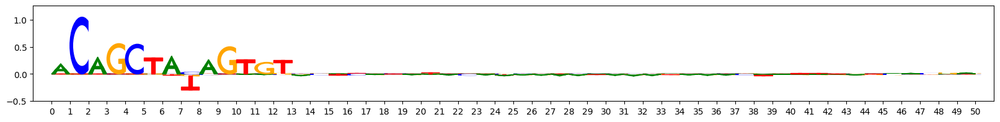

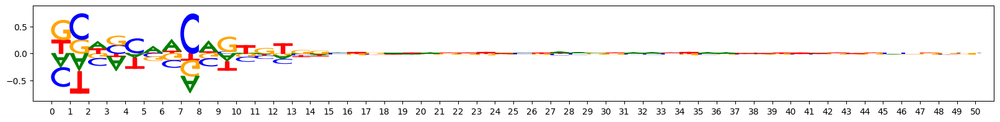

Path to node: root/15
Number of seqlets 21


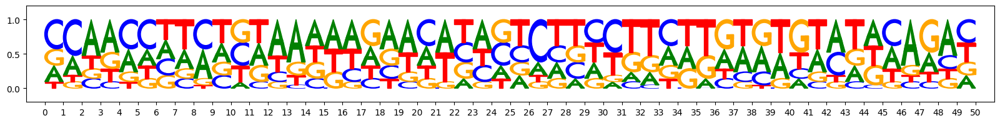

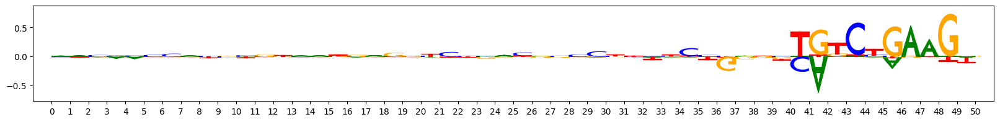

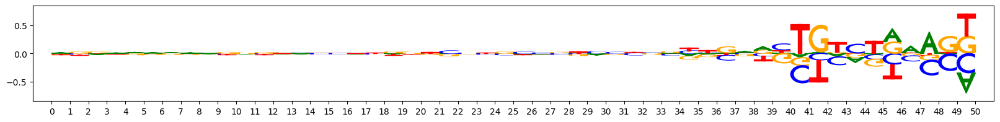

Path to node: root/16
Number of seqlets 14


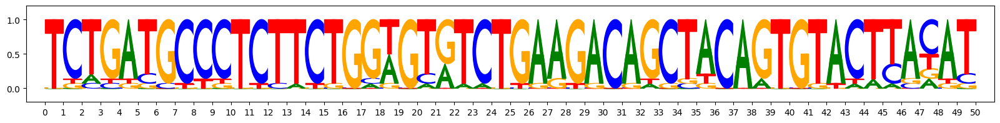

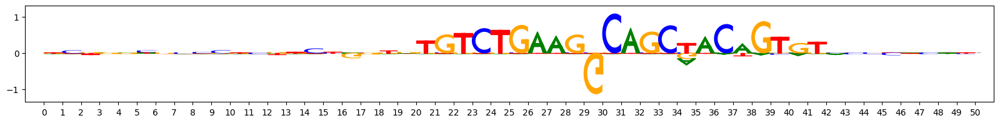

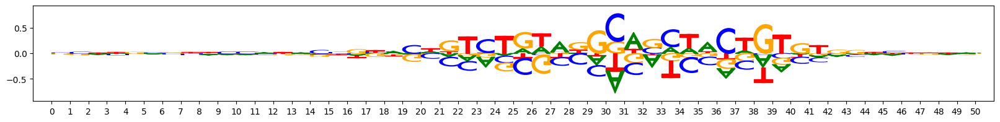

Path to node: root/17
Number of seqlets 14


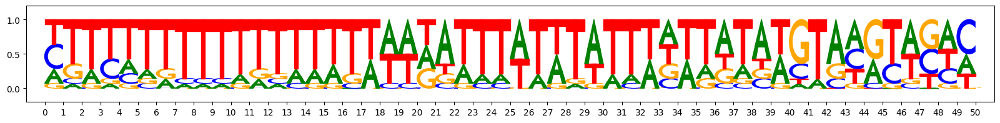

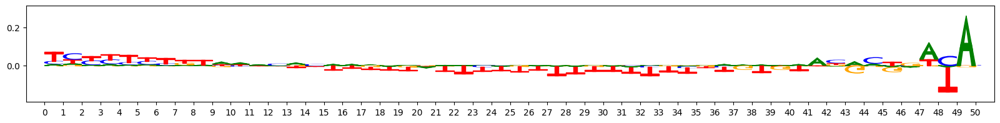

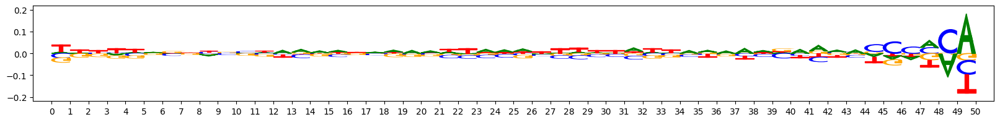

Path to node: root/18
Number of seqlets 13


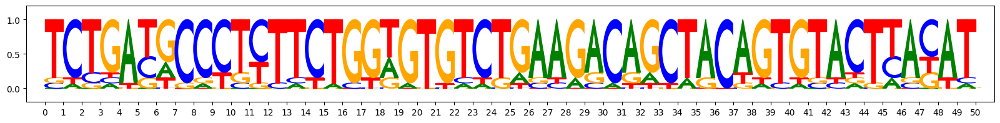

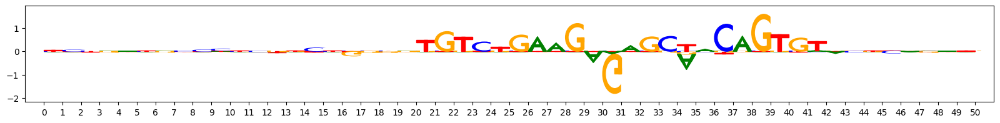

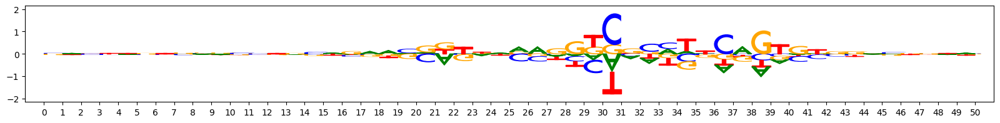

Path to node: root/19
Number of seqlets 7


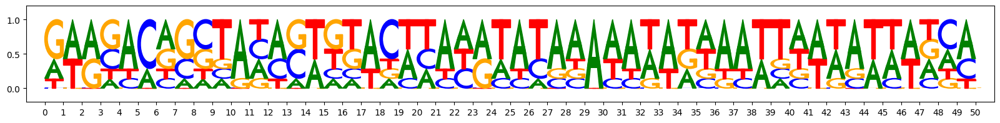

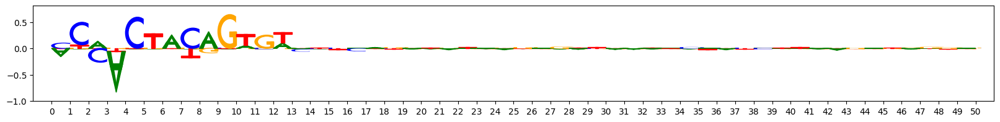

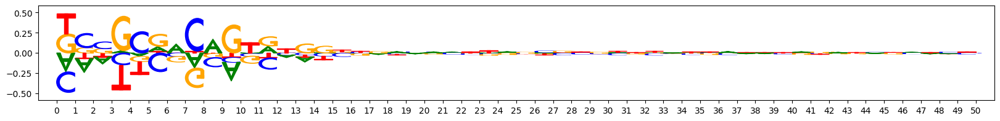

Path to node: root/20
Number of seqlets 2


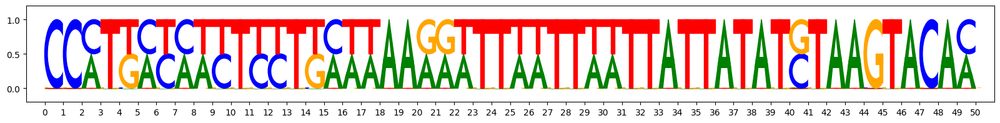

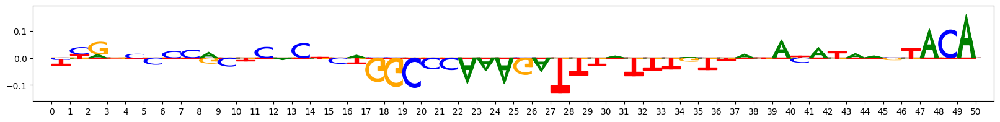

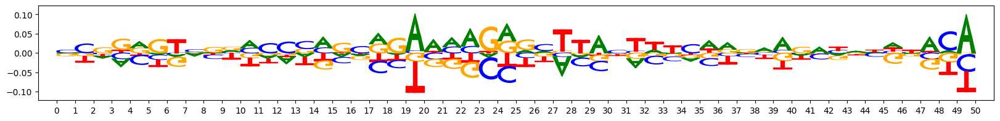

In [95]:
#Label=1
hit_scoring(input_data, metacluster="metacluster_0")